<font size=6>Segmenter la clientèle d'un site de e-commerce  
Partie 2 : La segmentation</font>

---

**Vérification de l'environnement**

In [ ]:
import sys
IN_COLAB = "google.colab" in sys.modules
# PATH_DRIVE : to change according to your Google Drive folders
PATH_DRIVE = "/content/drive/My Drive/MachineLearning/ML04"

In [ ]:
if IN_COLAB:
    print("Le notebook est exécuté sur Google Colab")
else:
    print("Le notebook est exécuté en local")

Le notebook est exécuté sur Google Colab


In [ ]:
if IN_COLAB:
    from google.colab import drive, files
    drive.mount("/content/drive")

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
# !nvidia-smi

In [ ]:
# Install RAPIDS
"""
!git clone https://github.com/rapidsai/rapidsai-csp-utils.git
!bash rapidsai-csp-utils/colab/rapids-colab.sh stable

import sys, os

dist_package_index = sys.path.index("/usr/local/lib/python3.6/dist-packages")
sys.path = sys.path[:dist_package_index]\
    + ["/usr/local/lib/python3.6/site-packages"]\
    + sys.path[dist_package_index:]
sys.path
exec(open("rapidsai-csp-utils/colab/update_modules.py").read(), globals())
"""

'\n!git clone https://github.com/rapidsai/rapidsai-csp-utils.git\n!bash rapidsai-csp-utils/colab/rapids-colab.sh stable\n\nimport sys, os\n\ndist_package_index = sys.path.index("/usr/local/lib/python3.6/dist-packages")\nsys.path = sys.path[:dist_package_index]    + ["/usr/local/lib/python3.6/site-packages"]    + sys.path[dist_package_index:]\nsys.path\nexec(open("rapidsai-csp-utils/colab/update_modules.py").read(), globals())\n'

---

<font size=5>**Sommaire**</font>

[1. Définition des classes et méthodes du notebook](#1_0)  
  
[2. Téléchargement et préparation des données](#2_0)  
  
[3. Clustering sur toutes les données](#3_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.1. Approche basée sur une réduction de dimension linéaire (ACP)](#3_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.2. Approche basée sur une réduction de dimension par ACP à noyau](#3_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.3. Approche basée sur une réduction de dimension par Isomap](#3_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.4. Approche basée sur une réduction de dimension par UMAP](#3_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.5. Approche basée sur une réduction de dimension par LLE](#3_5)  
  
[4. Clustering sur la satisfaction client](#4_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.1. Préparation des données](#4_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.2. Essai de clustering avec K-means](#4_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.3. Essai de clustering avec DBDScan](#4_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.4. Essai de clustering avec MeanShift](#4_4)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.5. Essai de clustering avec GMM](#4_5)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.6. Essai de clustering hiérarchique](#4_6)  
  
[5. Clustering sur le type de produits achetés](#5_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.1. Préparation des données](#5_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.2. Clustering avec K-means](#5_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.3. Clustering avec GMM](#5_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.4. Clustering hiérarchique](#5_4)  
  
[6. Clustering sur les caractéristiques des commandes](#6_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[6.1. Préparation des données](#6_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[6.2. Clustering avec K-means](#6_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[6.3. Clustering avec GMM](#6_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[6.4. Clustering hiérarchique](#6_4)  
  
[7. Evaluation de la stabilité à l'initialisation](#7_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[7.1. Segmentation sur la satisfaction client](#7_1)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[7.2. Segmentation sur le type de produits](#7_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[7.3. Segmentation sur les caractéristiques des commandes](#7_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[7.4. Comparaison des résultats sur les différentes segmentations](#7_4)  
  
[8. Evaluation de la stabilité dans le temps](#8_0)

---
## <font color=blue>Set-up du notebook</font>

**Importation des librairies**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import umap
import re
import datetime
if IN_COLAB:
    import os
else:
    import requests

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.cluster import KMeans, DBSCAN, MeanShift, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.manifold import Isomap, LocallyLinearEmbedding
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics.cluster import adjusted_rand_score
from timeit import default_timer as timer
from dateutil.relativedelta import relativedelta

In [ ]:
if IN_COLAB:
    !pip install opentsne

     |████████████████████████████████| 1.8MB 43kB/s 


In [ ]:
from openTSNE import TSNE
from openTSNE.callbacks import ErrorLogger

In [ ]:
if IN_COLAB:
    sys.path.append(PATH_DRIVE)
    import sf_graphiques as sfg
    import sf_reduction_dimension as sfrd
    import sf_classification as sfc
else:
    import modules_perso.sf_graphiques as sfg
    import modules_perso.sf_reduction_dimension as sfrd
    import modules_perso.sf_classification as sfc

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


**Setup du notebook**

In [ ]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [ ]:
if IN_COLAB:
    os.chdir(PATH_DRIVE)

In [ ]:
def save_fig(fig_id, tight_layout=False, fig_extension="png", resolution=300):
    path = fig_id + "." + fig_extension
    if IN_COLAB:
        path = PATH_DRIVE + "/" + path
    # print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, dpi=resolution)

---
<a id='1_0'></a>

## <font color=blue>1. Définition des classes et méthodes du notebook</font>

In [ ]:
grouped_categories = pd.DataFrame({
    "product_category_name_english": [
        "perfumery", "health_beauty", "diapers_and_hygiene",
        "home_appliances", "home_appliances_2",
        "housewares", "small_appliances",
        "small_appliances_home_oven_and_coffee", "portable_cooking_device",
        "home_confort", "home_comfort_2", "air_conditioning",
        "construction_tools_safety", "home_construction",
        "construction_tools_construction", "construction_tools_lights",
        "costruction_tools_tools", "costruction_tools_garden", "garden_tools",
        "office_furniture", "stationery",
        "telephony", "fixed_telephony",
        "signaling_and_security", "security_and_services",
        "books_general_interest", "books_technical", "books_imported",
        "kitchen_dining_laundry_garden_furniture", "la_cuisine",
        "industry_commerce_and_business", "agro_industry_and_commerce",
        "luggage_accessories", "fashion_bags_accessories",
        "tablets_printing_image", "computers_accessories", "computers",
        "pc_gamer", "consoles_games",
        "electronics", "cine_photo", "audio",
        "cds_dvds_musicals", "dvds_blu_ray", "music",
        "christmas_supplies", "party_supplies",
        "arts_and_craftmanship", "art",
        "bed_bath_table", "furniture_living_room", "furniture_bedroom",
        "furniture_mattress_and_upholstery",
        "food", "food_drink", "drinks",
        "fashion_male_clothing", "fashio_female_clothing", "fashion_shoes",
        "fashion_sport", "fashion_childrens_clothes",
        "fashion_underwear_beach",
        "furniture_decor", "musical_instruments", "cool_stuff",
        "toys", "auto", "flowers", "watches_gifts", "pet_shop",
        "sports_leisure", "market_place", "baby"],
    "product_category_global": [
        "hygiene_and_beauty", "hygiene_and_beauty", "hygiene_and_beauty",
        "home_appliances", "home_appliances",
        "small_appliances", "small_appliances", "small_appliances",
        "small_appliances",
        "home_comfort", "home_comfort", "home_comfort",
        "construction_tools", "construction_tools", "construction_tools",
        "construction_tools", "construction_tools",
        "garden_tools", "garden_tools",
        "office_furniture", "office_furniture",
        "telephony", "telephony",
        "security", "security",
        "books", "books", "books",
        "kitchen", "kitchen",
        "industry_and_commerce", "industry_and_commerce",
        "luggage", "luggage",
        "computers", "computers", "computers", "computers", "computers",
        "electronics", "electronics", "electronics",
        "music_and_videos", "music_and_videos", "music_and_videos",
        "party_supplies", "party_supplies",
        "arts", "arts",
        "furnitures", "furnitures", "furnitures", "furnitures",
        "food_and_drinks", "food_and_drinks", "food_and_drinks",
        "fashion", "fashion", "fashion", "fashion", "fashion", "fashion",
        "furniture_decor", "musical_instruments", "cool_stuff",
        "toys", "auto", "flowers", "watches_gifts", "pet_shop",
        "sports_leisure", "market_place", "baby"]})

In [ ]:
class PrepareData(BaseEstimator):

    def __init__(self, categ_imputer=None, num_imputer=None):
        if categ_imputer is None:
            categ_imputer = SimpleImputer(strategy="most_frequent")
        if num_imputer is None:
            num_imputer = SimpleImputer(strategy="median")
        self.categ_imputer = categ_imputer
        self.num_imputer = num_imputer
        self.customers = None
        self.sellers = None
        self.geolocation = None
        self.orders = None
        self.order_items = None
        self.order_payments = None
        self.order_reviews = None
        self.products = None
        self.product_category = None
        self.grouped_categories = None
        self.data_customers = None
        self.features = None

    def fit(self, customers, sellers, geolocation,
            orders, order_items, order_payments, order_reviews,
            products, product_category, grouped_categories,
            number_of_months=None):
        self.customers = customers
        self.sellers = sellers
        self.geolocation = geolocation
        self.orders = orders
        self.order_items = order_items
        self.order_payments = order_payments
        self.order_reviews = order_reviews
        self.products = products
        self.product_category = product_category
        self.grouped_categories = grouped_categories
        self.__prepare_core_data(number_of_months)
        self.__prepare_customers_data()
        self.features = self.data_customers.columns
        return self

    def transform(self):
        return self.data_customers

    def fit_transform(self, customers, sellers, geolocation,
                      orders, order_items, order_payments, order_reviews,
                      products, product_category, grouped_categories,
                      number_of_months=None):
        self.fit(customers, sellers, geolocation,
                 orders, order_items, order_payments, order_reviews,
                 products, product_category, grouped_categories,
                 number_of_months)
        return self.data_customers

    def get_feature_names(self):
        return self.features

    def get_clusters(self, features_list, clustering_algo):
        X = self.data_customers[features_list]
        clusters = clustering_algo.fit_predict(X)
        return pd.DataFrame({"cluster": clusters},
                            index=self.data_customers.index)

    def __add_geolocation_id(self):
        self.geolocation["geolocation_id"] = \
            self.geolocation.geolocation_zip_code_prefix.astype(str)\
            + " " + self.geolocation.geolocation_state
        self.customers["geolocation_id"] = \
            self.customers.customer_zip_code_prefix.astype(str)\
            + " " + self.customers.customer_state
        self.sellers["geolocation_id"] = \
            self.sellers.seller_zip_code_prefix.astype(str)\
            + " " + self.sellers.seller_state

    def __prepare_geolocation(self):
        self.geolocation = \
            pd.DataFrame(self.geolocation[["geolocation_id",
                                           "geolocation_lat",
                                           "geolocation_lng"]]
                         .groupby("geolocation_id").mean()).reset_index()
        index_to_remove = \
            self.geolocation[(self.geolocation.geolocation_lat >= 6)
                             | (self.geolocation.geolocation_lng >= -33)].index
        self.geolocation.drop(index_to_remove, inplace=True)

    def __prepare_customers(self):
        self.customers = self.customers.merge(self.geolocation,
                                              how="left",
                                              on="geolocation_id")
        col_names = list(self.customers.columns)
        for i in [-1, -2]:
            col_names[i] = "customer_" + col_names[i]
        self.customers.columns = col_names
        self.customers.drop(columns=["customer_zip_code_prefix",
                                     "customer_city",
                                     "customer_state",
                                     "geolocation_id"],
                            inplace=True)

    def __prepare_sellers(self):
        self.sellers = self.sellers.merge(self.geolocation,
                                          how="left",
                                          on="geolocation_id")
        col_names = list(self.sellers.columns)
        for i in [-1, -2]:
            col_names[i] = "seller_" + col_names[i]
        self.sellers.columns = col_names
        self.sellers.drop(columns=["seller_zip_code_prefix",
                                   "seller_city",
                                   "seller_state",
                                   "geolocation_id"],
                          inplace=True)

    def __prepare_products(self):
        newlines = pd.DataFrame(
            {"product_category_name":
                ["portateis_cozinha_e_preparadores_de_alimentos", "pc_gamer"],
             "product_category_name_english":
                ["portable_cooking_device", "pc_gamer"]})
        self.product_category = \
            self.product_category.append(newlines, ignore_index=True)
        self.products = self.products.merge(self.product_category,
                                            how="left",
                                            on="product_category_name")
        self.products["product_volume_cm3"] = self.products.product_length_cm\
            * self.products.product_height_cm * self.products.product_width_cm
        self.products = self.products.merge(self.grouped_categories,
                                            how="left",
                                            on="product_category_name_english")
        self.products.drop(columns=["product_category_name",
                                    "product_category_name_english",
                                    "product_length_cm",
                                    "product_height_cm",
                                    "product_width_cm"],
                           inplace=True)

    def __orders_remove_wrong_dates(self):
        list_date_cols = ["order_purchase_timestamp",
                          "order_approved_at",
                          "order_delivered_carrier_date",
                          "order_delivered_customer_date",
                          "order_estimated_delivery_date"]
        for col in np.arange(1, len(list_date_cols)):
            if col < len(list_date_cols) - 1:
                errors = self.orders[list_date_cols[col]]\
                    < self.orders[list_date_cols[col-1]]
            else:
                errors = self.orders[list_date_cols[col]]\
                    < self.orders[list_date_cols[0]]
            index_to_remove = self.orders[errors].index
            self.orders.drop(index_to_remove, inplace=True)

    def __prepare_orders(self):
        self.orders = \
            self.orders[self.orders.order_status == "delivered"].copy()
        self.__orders_remove_wrong_dates()
        self.orders["order_purchase_year_month"] = pd.to_datetime(
            self.orders.order_purchase_timestamp).dt.strftime("%Y%m")
        self.orders["order_purchase_day_of_month"] = pd.to_datetime(
            self.orders.order_purchase_timestamp).dt.strftime("%d")
        self.orders["order_purchase_day_of_week"] = pd.to_datetime(
            self.orders.order_purchase_timestamp).dt.strftime("%A")
        self.orders["order_purchase_hour"] = pd.to_datetime(
            self.orders.order_purchase_timestamp).dt.strftime("%H")
        self.orders["approbation_time"] = (pd.to_datetime(
            self.orders.order_approved_at) - pd.to_datetime(
            self.orders.order_purchase_timestamp)).dt.total_seconds()\
            / 86400.0
        self.orders["shipping_time"] = (pd.to_datetime(
            self.orders.order_delivered_carrier_date) - pd.to_datetime(
            self.orders.order_approved_at)).dt.total_seconds() / 86400.0
        self.orders["delivery_days"] = (pd.to_datetime(
            self.orders.order_delivered_customer_date).dt.date
            - pd.to_datetime(
            self.orders.order_delivered_carrier_date).dt.date).dt.days
        self.orders["delivery_lag"] = (pd.to_datetime(
            self.orders.order_delivered_customer_date).dt.date
            - pd.to_datetime(
            self.orders.order_estimated_delivery_date).dt.date).dt.days
        self.orders.drop(columns=["order_approved_at",
                                  "order_delivered_carrier_date",
                                  "order_delivered_customer_date",
                                  "order_estimated_delivery_date"],
                         inplace=True)

    def __prepare_order_reviews(self):
        interdf = self.order_reviews.copy()
        interdf["comment_title_length"] = \
            interdf["review_comment_title"].str.len()
        interdf["comment_message_length"] = \
            interdf["review_comment_message"].str.len()
        interdf["review_response_days"] = \
            (pd.to_datetime(interdf.review_answer_timestamp)
             - pd.to_datetime(interdf.review_creation_date)).dt.days
        self.order_reviews = interdf.groupby("order_id").mean().reset_index()
        self.order_reviews.fillna(0, inplace=True)

    def __prepare_order_payments(self):
        index_to_remove = \
            self.order_payments[self.order_payments.payment_installments == 0]\
            .index
        interdf = self.order_payments.drop(index_to_remove)
        self.order_payments = \
            interdf.groupby("order_id")[["payment_sequential"]].nunique()
        self.order_payments["payment_types"] = \
            [pt[0] if len(pt) == 1 else "multiple"
             for pt in interdf.groupby("order_id")["payment_type"].unique()]
        self.order_payments["payment_types_number"] = \
            [len(pt)
             for pt in interdf.groupby("order_id")["payment_type"].unique()]
        self.order_payments["payment_installments"] = \
            interdf.groupby("order_id")["payment_installments"].max()
        self.order_payments["payment_value"] = \
            interdf.groupby("order_id")["payment_value"].sum()
        self.order_payments.reset_index(inplace=True)

    def __calcul_distance_customer_seller(self):
        R = 6371.0  # rayon de la terre
        inter_radians = \
            np.radians(self.order_items[["customer_geolocation_lat",
                                         "customer_geolocation_lng",
                                         "seller_geolocation_lat",
                                         "seller_geolocation_lng"]].values)
        distance_lat = inter_radians[:, 0] - inter_radians[:, 2]
        distance_lng = inter_radians[:, 1] - inter_radians[:, 3]
        inter_distance = np.power(np.sin(distance_lat / 2), 2) \
            + np.cos(inter_radians[:, 0]) \
            * np.cos(inter_radians[:, 2]) \
            * np.power(np.sin(distance_lng / 2), 2)
        self.order_items["distance_customer_seller"] = R * 2 \
            * np.arctan2(np.sqrt(inter_distance), np.sqrt(1 - inter_distance))
        self.order_items.drop(columns=["customer_id",
                                       "customer_geolocation_lat",
                                       "customer_geolocation_lng",
                                       "seller_geolocation_lat",
                                       "seller_geolocation_lng"],
                              inplace=True)

    def __calcul_maximum_shipping_days(self):
        self.order_items["maximum_shipping_days"] = (pd.to_datetime(
            self.order_items.shipping_limit_date) - pd.to_datetime(
            self.order_items.order_purchase_timestamp)).dt.total_seconds()\
            / 86400.0
        self.order_items.drop(columns=["shipping_limit_date"], inplace=True)

    def __impute_data_items(self):
        num_cols = ["product_name_lenght", "product_description_lenght",
                    "product_photos_qty", "product_weight_g",
                    "product_volume_cm3", "distance_customer_seller"]
        self.order_items.loc[:, num_cols] = self.num_imputer\
            .fit_transform(self.order_items[num_cols].values)
        categ_cols = ["product_category_global"]
        self.order_items.loc[:, categ_cols] = self.categ_imputer\
            .fit_transform(self.order_items[categ_cols].values)

    def __select_order_items_dates(self, number_of_months):
        dateref = pd.to_datetime(self.order_items.order_purchase_timestamp)\
            .min()
        datemax = dateref + relativedelta(months=+number_of_months)
        selection = pd.to_datetime(self.order_items.order_purchase_timestamp) \
            <= datemax
        self.order_items = self.order_items[selection].copy()

    def __prepare_order_items(self, number_of_months):
        self.order_items["items_percent_freight_price"] = \
            self.order_items.freight_value \
            / (self.order_items.price + self.order_items.freight_value)
        self.order_items["items_total_price"] = \
            self.order_items.order_item_id \
            * (self.order_items.price + self.order_items.freight_value)
        delivered_order_id = \
            self.orders[orders.order_status == "delivered"].order_id
        self.order_items = \
            self.order_items[self.order_items.order_id
                             .isin(delivered_order_id)].copy()
        self.order_items = self.order_items\
            .merge(self.orders[["order_id",
                                "customer_id",
                                "order_purchase_timestamp"]],
                   how="left",
                   on="order_id")
        self.order_items = self.order_items\
            .merge(self.customers, how="left", on="customer_id")
        self.order_items = self.order_items\
            .merge(self.sellers, how="left", on="seller_id")
        self.order_items = self.order_items\
            .merge(self.products, how="left", on="product_id")
        if number_of_months is not None:
            self.__select_order_items_dates(number_of_months)
        self.__calcul_distance_customer_seller()
        self.__calcul_maximum_shipping_days()
        self.__impute_data_items()

    def __prepare_core_data(self, number_of_months):
        self.__add_geolocation_id()
        self.__prepare_geolocation()
        self.__prepare_customers()
        self.__prepare_sellers()
        self.__prepare_products()
        self.__prepare_orders()
        self.__prepare_order_reviews()
        self.__prepare_order_payments()
        self.__prepare_order_items(number_of_months)

    def __get_data_from_orders(self):
        # calcul des informations sur les commandes à partir de order_items
        # nombre d'articles et prix total du panier
        df = self.order_items[["order_id",
                               "order_item_id",
                               "items_total_price"]].groupby("order_id").sum()

        # nombre de produits et de vendeurs dans le panier
        interdata = self.order_items[["order_id", "product_id", "seller_id"]]\
            .groupby("order_id").count()
        df = df.merge(interdata, how="left", left_index=True, right_index=True)

        # pourcentage des frais de port dans le prix total du panier
        interdata = self.order_items[["order_id",
                                      "order_item_id",
                                      "freight_value",
                                      "items_total_price"]].copy()
        interdata["total_freight_value"] = \
            interdata.order_item_id * interdata.freight_value
        interdata = interdata[["order_id",
                               "total_freight_value",
                               "items_total_price"]].groupby("order_id").sum()
        interdata["percent_freight_price"] = \
            interdata.total_freight_value / interdata.items_total_price
        df = df.merge(interdata.percent_freight_price,
                      how="left", left_index=True, right_index=True)

        # prix unitaire moyen et pourcentage moyen des frais de port
        interdata = self.order_items[["order_id",
                                      "price",
                                      "items_percent_freight_price"]]\
            .groupby("order_id").mean()
        df = df.merge(interdata, how="left", left_index=True, right_index=True)

        # dépense moyenne par produit et par vendeur
        interdata = self.order_items[["order_id", "items_total_price"]]\
            .groupby("order_id").mean()
        df = df.merge(interdata, how="left", left_index=True, right_index=True)
        interdata = self.order_items[["order_id",
                                      "seller_id",
                                      "items_total_price"]]\
            .groupby(["order_id", "seller_id"]).sum().reset_index()
        interdata = interdata.groupby("order_id").mean()
        df = df.merge(interdata, how="left", left_index=True, right_index=True)

        # longueur moyenne des noms et descriptions des produits,
        # nombre moyen de photos, poids moyen et volume moyen,
        # distance acheteur/vendeur moyenne
        interdata = self.order_items[["order_id",
                                      "product_name_lenght",
                                      "product_description_lenght",
                                      "product_photos_qty",
                                      "product_weight_g",
                                      "product_volume_cm3",
                                      "distance_customer_seller",
                                      "maximum_shipping_days"]]\
            .groupby("order_id").mean()
        df = df.merge(interdata, how="left", left_index=True, right_index=True)

        # catégorie des produits achetés, ou multiple s'il y en a plusieurs
        interdata = self.order_items[["order_id", "product_category_global"]]\
            .groupby("order_id").product_category_global.unique()
        df["products_category"] = \
            [i[0] if len(i) == 1 else "multiple" for i in interdata]
        df["products_category_number"] = [len(i) for i in interdata]
        df.columns = ["items_number", "order_total_price",
                      "products_number", "sellers_number",
                      "percent_freight_price",
                      "average_item_price", "average_item_percent_freight",
                      "average_product_expense", "average_seller_expense",
                      "average_name_lenght", "average_description_lenght",
                      "average_photos_qty", "average_weight_g",
                      "average_volume_cm3", "average_distance_customer_seller",
                      "average_maximum_shipping_days",
                      "products_category", "products_category_number"]

        # ajout des informations sur les ordres, les clients,
        # les paiements et les reviews
        df.reset_index(inplace=True)
        df = df.merge(self.orders.drop(columns="order_status"),
                      how="left",
                      on="order_id")
        df = df.merge(self.customers[["customer_id", "customer_unique_id"]],
                      how="left",
                      on="customer_id")
        df = df.merge(self.order_payments, how="left", on="order_id")
        df = df.merge(self.order_reviews, how="left", on="order_id")
        df.drop(columns="customer_id", inplace=True)

        # imputation des valeurs manquantes
        num_cols = ["approbation_time", "shipping_time", "delivery_days",
                    "delivery_lag", "payment_sequential",
                    "payment_types_number", "payment_installments",
                    "payment_value"]
        df.loc[:, num_cols] = \
            self.num_imputer.fit_transform(df[num_cols].values)
        categ_cols = ["payment_types"]
        df.loc[:, categ_cols] = \
            self.categ_imputer.fit_transform(df[categ_cols].values)
        return df

    # création du dataframe par client en agrégeant sur le customer_unique_id
    def __create_data_customers(self):
        data_orders = self.__get_data_from_orders()
        # calcul du nombre de commandes
        self.data_customers = data_orders[["customer_unique_id", "order_id"]]\
            .groupby("customer_unique_id").count()

        # calcul du nombre de mois différents de commande sur la dernière année
        max_date = \
            pd.to_datetime(data_orders.order_purchase_timestamp).dt.date.max()
        min_date = \
            pd.Timestamp(datetime.date(max_date.year - 1, max_date.month, 1))
        interdata = \
            data_orders[pd.to_datetime(data_orders.order_purchase_timestamp)
                        >= min_date][["customer_unique_id",
                                      "order_purchase_year_month"]]\
            .groupby("customer_unique_id").order_purchase_year_month.nunique()
        self.data_customers = self.data_customers.merge(interdata,
                                                        how="left",
                                                        left_index=True,
                                                        right_index=True)

        # calcul des moyennes par client
        interdata = \
            data_orders[["customer_unique_id", "items_number",
                         "order_total_price", "products_number",
                         "sellers_number", "percent_freight_price",
                         "average_item_price", "average_product_expense",
                         "average_seller_expense", "average_name_lenght",
                         "average_description_lenght", "average_photos_qty",
                         "average_weight_g", "average_volume_cm3",
                         "average_distance_customer_seller",
                         "average_maximum_shipping_days",
                         "products_category_number", "approbation_time",
                         "shipping_time", "delivery_days", "delivery_lag",
                         "payment_sequential", "payment_types_number",
                         "payment_installments", "payment_value",
                         "review_score", "comment_title_length",
                         "comment_message_length", "review_response_days"]]\
            .groupby("customer_unique_id").mean()
        self.data_customers = self.data_customers.merge(interdata,
                                                        how="left",
                                                        left_index=True,
                                                        right_index=True)
        self.data_customers.columns = \
            ["orders_number", "last_year_orders_frequency",
             "average_items_number", "average_total_price",
             "average_products_number", "average_sellers_number",
             "average_order_percent_freight", "average_item_price",
             "average_product_expense", "average_seller_expense",
             "average_name_lenght", "average_description_lenght",
             "average_photos_qty", "average_weight_g", "average_volume_cm3",
             "average_distance_customer_seller",
             "average_maximum_shipping_days",
             "average_products_category_number", "average_approbation_time",
             "average_shipping_time", "average_delivery_days",
             "average_delivery_lag", "average_payment_sequential",
             "average_payment_types_number", "average_payment_installments",
             "average_payment_value", "average_review_score",
             "average_comment_title_length", "average_comment_message_length",
             "average_review_response_days"]

    def __impute_data_customers(self):
        num_cols = ["last_year_orders_frequency"]
        self.data_customers.loc[:, num_cols] = \
            SimpleImputer(strategy="constant", fill_value=0)\
            .fit_transform(self.data_customers[num_cols].values)

    def __prepare_customers_data(self):
        self.__create_data_customers()
        self.__impute_data_customers()
        self.customers = None
        self.sellers = None
        self.geolocation = None
        self.orders = None
        self.order_items = None
        self.order_payments = None
        self.order_reviews = None
        self.products = None
        self.product_category = None
        self.grouped_categories = None

In [ ]:
class SelectFeatures(BaseEstimator, TransformerMixin):

    def __init__(self, features_list, selected_indices):
        self.features = features_list
        self.selected_indices = selected_indices

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_scaled = StandardScaler().fit_transform(X[self.features])
        X_scaled = X_scaled[self.selected_indices, :]
        return pd.DataFrame(X_scaled,
                            index=X.index[self.selected_indices],
                            columns=self.features)

    def get_feature_names(self):
        return self.features

In [ ]:
def get_clusters(df, nb_clust, method):
    start_time = timer()
    if method == "KMeans":
        clusters = KMeans(n_clusters=nb_clust).fit_predict(df)
    elif method == "GMM":
        clusters = GaussianMixture(n_components=nb_clust).fit_predict(df)
    elif method == "Agglo":
        clusters = AgglomerativeClustering(n_clusters=nb_clust,
                                           linkage="ward").fit_predict(df)
    calc_time = timer() - start_time
    return clusters, calc_time

In [ ]:
def get_stab_index(df, nb_test, nb_clust, method):
    list_clusters = []
    list_calc_time = []
    list_stab_index = []
    list_silhouette_score = []
    for i in range(nb_test + 1):
        cl, ti = get_clusters(df, nb_clust, method)
        list_clusters.append(cl)
        list_calc_time.append(ti)
    for i in range(1, nb_test + 1):
        ari = adjusted_rand_score(list_clusters[0], list_clusters[i])
        list_stab_index.append(ari)
        sil = silhouette_score(df, list_clusters[i])
        list_silhouette_score.append(sil)
    return list_calc_time[1:], list_stab_index, list_silhouette_score

---
<a id='2_0'></a>

## <font color=blue>2. Téléchargement et préparation des données</font>

Je charge les données des fichiers csv, puis j'utilise ma classe de préparation des données pour obtenir mes données agrégées par client.

In [ ]:
customers = pd.read_csv("olist_customers_dataset.csv")
geolocation = pd.read_csv("olist_geolocation_dataset.csv")
orders = pd.read_csv("olist_orders_dataset.csv")
order_items = pd.read_csv("olist_order_items_dataset.csv")
order_payments = pd.read_csv("olist_order_payments_dataset.csv")
order_reviews = pd.read_csv("olist_order_reviews_dataset.csv")
products = pd.read_csv("olist_products_dataset.csv")
product_category = pd.read_csv("product_category_name_translation.csv")
sellers = pd.read_csv("olist_sellers_dataset.csv")

In [ ]:
prep_data = PrepareData()
prep_data.fit(customers, sellers, geolocation,
              orders, order_items, order_payments, order_reviews,
              products, product_category, grouped_categories)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:235: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


PrepareData(categ_imputer=SimpleImputer(add_indicator=False, copy=True,
                                        fill_value=None, missing_values=nan,
                                        strategy='most_frequent', verbose=0),
            num_imputer=SimpleImputer(add_indicator=False, copy=True,
                                      fill_value=None, missing_values=nan,
                                      strategy='median', verbose=0))

In [ ]:
data = prep_data.transform()
data.head()

,orders_number,last_year_orders_frequency,average_items_number,average_total_price,average_products_number,average_sellers_number,average_order_percent_freight,average_item_price,average_product_expense,average_seller_expense,average_name_lenght,average_description_lenght,average_photos_qty,average_weight_g,average_volume_cm3,average_distance_customer_seller,average_maximum_shipping_days,average_products_category_number,average_approbation_time,average_shipping_time,average_delivery_days,average_delivery_lag,average_payment_sequential,average_payment_types_number,average_payment_installments,average_payment_value,average_review_score,average_comment_title_length,average_comment_message_length,average_review_response_days
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,1.0,1.0,141.90,1.0,1.0,0.084567,129.90,141.90,141.90,60.0,236.0,1.0,1500.0,7616.0,110.568636,5.010313,1.0,0.010313,1.879653,4.0,-5.0,1.0,1.0,8.0,141.90,5.0,15.0,111.0,4.0
0000b849f77a49e4a4ce2b2a4ca5be3f,1,1.0,1.0,27.19,1.0,1.0,0.304892,18.90,27.19,27.19,56.0,635.0,1.0,375.0,5148.0,22.168333,4.281319,1.0,0.301586,1.744630,1.0,-5.0,1.0,1.0,1.0,27.19,4.0,0.0,0.0,0.0
0000f46a3911fa3c0805444483337064,1,0.0,1.0,86.22,1.0,1.0,0.199722,69.00,86.22,86.22,49.0,177.0,3.0,1500.0,43750.0,516.938836,5.000000,1.0,0.000000,2.662118,23.0,-2.0,1.0,1.0,8.0,86.22,3.0,0.0,0.0,1.0
0000f6ccb0745a6a4b88665a16c9f078,1,1.0,1.0,43.62,1.0,1.0,0.404172,25.99,43.62,43.62,43.0,1741.0,5.0,150.0,1045.0,2481.287188,6.055278,1.0,0.013611,0.971551,19.0,-12.0,1.0,1.0,4.0,43.62,4.0,0.0,12.0,1.0
0004aac84e0df4da2b147fca70cf8255,1,1.0,1.0,196.89,1.0,1.0,0.085784,180.00,196.89,196.89,58.0,794.0,3.0,6050.0,528.0,154.507887,8.014699,1.0,0.014699,1.989792,11.0,-8.0,1.0,1.0,6.0,196.89,5.0,0.0,0.0,4.0


In [ ]:
data.shape

(92047, 30)

Pour permettre l'utilisation ultérieure de certains algorithmes gourmands et longs en calcul, je sélectionne aléatoirement 20% des lignes, en stratifiant sur le nombre de commandes.

In [ ]:
stratif = data.orders_number
stratif.value_counts()

1     89302
2      2522
3       177
4        27
5         9
6         5
7         3
15        1
9         1
Name: orders_number, dtype: int64

In [ ]:
for i in [9, 15]:
    index_to_change = stratif[stratif == i].index
    stratif.loc[index_to_change] = 7
stratif.value_counts()

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


1    89302
2     2522
3      177
4       27
5        9
7        5
6        5
Name: orders_number, dtype: int64

In [ ]:
sss = StratifiedShuffleSplit(n_splits=1, train_size=0.2, random_state=42)
selected_indices, rest_indices = next(sss.split(data, stratif))

---
<a id='3_0'></a>

## <font color=blue>3. Clustering sur toutes les données</font>

### 3.1. Approche basée sur une réduction de dimension linéaire (ACP)

#### 3.1.1. Choix de la méthode de standardisation

Je dispose de 30 features. Pour faciliter le clustering, j'essaie de réduire les dimensions de mon jeu de données avec une ACP.  
Je compare ce que j'obtiens en standardisant les données avec un StandardScaler et un RobustScaler.

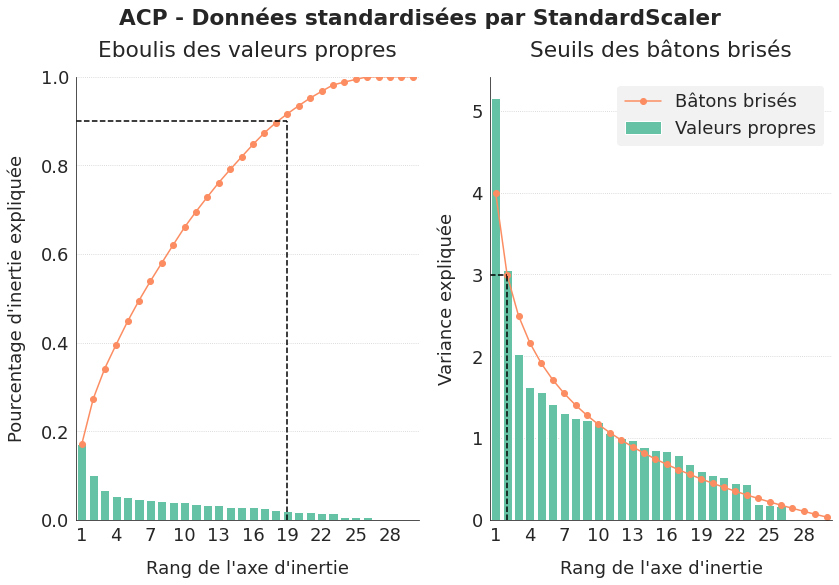

In [ ]:
data_scaled = pd.DataFrame(StandardScaler().fit_transform(data),
                           columns=data.columns, index=data.index)
acp = sfrd.ACP(data_scaled)
graph_title = "ACP - Données standardisées par StandardScaler"
fig, ax = acp.graphique_choix_n(seuil_inertie=0.90, title=graph_title)
save_fig("ML04_part2_alldata01_standardscaler_acp")
plt.show()

L'ACP avec une standardisation préalable par le StandardScaler n'obtient pas de bons résultats : il faut plus conserver 19 axes d'inertie (pour 30 features initiales) pour expliquer 90% de l'inertie du jeu de données.  
Cette mauvaise performance s'explique par le peu de relations linéaires entre les variables et par leurs distributions avec beaucoup d'outliers.

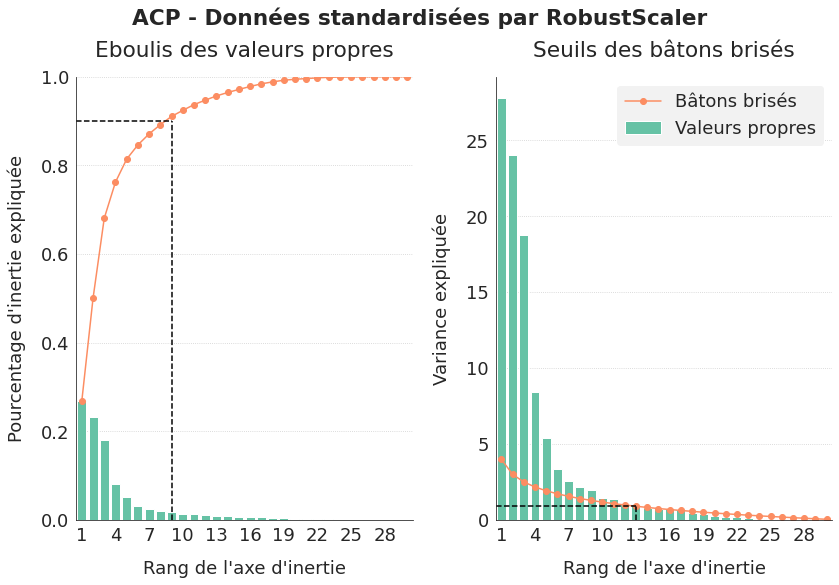

In [ ]:
data_scaled = pd.DataFrame(RobustScaler().fit_transform(data),
                           columns=data.columns, index=data.index)
acp = sfrd.ACP(data_scaled)
graph_title = "ACP - Données standardisées par RobustScaler"
fig, ax = acp.graphique_choix_n(seuil_inertie=0.90, title=graph_title)
save_fig("ML04_part2_alldata02_robustscaler_acp")
plt.show()

L'ACP avec une standardisation préalable par le RobustScaler est bien plus efficace : 90% de l'inertie est résumée par 9 axes d'inertie, ce qui permet de réduire la dimension du jeu de données par plus de 3.  
De plus, le graphique des bâtons brisés montre que les 13 premiers axes d'inertie permettent une meilleure concentration de l'inertie qu'une distribution aléatoire de l'inertie.  
Je choisis donc la standardisation par le RobustScaler.

#### 3.1.2. Analyse de l'ACP basée sur RobustScaler

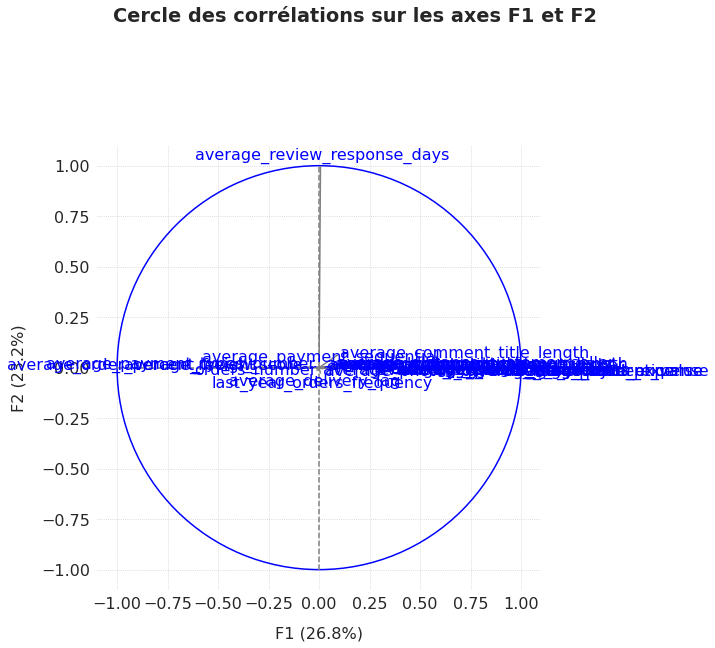

In [ ]:
fig, ax = acp.graphique_correlation_circles(axis_ranks=[1, 2],
                                            show_labels=True,
                                            y_title=1.025, figsize=(10, 10))
plt.show()

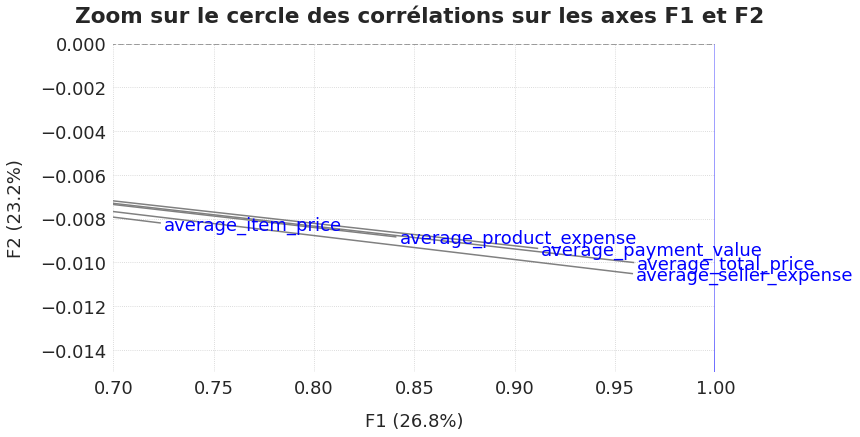

In [ ]:
fig, ax = acp.zoom_correlation_circle(zooms=[0.7, 1.0, -0.015, 0.0],
                                      axis1=1, axis2=2,
                                      figsize=(12, 6), show_labels=True)
plt.show()

Le premier axe d'inertie représente les dépenses moyennes des clients.  
Le deuxième axe d'inertie représente la rapidité (ou plutôt la lenteur) de réponse au questionnaire de satisfaction.

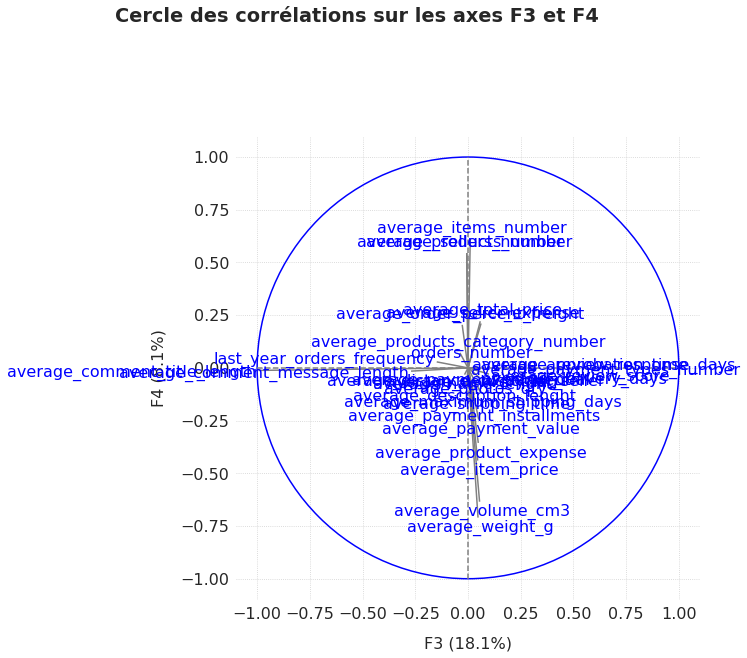

In [ ]:
fig, ax = acp.graphique_correlation_circles(axis_ranks=[3, 4],
                                            show_labels=True,
                                            y_title=1.025, figsize=(10, 10))
plt.show()

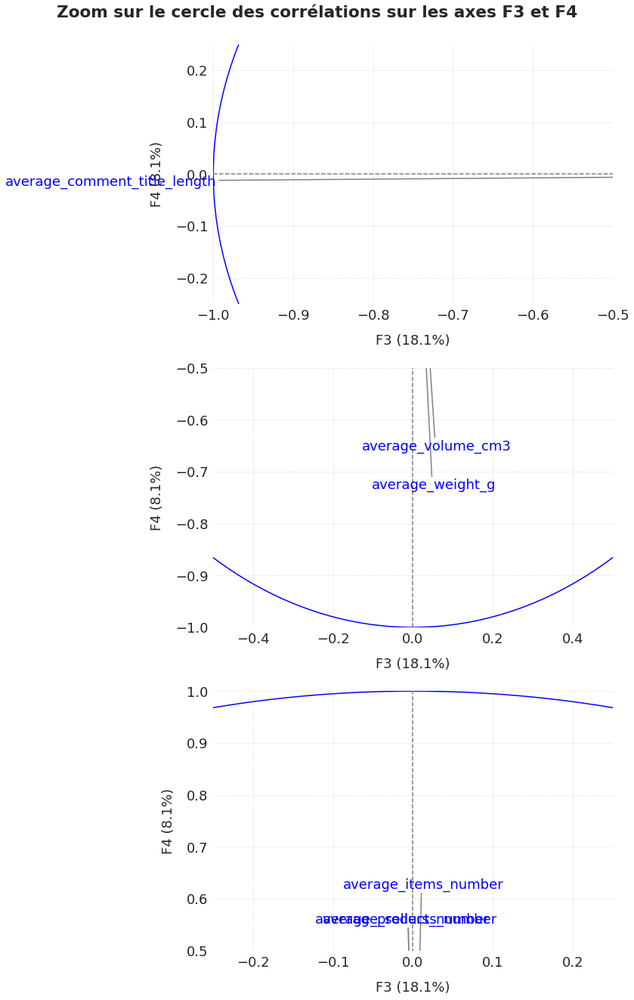

In [ ]:
fig, ax = acp.zoom_correlation_circle(zooms=[[-1.0, -0.5, -0.25, 0.25],
                                             [-0.5, 0.5, -1.0, -0.5],
                                             [-0.25, 0.25, 0.5, 1.0]],
                                      axis1=3, axis2=4, figsize=(12, 8),
                                      nbcol=1, show_labels=True)
plt.show()

Le troisième axe d'inertie représente la longueur moyenne du titre du commentaire.
Le quatrième axe d'inertie représente la ratio entre le nombre moyen d'articles, de vendeurs et de produits d'une part, et le volume et le poids moyen des articles d'autre part.

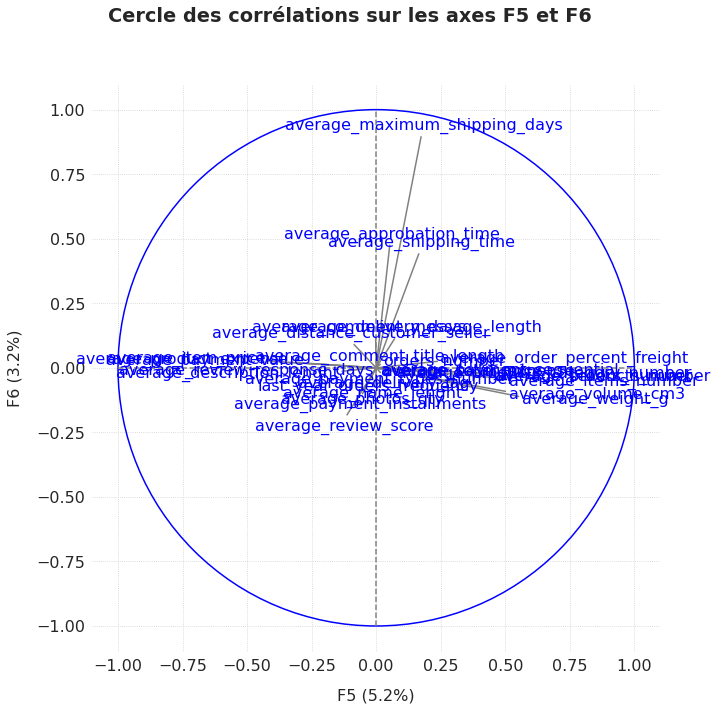

In [ ]:
fig, ax = acp.graphique_correlation_circles(axis_ranks=[5, 6],
                                            show_labels=True,
                                            y_title=1.025, figsize=(10, 10))
plt.show()

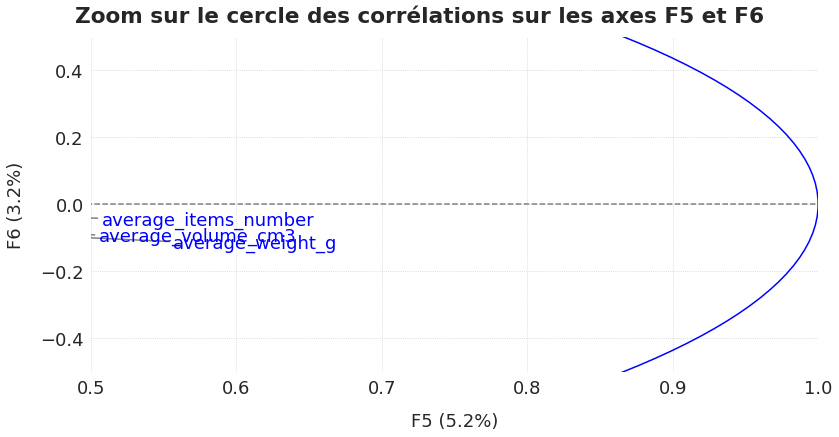

In [ ]:
fig, ax = acp.zoom_correlation_circle(zooms=[0.5, 1.0, -0.5, 0.5],
                                      axis1=5, axis2=6, figsize=(12, 6),
                                      nbcol=1, show_labels=True)
plt.show()

Le cinquième axe d'inertie représente l'encombrement total moyen des commandes (nombre moyen d'articles commandés, et volume moyen et poids moyen des articles).  
Le sixième axe d'inertie représente les délais d'expédition, en particulier le délai maximum prévu de livraison.

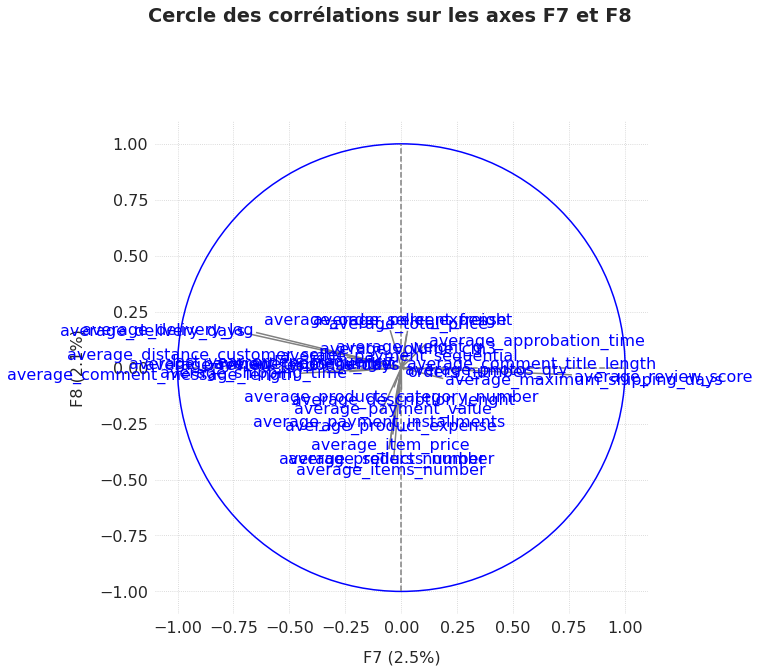

In [ ]:
fig, ax = acp.graphique_correlation_circles(axis_ranks=[7, 8],
                                            show_labels=True,
                                            y_title=1.025, figsize=(10, 10))
plt.show()

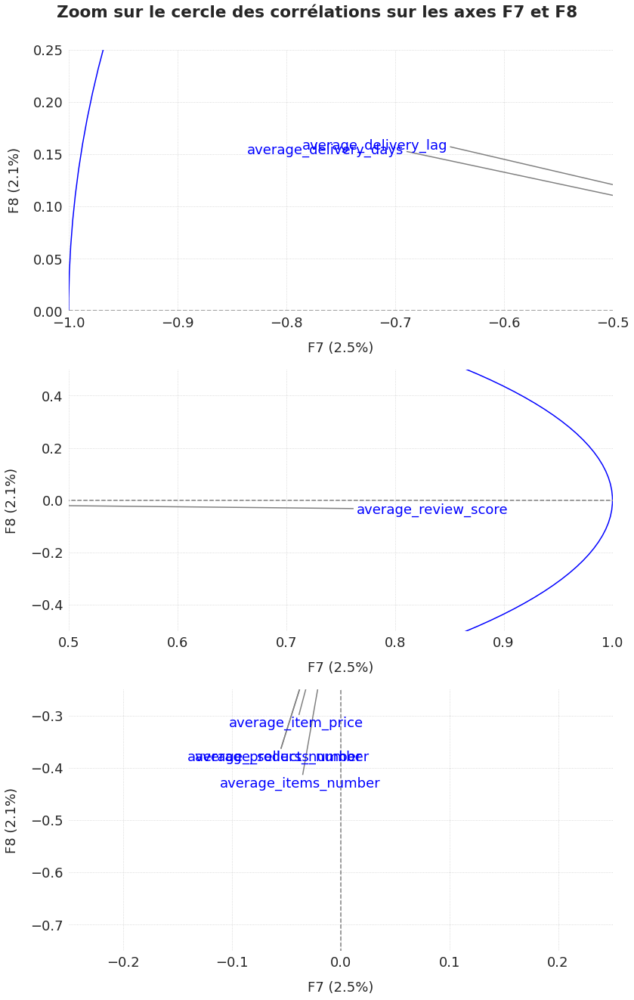

In [ ]:
fig, ax = acp.zoom_correlation_circle(zooms=[[-1.0, -0.5, 0, 0.25],
                                             [0.5, 1.0, -0.5, 0.5],
                                             [-0.25, 0.25, -0.75, -0.25]],
                                      axis1=7, axis2=8, figsize=(12, 8),
                                      nbcol=1, show_labels=True)
plt.show()

Le septième axe d'inertie représente la satisfaction des clients, la rapidité de livraison et l'avance sur la date de livraison prévue, ces 3 variables étant liées.  
Le huitième axe d'inertie est plus difficile à interpréter. Il est lié à la taille du panier : nombre moyen d'articles et de produits dans le panier et prix moyen des articles.

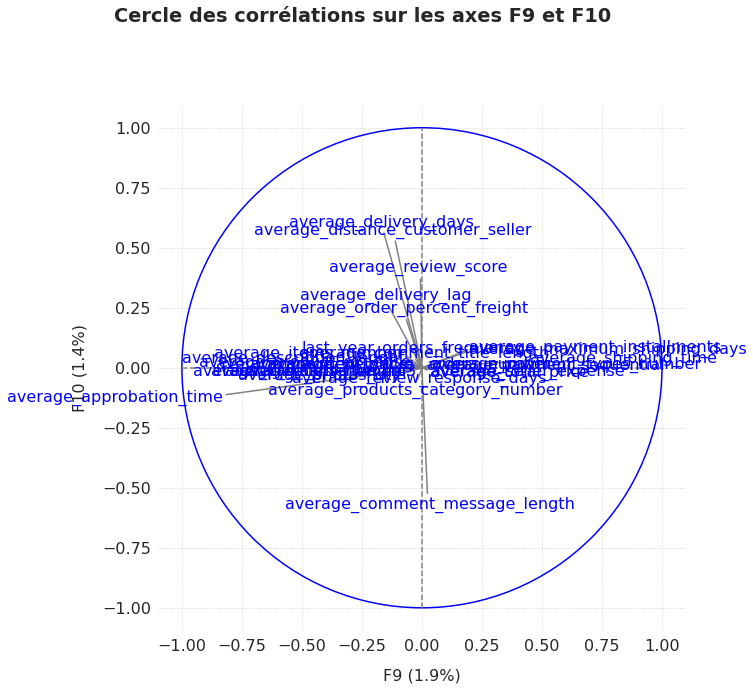

In [ ]:
fig, ax = acp.graphique_correlation_circles(axis_ranks=[9, 10],
                                            show_labels=True,
                                            y_title=1.025, figsize=(10, 10))
plt.show()

Le neuvième axe d'inertie représente la réactivité d'approbation de la commande. On peut supposer que la satisfaction du client est liée à celle-ci.  
Le dixième axe d'inertie est beaucoup plus difficile à interpréter : il dépend de la rapidité de liaison, de la distance entre le vendeur et l'acheteur, de la longueur du message de commentaire et dans une moindre mesure du score.

In [ ]:
acp.define_n_components(9)

In [ ]:
data_reduced = acp.data_projected
data_reduced.head()

,F1 (26.8%),F2 (23.2%),F3 (18.1%),F4 (8.1%),F5 (5.2%),F6 (3.2%),F7 (2.5%),F8 (2.1%),F9 (1.9%)
customer_unique_id,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.477841,1.468682,-13.675803,-0.195582,-0.602827,-0.876350,0.343993,-0.141894,0.748192
0000b849f77a49e4a4ce2b2a4ca5be3f,-3.009389,-1.345665,1.048765,1.145773,-0.223455,-1.026372,0.276495,0.446419,-0.077767
0000f46a3911fa3c0805444483337064,-1.447550,-0.854551,1.265469,-0.505052,0.598716,-0.891361,-1.958663,0.478257,0.374147
0000f6ccb0745a6a4b88665a16c9f078,-2.631142,-0.835281,1.110575,1.100735,-0.684000,-0.295262,-1.101673,0.432352,-0.139795
0004aac84e0df4da2b147fca70cf8255,0.763092,0.619964,1.572319,-1.813405,0.511242,-0.354277,0.690910,-0.166398,0.575694


In [ ]:
data_reduced.shape

(92047, 9)

#### 3.1.3. Visualisation des données réduites

Je visualise les données réduites à l'aide d'un tsne pour évaluer la capacité de clustering sur ces données réduites.  
L'algorithme du TSNE étant assez gourmand, j'utilise mon échantillon de 20% des données.

In [ ]:
data_tsne = data_reduced.iloc[selected_indices].copy()

J'effectue une réduction en 2D grâce à un tsne pour afficher les données réduites, en espérant voir des groupes apparaître. Je vais tester différents niveaux de perplexité (entre 5 et 50 qui sont les niveaux de perplexité les plus courants) pour trouver le plus adapté à mes données.

In [ ]:
X_reduc = []
list_perplexity = [10, 20, 30, 50, 75, 100]
for perplexity in list_perplexity:
    reduc = TSNE(perplexity=perplexity, n_jobs=-1, random_state=42)
    embedding = reduc.fit(data_tsne.values)
    X_reduc.append(pd.DataFrame(embedding.transform(data_tsne.values),
                                index=data_tsne.index,
                                columns=["Axe 1", "Axe 2"]))

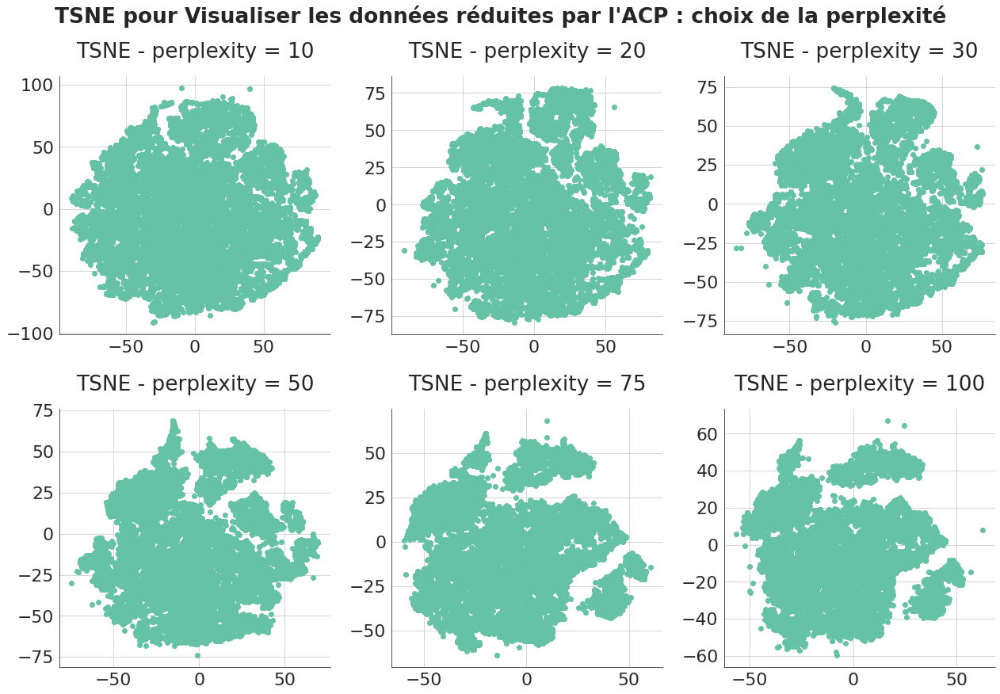

In [ ]:
graph_title = ("TSNE pour Visualiser les données réduites par l'ACP "
               ": choix de la perplexité")
graph = sfg.MyGraph(graph_title, nblin=2, nbcol=3, figsize=(18, 12))
for i in range(len(list_perplexity)):
    xreduc = X_reduc[i]
    graph.add_scatter(xreduc.iloc[:, 0], xreduc.iloc[:, 1],
                      subtitle="TSNE - perplexity = {}".format(
                          list_perplexity[i]),
                      multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_alldata03_acp_visualisation_donnees")
plt.show()

Une perplexité de 50 permet de bien séparer 3 petits groupes d'un groupe global, dans lequel des sous-groupes pourraient apparaître. Cela me semble le meilleur choix de perplexité.

In [ ]:
reduc = TSNE(perplexity=50, n_jobs=-1, random_state=42)
embedding = reduc.fit(data_tsne.values)
data_tsne_reduced = pd.DataFrame(embedding.transform(data_tsne.values),
                                 index=data_tsne.index,
                                 columns=["Axe 1", "Axe 2"])

#### 3.1.4. Essai de clustering

J'effectue le clustering sur mon échantillon de 20% de données, afin de pouvoir afficher les résultats avec le TSNE.

In [ ]:
clust = sfc.MyKmeans(data_tsne, random_state=42)

In [ ]:
clust.choix_n_clusters(2, 20)

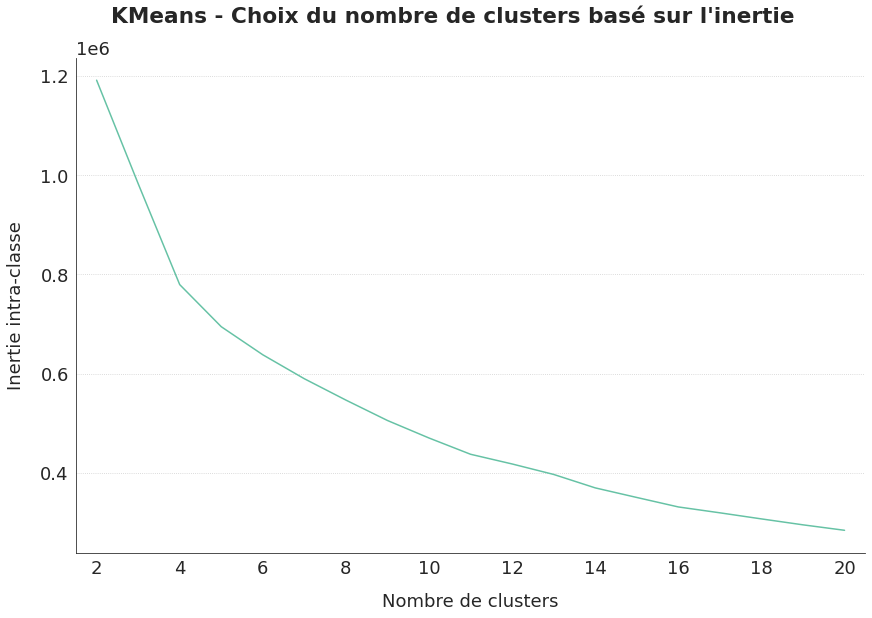

In [ ]:
fig, ax = clust.graphique_choix_nclusters()
save_fig("ML04_part2_alldata04_kmeans_coude")
plt.show()

La méthode du coude m'amènerait à choisir un grand nombre de clusters. Je vais regarder ce que donnent les coefficients de silhouette moyens en fonction du nombre de clusters.

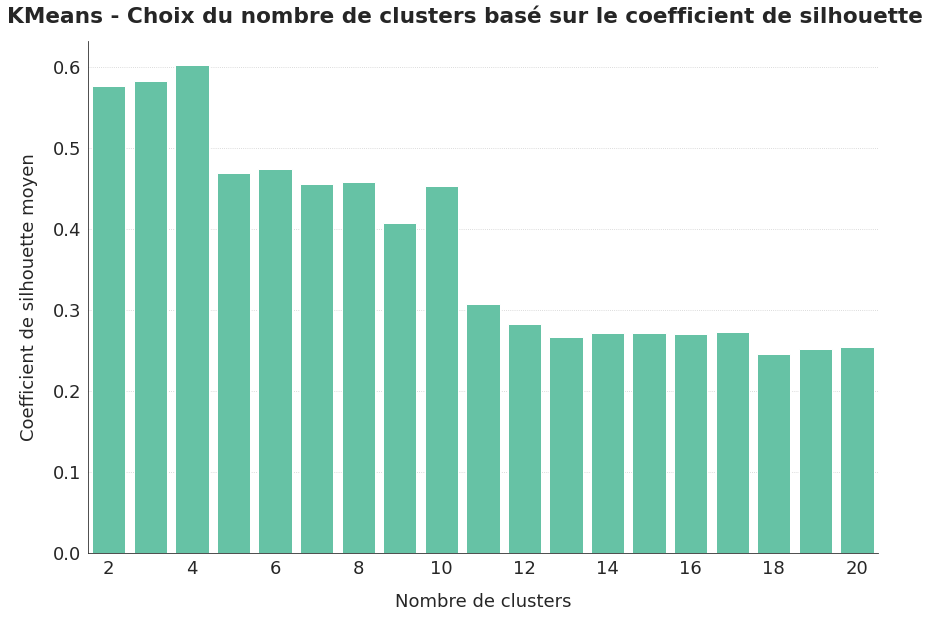

In [ ]:
fig, ax = clust.graphique_silhouette_scores()
save_fig("ML04_part2_alldata05_kmeans_silhouette")
plt.show()

Les coefficients de silhouette poussent à choisir entre 2 et 10 clusters. Analysons plus en détail ces coefficients.

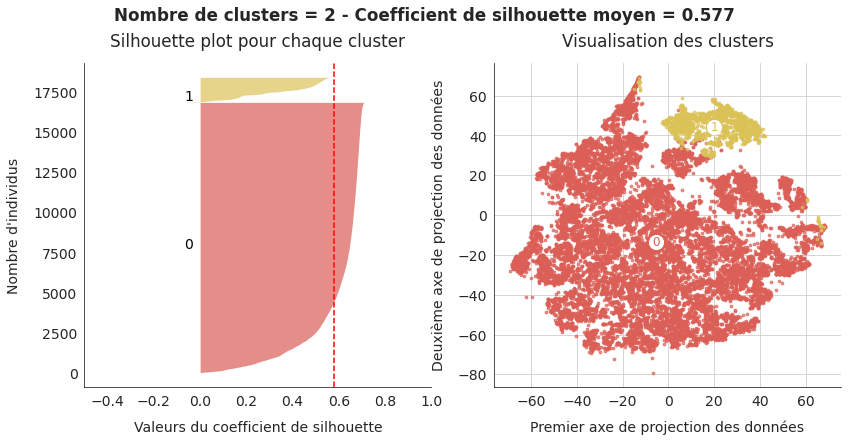

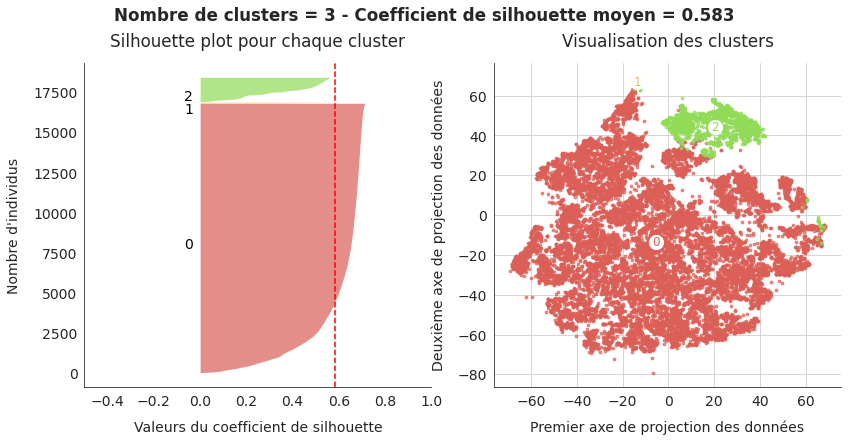

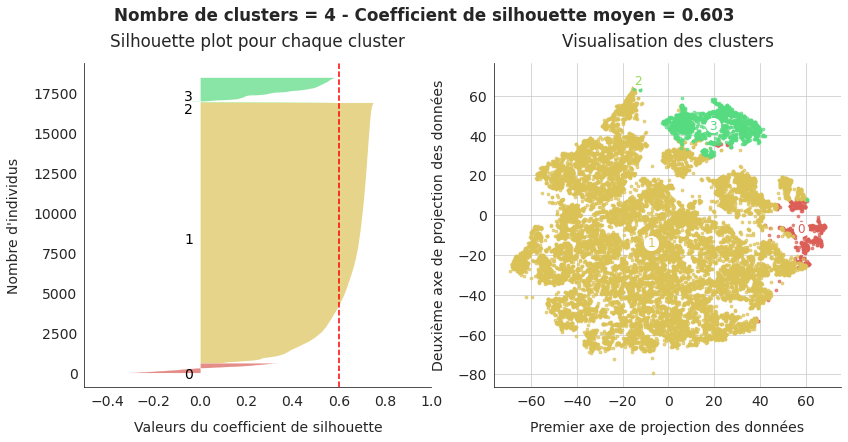

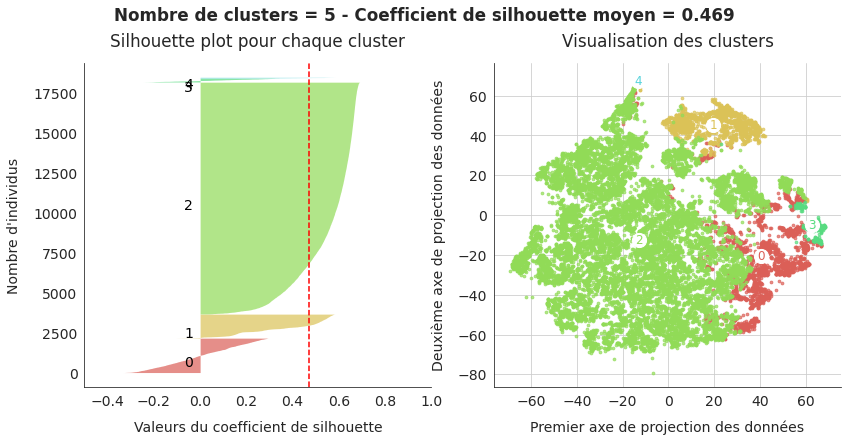

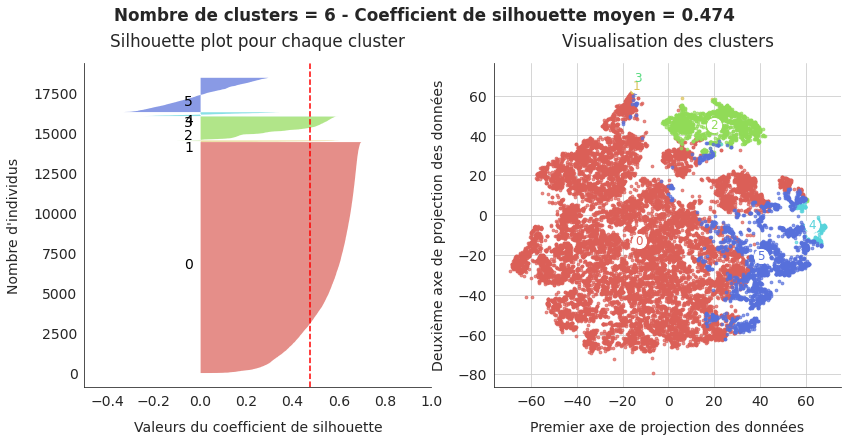

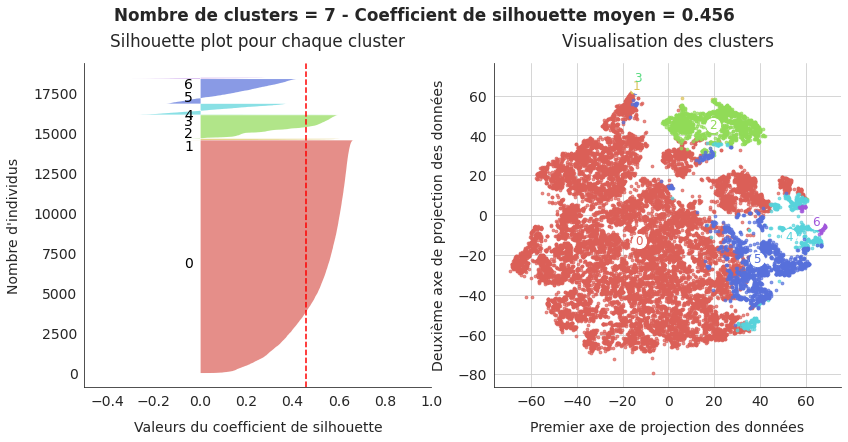

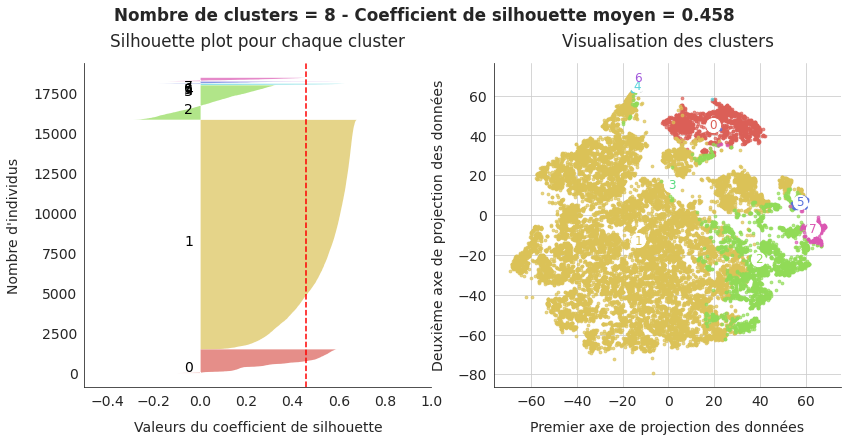

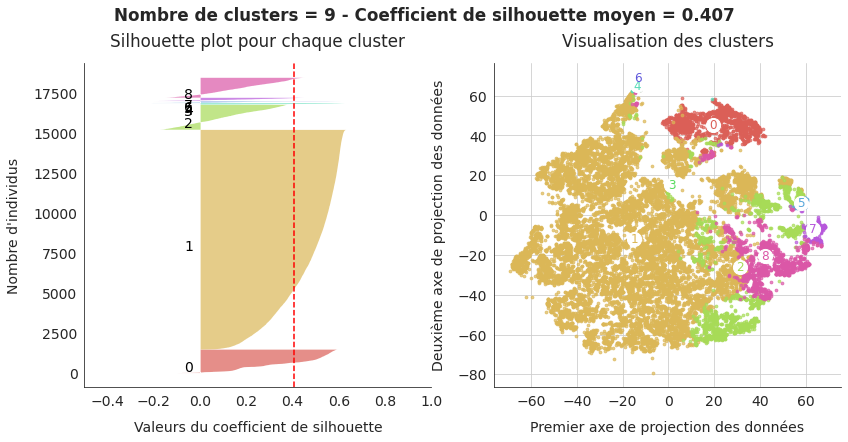

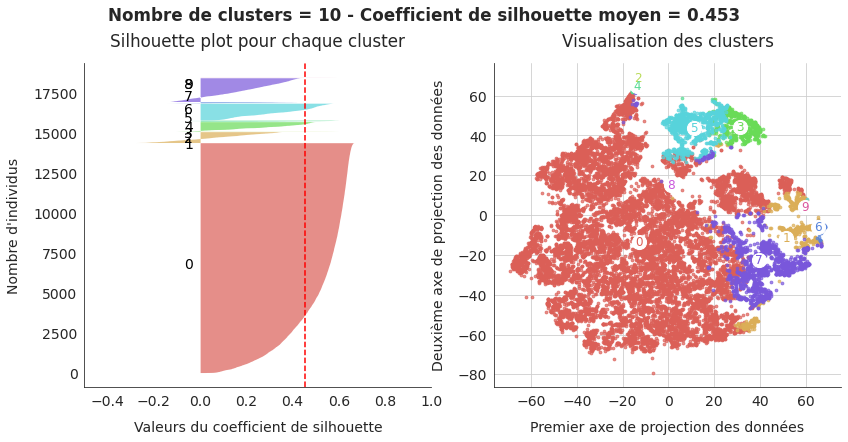

In [ ]:
clust.graphique_silhouette_analysis(data_tsne_reduced,
                                    min_nclust=2,
                                    max_nclust=10,
                                    min_silhouette=-0.5,
                                    plt_mult_param=0.8,
                                    save_figs=True,
                                    save_name="alldata_acp_kmeans")

Il faut se méfier de la projection sur les 2 axes du TSNE. Il se peut que sa représentation de notre problématique ne soit pas exacte sur ces 2 axes, et les distances de la projection ne correspondent pas nécessairement aux distances dans l'espace multi-dimensionnel.  
Je me concentre donc sur l'analyse des coefficients de silhouette plutôt que sur la projection du TSNE.

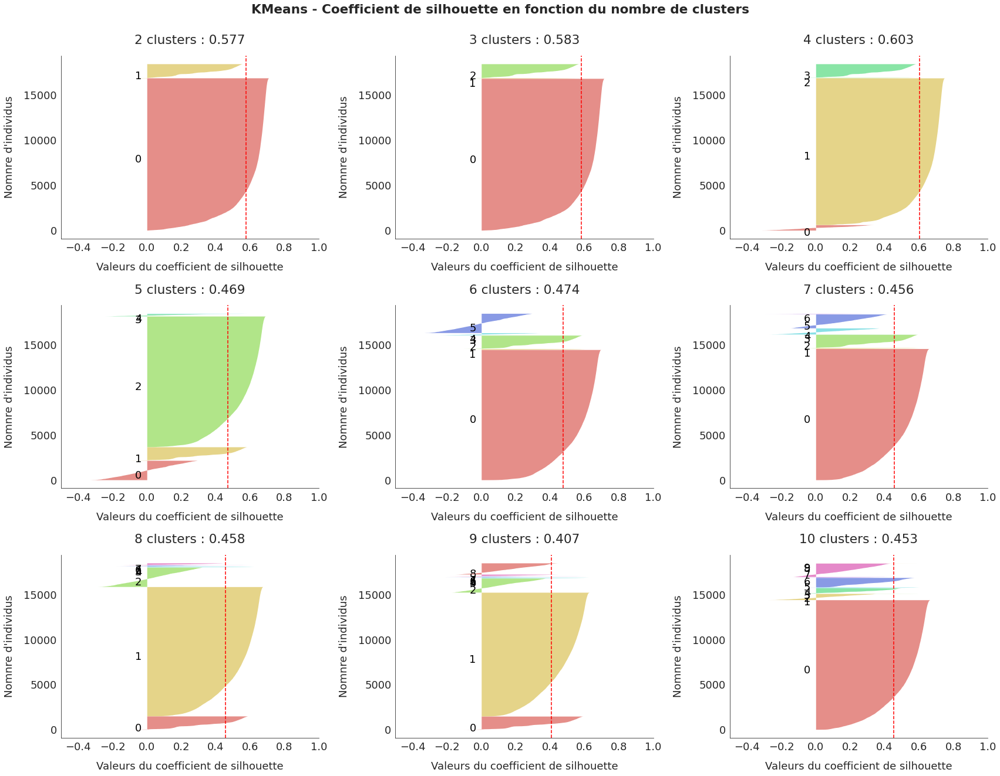

In [ ]:
fig, ax = clust.graphique_silhouette_details(min_nclust=2,
                                             max_nclust=10,
                                             nbcol=3,
                                             min_silhouette=-0.5,
                                             figsize=(24, 18))
save_fig("ML04_part2_alldata06_silhouette_details")
plt.show()

Aucun clustering n'est satisfaisant. A chaque fois, nous avons un ou plusieurs très petits clusters qui ne regroupent que quelques clients et un très gros cluster qui regroupe plus de la moitié des clients.

Etudions la répartition des centroïdes dans le cas de 4 clusters (meilleur score silhouette) et de 8 clusters, par rapport à la moyenne de tout l'échantillon sur les variables d'origine

In [ ]:
nclust = 4
clust.define_n_clusters(nclust)

Done


In [ ]:
check_clust = data_scaled.iloc[selected_indices].copy()
check_clust = check_clust.merge(clust.df_clusters[["cluster"]], how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,orders_number,last_year_orders_frequency,average_items_number,average_total_price,average_products_number,average_sellers_number,average_order_percent_freight,average_item_price,average_product_expense,average_seller_expense,average_name_lenght,average_description_lenght,average_photos_qty,average_weight_g,average_volume_cm3,average_distance_customer_seller,average_maximum_shipping_days,average_products_category_number,average_approbation_time,average_shipping_time,average_delivery_days,average_delivery_lag,average_payment_sequential,average_payment_types_number,average_payment_installments,average_payment_value,average_review_score,average_comment_title_length,average_comment_message_length,average_review_response_days
cluster_0,0.018303,-0.196339,2.558236,9.134966,0.676373,0.676373,-0.613811,7.482489,7.557878,9.079905,-0.197423,0.957887,0.258094,5.504443,3.194963,0.559004,1.054856,0.009983,0.855258,0.730941,0.335483,-0.064809,0.039101,0.019135,1.447587,7.710874,-0.966722,0.860233,0.849121,0.695715
cluster_1,0.034447,-0.183982,0.264218,0.255630,0.112871,0.112871,0.180410,0.238644,0.215500,0.250724,-0.226150,0.270648,0.111338,0.766216,0.485515,0.271513,0.257760,0.005733,0.683312,0.359363,0.298074,0.017954,0.041541,0.021950,0.267808,0.212621,-0.826574,0.152560,0.580742,0.597561
cluster_2,0.045455,-0.363636,0.238636,0.476286,0.113636,0.113636,0.104134,0.525790,0.482526,0.489217,-0.251623,0.337673,-0.119318,1.451252,0.815649,0.433372,0.704501,0.022727,0.722189,0.919516,0.384943,-0.053409,0.034091,0.011364,0.321970,0.470170,-0.920455,2.897727,0.772457,69.920455
cluster_3,0.025216,0.013935,0.438399,0.454713,0.178722,0.178722,0.183259,0.324468,0.341645,0.417803,-0.191341,0.367401,0.141534,0.769920,0.400828,0.296519,0.000033,0.018912,0.624213,0.257986,0.076836,-0.042999,0.037160,0.024884,0.283455,0.360015,-1.152289,14.466490,1.577237,0.681155
all_data,0.033190,-0.168613,0.353309,0.562339,0.136661,0.136661,0.154532,0.482846,0.466172,0.553218,-0.222424,0.301165,0.118050,0.922846,0.567827,0.283333,0.263752,0.006991,0.684180,0.364534,0.281392,0.010092,0.041085,0.022073,0.307735,0.470098,-0.858037,1.353994,0.671537,0.773300


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

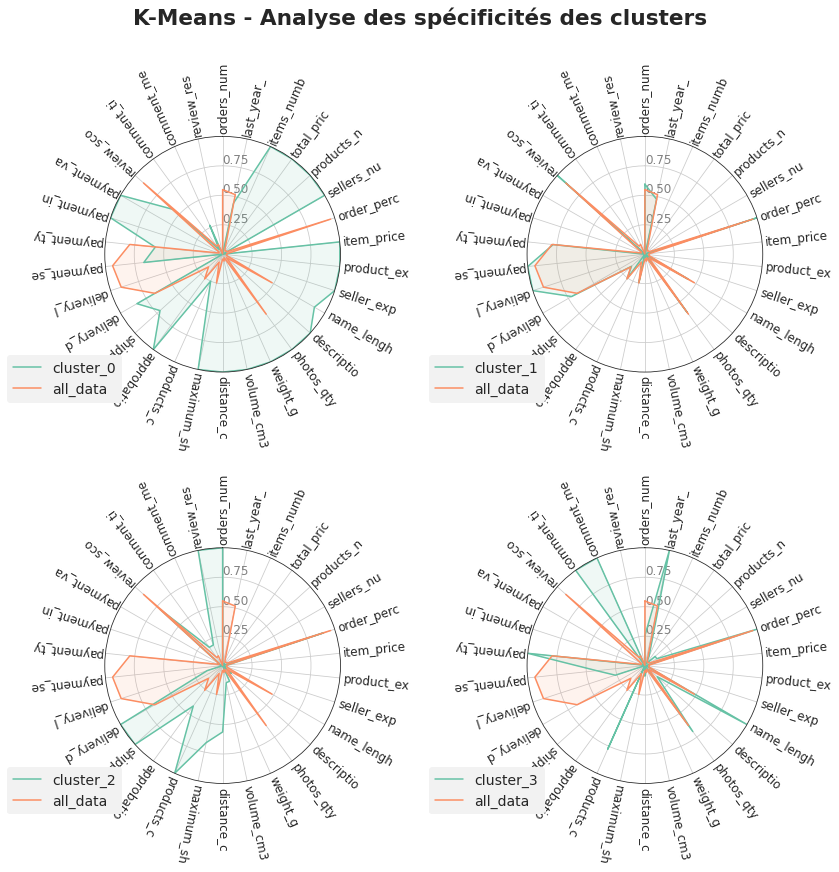

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=2, polar=True, figsize=(12, 12))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_alldata08_kmeans_radar4")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 601 individus
Cluster 1 : 16257 individus
Cluster 2 : 44 individus
Cluster 3 : 1507 individus


La segmentation n'est pas très efficace. Nous obtenons un cluster de très grande taille qui concentre la quasi-totalité de l'échantillon, et deux clusters avec peu d'individus.  
De plus, l'interprétation des clusters grâce aux graphiques en radar n'est pas évidente. Aucune logique métier ne semble émerger de ces clusters.

In [ ]:
nclust = 8
clust.define_n_clusters(nclust)

Done


In [ ]:
check_clust = data_scaled.iloc[selected_indices].copy()
check_clust = check_clust.merge(clust.df_clusters[["cluster"]], how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx)
                       for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,orders_number,last_year_orders_frequency,average_items_number,average_total_price,average_products_number,average_sellers_number,average_order_percent_freight,average_item_price,average_product_expense,average_seller_expense,average_name_lenght,average_description_lenght,average_photos_qty,average_weight_g,average_volume_cm3,average_distance_customer_seller,average_maximum_shipping_days,average_products_category_number,average_approbation_time,average_shipping_time,average_delivery_days,average_delivery_lag,average_payment_sequential,average_payment_types_number,average_payment_installments,average_payment_value,average_review_score,average_comment_title_length,average_comment_message_length,average_review_response_days
cluster_0,0.024291,0.014170,0.402609,0.445129,0.170265,0.170265,0.178578,0.333465,0.343231,0.408085,-0.190520,0.370436,0.142909,0.670830,0.349785,0.304168,-0.010680,0.019231,0.629039,0.257100,0.079060,-0.039136,0.037112,0.025304,0.280589,0.359875,-1.153509,14.557355,1.573576,0.596829
cluster_1,0.035321,-0.181552,0.227351,0.077974,0.101884,0.101884,0.224367,0.073864,0.041946,0.071715,-0.225035,0.253770,0.102981,0.234977,0.216409,0.265973,0.202223,0.006040,0.682079,0.299411,0.284788,0.015935,0.041696,0.021980,0.202741,0.040289,-0.809573,0.158957,0.561555,0.526509
cluster_2,0.026964,-0.199907,0.302185,2.049627,0.135751,0.135751,-0.224511,2.056092,2.076518,2.067233,-0.235733,0.449519,0.192004,5.131578,2.731275,0.345613,0.682091,0.003952,0.698353,0.795856,0.408153,0.030776,0.041764,0.021540,0.847797,2.043105,-0.941887,0.235472,0.740445,0.540349
cluster_3,1.000000,-1.000000,1.000000,1.154956,0.500000,0.500000,2.168233,-0.258299,0.285362,1.178964,0.392857,0.179589,0.500000,4.655738,0.651331,-0.216908,244.755952,0.000000,0.882980,0.271896,0.500000,-5.900000,0.500000,0.500000,2.000000,0.593197,0.000000,0.000000,0.000000,0.500000
cluster_4,0.025316,-0.240506,0.284810,0.482642,0.139241,0.139241,0.083978,0.416473,0.398240,0.456265,-0.203888,0.222771,-0.120253,0.875211,0.390261,0.305228,0.352002,0.012658,0.633503,0.605081,0.329905,-0.027215,0.018987,0.006329,0.234177,0.420075,-0.981013,2.145570,0.858499,35.512658
cluster_5,0.051724,-0.112069,16.702586,14.266783,4.150862,4.150862,0.112065,0.316710,2.451666,13.400741,-0.299867,0.123273,-0.097431,1.328668,0.805410,0.335463,0.559366,0.034483,0.951571,0.750689,0.186422,-0.050862,0.008621,0.008621,0.948276,4.412333,-1.547414,0.646552,1.079433,0.643319
cluster_6,0.000000,-0.571429,0.000000,0.325869,0.000000,0.000000,0.072760,0.514197,0.437831,0.336346,-0.321429,0.621722,-0.035714,1.872927,1.144261,0.418184,0.824018,0.000000,1.068297,1.350216,0.392857,0.142857,0.000000,0.000000,0.595238,0.396691,-0.714286,1.928571,0.486395,111.607143
cluster_7,0.004717,-0.226415,0.155660,11.630374,0.075472,0.075472,-0.850635,13.372855,12.651613,11.825349,-0.094508,1.626627,0.429245,6.271095,3.832600,0.637917,0.718732,0.000000,0.914420,0.783027,0.205189,-0.184906,0.047170,0.023585,1.776730,12.247715,-0.813679,1.377358,0.835804,0.887972
all_data,0.033190,-0.168613,0.353309,0.562339,0.136661,0.136661,0.154532,0.482846,0.466172,0.553218,-0.222424,0.301165,0.118050,0.922846,0.567827,0.283333,0.263752,0.006991,0.684180,0.364534,0.281392,0.010092,0.041085,0.022073,0.307735,0.470098,-0.858037,1.353994,0.671537,0.773300


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 1482 individus
Cluster 1 : 14354 individus
Cluster 2 : 2151 individus
Cluster 3 : 1 individus
Cluster 4 : 79 individus
Cluster 5 : 116 individus
Cluster 6 : 14 individus
Cluster 7 : 212 individus


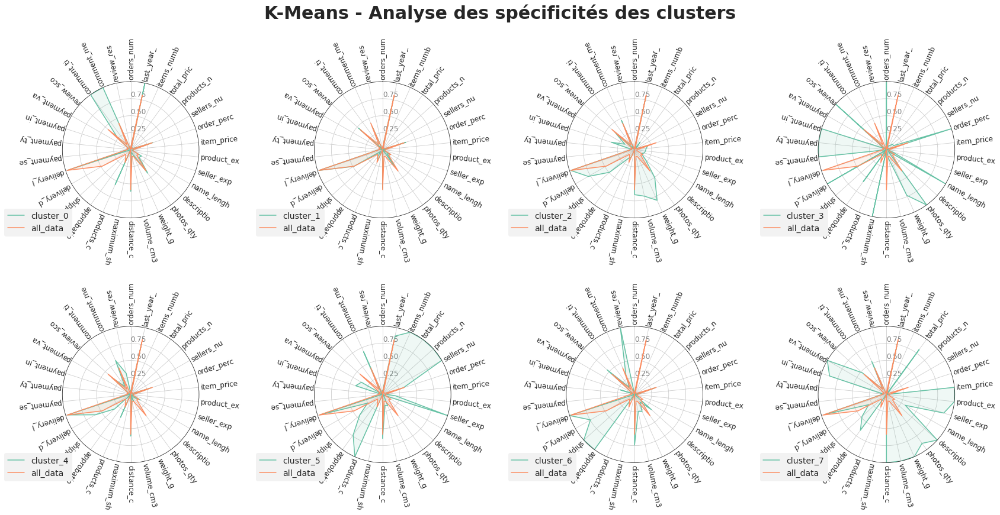

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=4, polar=True, figsize=(24, 12))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_alldata09_kmeans_radar8")
plt.show()

Une fois encore, la répartition entre les clusters obtenus n'est pas satisfaisante : 5 des 8 clusters contiennent très peu d'individus et ressemblent plus à une détection de profils atypiques qu'à une segmentation.

Le fait d'utiliser un RobustScaler modifie la distribution des variables, ce qui peut biaiser la segmentation et son interprétation.

Je vais donc tenter d'autres approches de réduction de dimension basées sur les données centrées réduites de StandardScaler : kernalPCA, Isomap et Umap.

<a id='3_2'></a>

### 3.2. Approche basée sur une réduction de dimension par ACP à noyau

Mes différents tests ne me permettent pas de faire tourner l'ACP à noyau, même avec seulement 20% des données et en utilisant Google Colab (pas assez de RAM).  
Je me concentre sur des algorithmes de réduction de dimension non-linéaire moins gourmands en mémoire et plus rapides que le Kernel ACP.

### 3.3. Approche basée sur une réduction de dimension par Isomap

L'Isomap conserve la structure globale des données en prenant en compte toutes les distances entre les paires de points.  
Comme pour l'ACP à noyau, mes différents tests n'ont pas réussi à faire tourner l'algorithme d'Isomap sur Google Colab, même avec un échantillon de 20% des données (pas assez de RAM).


### 3.4. Approche basée sur une réduction de dimension par UMAP

L'algorithme UMAP (méthode locale) a été très long au calcul, au point que j'ai décidé de l'arrêter et d'abandonner son utilisation. Après 7 heures de calcul pendant la nuit, sur la base des 20% des données, le calcul n'était toujours pas fini.

<a id='3_5'></a>

### 3.5. Approche basée sur une réduction de dimension par LLE

La LLE est une méthode locale qui cherche à souligner certaines caractéristiques à l'échelle locale, sans prendre en compte les distances globales.

In [ ]:
full_data_scaled = pd.DataFrame(StandardScaler().fit_transform(data),
                                columns=data.columns,
                                index=data.index)
data_scaled = full_data_scaled.iloc[selected_indices].copy()

In [ ]:
list_ncomponents = np.arange(2, 7)
lle_standard_errors = []
lle_standard_calcul_time = []
for i in range(len(list_ncomponents)):
    start_time = timer()
    algo = LocallyLinearEmbedding(n_components=list_ncomponents[i],
                                  method="standard",
                                  n_jobs=-1,
                                  random_state=42)
    algo.fit(data_scaled)
    lle_standard_calcul_time.append(timer() - start_time)
    lle_standard_errors.append(algo.reconstruction_error_)

In [ ]:
lle_hessian_errors = []
lle_hessian_calcul_time = []
for i in range(len(list_ncomponents)):
    start_time = timer()
    algo = LocallyLinearEmbedding(n_components=list_ncomponents[i],
                                  method="hessian",
                                  n_jobs=-1,
                                  n_neighbors=29,
                                  eigen_solver="dense",
                                  random_state=42)
    algo.fit(data_scaled)
    lle_hessian_calcul_time.append(timer() - start_time)
    lle_hessian_errors.append(algo.reconstruction_error_)

In [ ]:
lle_modified_errors = []
lle_modified_calcul_time = []
for i in range(len(list_ncomponents)):
    start_time = timer()
    algo = LocallyLinearEmbedding(n_components=list_ncomponents[i],
                                  method="modified",
                                  n_jobs=-1,
                                  n_neighbors=max(5, list_ncomponents[i]),
                                  eigen_solver="dense",
                                  random_state=42)
    algo.fit(data_scaled)
    lle_modified_calcul_time.append(timer() - start_time)
    lle_modified_errors.append(algo.reconstruction_error_)

/usr/local/lib/python3.6/dist-packages/sklearn/manifold/_locally_linear.py:450: RuntimeWarning: invalid value encountered in double_scalars
  alpha_i = np.linalg.norm(Vi.sum(0)) / np.sqrt(s_i)
/usr/local/lib/python3.6/dist-packages/sklearn/manifold/_locally_linear.py:450: RuntimeWarning: invalid value encountered in double_scalars
  alpha_i = np.linalg.norm(Vi.sum(0)) / np.sqrt(s_i)
/usr/local/lib/python3.6/dist-packages/sklearn/manifold/_locally_linear.py:450: RuntimeWarning: invalid value encountered in double_scalars
  alpha_i = np.linalg.norm(Vi.sum(0)) / np.sqrt(s_i)
/usr/local/lib/python3.6/dist-packages/sklearn/manifold/_locally_linear.py:450: RuntimeWarning: invalid value encountered in double_scalars
  alpha_i = np.linalg.norm(Vi.sum(0)) / np.sqrt(s_i)


In [ ]:
lle_ltsa_errors = []
lle_ltsa_calcul_time = []
for i in range(len(list_ncomponents)):
    start_time = timer()
    algo = LocallyLinearEmbedding(n_components=list_ncomponents[i],
                                  method="ltsa",
                                  n_jobs=-1,
                                  n_neighbors=max(5, list_ncomponents[i]),
                                  eigen_solver="dense",
                                  random_state=42)
    algo.fit(data_scaled)
    lle_ltsa_calcul_time.append(timer() - start_time)
    lle_ltsa_errors.append(algo.reconstruction_error_)

In [ ]:
lle_standard_errors

[2.26612859872622e-17,
 -4.6870637725574166e-18,
 -3.59571306762584e-17,
 2.0758920055733926e-16,
 5.479960083656063e-16]

In [ ]:
lle_hessian_errors

[-5.197251754633449e-14,
 -6.546622125995205e-14,
 -2.400759321568851e-14,
 -7.500804033745629e-14,
 -6.584026200031956e-14]

In [ ]:
lle_modified_errors

[1.6246948803451967e-16,
 2.9972739625340507e-06,
 -1.0936133921215988e-13,
 0.0,
 0.0]

In [ ]:
lle_ltsa_errors

[-4.996753368123999e-15,
 -4.8577762469670275e-15,
 -1.274100200329347e-13,
 -52.000918978802645,
 -72.45056556778991]

L'erreur de reconstruction est estimée par les valeurs propres de la matrice de plongement. Cela explique que nous ayons des valeurs négatives. Ces valeurs négatives signifient que les vecteurs propres sont dans la direction opposée. Nous devons donc comparer la valeur absolue des erreurs de reconstruction. La meilleure est la plus petite valeur.

In [ ]:
lle_errors = pd.DataFrame({"standard": np.abs(lle_standard_errors),
                           "hessian": np.abs(lle_hessian_errors),
                           "modified": np.abs(lle_modified_errors),
                           "ltsa": np.abs(lle_ltsa_errors)},
                          index=list_ncomponents,
                          columns=["standard", "hessian", "modified", "ltsa"])
lle_times = pd.DataFrame({"standard": lle_standard_calcul_time,
                          "hessian": lle_hessian_calcul_time,
                          "modified": lle_modified_calcul_time,
                          "ltsa": lle_ltsa_calcul_time},
                         index=list_ncomponents,
                         columns=["standard", "hessian", "modified", "ltsa"])

In [ ]:
filename = "lle_errors_allfeatures.csv"
if IN_COLAB:
    filename = PATH_DRIVE + "/" + filename
lle_errors.to_csv(filename)

In [ ]:
filename = "lle_times_allfeatures.csv"
if IN_COLAB:
    filename = PATH_DRIVE + "/" + filename
lle_times.to_csv(filename)

In [ ]:
lle_errors = pd.read_csv("lle_errors_allfeatures.csv", index_col=0)
lle_errors = np.abs(lle_errors)
lle_errors

,standard,hessian,modified,ltsa
2,2.266129e-17,5.197252e-14,1.624695e-16,4.996753e-15
3,4.687064e-18,6.546622e-14,2.997274e-06,4.857776e-15
4,3.595713e-17,2.400759e-14,1.093613e-13,1.274100e-13
5,2.075892e-16,7.500804e-14,0.000000e+00,5.200092e+01
6,5.479960e-16,6.584026e-14,0.000000e+00,7.245057e+01


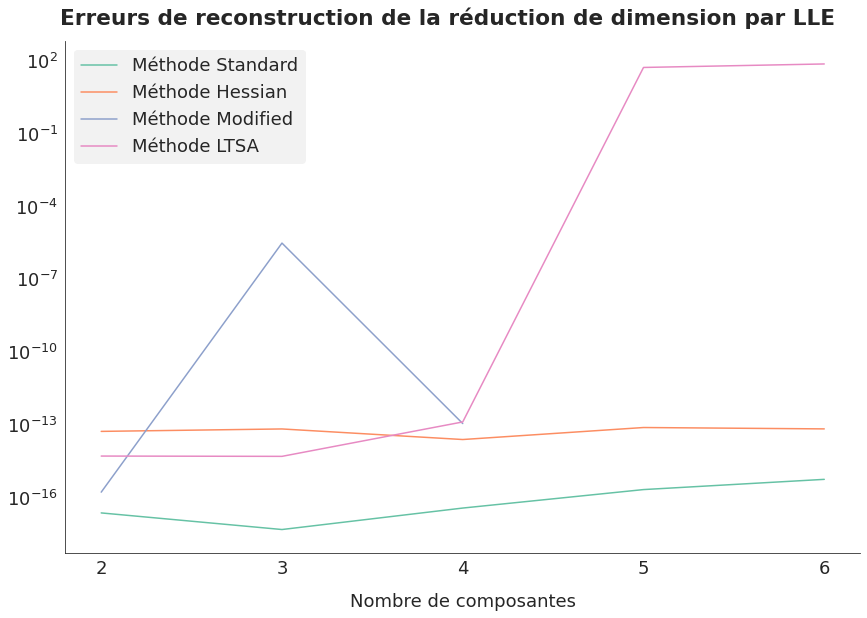

In [ ]:
graph_title = "Erreurs de reconstruction de la réduction de dimension par LLE"
graph = sfg.MyGraph(graph_title)
graph.add_plot(lle_errors.index, lle_errors.standard,
               label="Méthode Standard")
graph.add_plot(lle_errors.index, lle_errors.hessian,
               label="Méthode Hessian")
graph.add_plot(lle_errors.index, lle_errors.modified.replace(0, np.nan),
               label="Méthode Modified")
graph.add_plot(lle_errors.index, lle_errors.ltsa,
               label="Méthode LTSA", legend=True)
graph.set_axe_x(label="Nombre de composantes",
                tick_min=2, tick_max=6, tick_step=1,
                tick_labels_format=":.0f")
fig, ax = graph.fig, graph.ax
ax[0].set_yscale("log")
save_fig("ML04_part2_alldata10_select_lle")
plt.show()

L'erreur de reconstruction minimale est obtenue avec la méthode standard et 3 composantes. Je réduis les données avec ces paramètres.  
Je trace un graphique d'observation des points en 3D qui se prête bien à mes 3 composantes.

In [ ]:
algo = LocallyLinearEmbedding(n_components=3, method="standard",
                              n_jobs=-1, random_state=42)
data_reduced = pd.DataFrame(algo.fit_transform(data_scaled),
                            index=data_scaled.index,
                            columns=["Axe 1", "Axe 2", "Axe 3"])

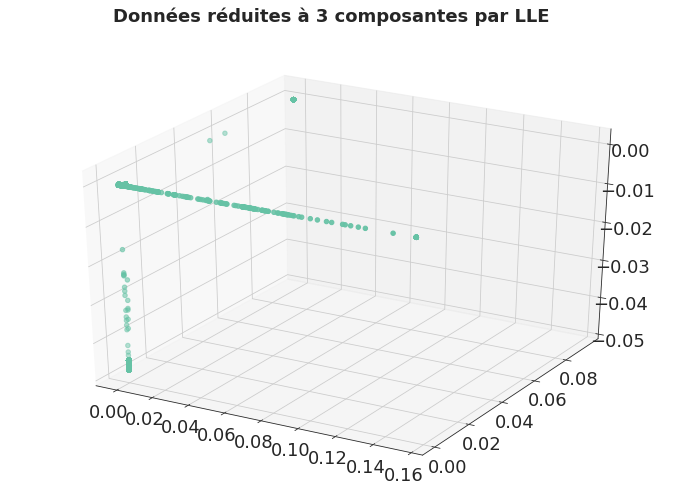

In [ ]:
fig = plt.figure(figsize=(12, 8))
fig.suptitle("Données réduites à 3 composantes par LLE",
             y=0.95, fontsize=18, fontweight="bold")
ax = fig.add_subplot(111, projection="3d")
ax.scatter(data_reduced.iloc[:, 0],
           data_reduced.iloc[:, 1],
           data_reduced.iloc[:, 2])
save_fig("ML04_part2_alldata11_project_lle")
plt.show()

A première vue, cette réduction de dimension des données ne paraît très propice à une segmentation des données car les points ne sont pas très bien répartis dans l'espace.  
Regardons ce que donne une visualtion en 2D grâce à un TSNE.

In [ ]:
data_tsne = data_reduced.copy()

J'effectue une réduction en 2D grâce à un tsne pour afficher les données réduites, en espérant voir des groupes apparaître. Je vais tester différents niveaux de perplexité (entre 10 et 50 qui sont les niveaux de perplexité les plus courants) pour trouver le plus adapté à mes données.

In [ ]:
X_reduc = []
list_perplexity = [10, 20, 30, 50, 75, 100]
for perplexity in list_perplexity:
    reduc = TSNE(perplexity=perplexity, n_jobs=-1, random_state=42)
    embedding = reduc.fit(data_tsne.values)
    X_reduc.append(pd.DataFrame(embedding.transform(data_tsne.values),
                                index=data_tsne.index,
                                columns=["Axe 1", "Axe 2"]))

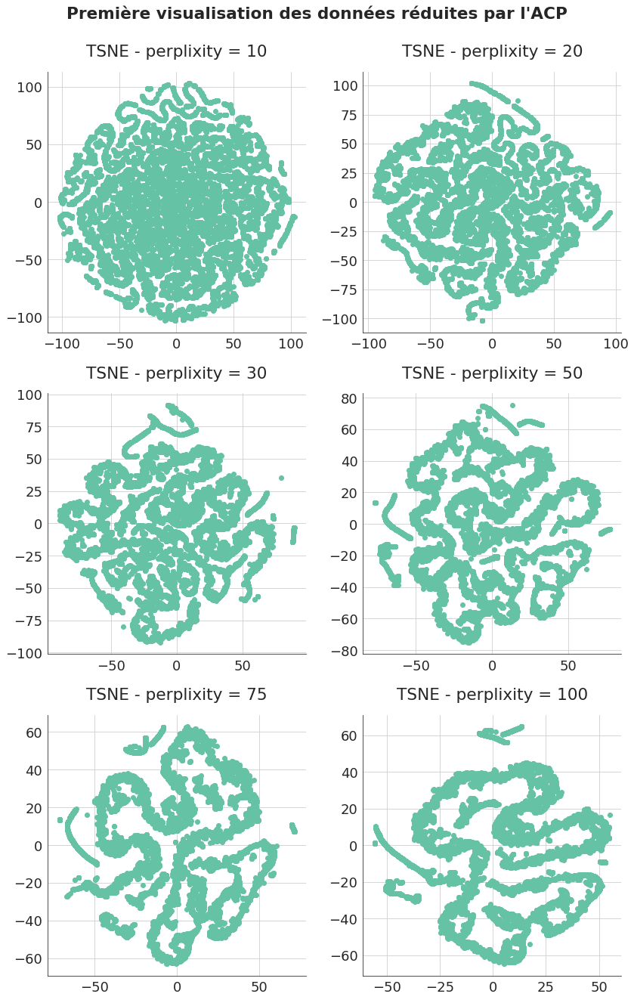

In [ ]:
graph_title = "Première visualisation des données réduites par l'ACP"
graph = sfg.MyGraph(graph_title, nblin=3, nbcol=2)
for i in range(len(list_perplexity)):
    xreduc = X_reduc[i]
    graph.add_scatter(xreduc.iloc[:, 0], xreduc.iloc[:, 1],
                      subtitle="TSNE - perplixity = {}".format(
                          list_perplexity[i]),
                      multi_index=i+1)
fig, ax = graph.fig, graph.ax
plt.show()

In [ ]:
reduc = TSNE(perplexity=75, n_jobs=-1, random_state=42)
embedding = reduc.fit(data_tsne.values)
data_tsne_reduced = pd.DataFrame(embedding.transform(data_tsne.values),
                                 index=data_tsne.index,
                                 columns=["Axe 1", "Axe 2"])

Pour mon étude, je dois faire le clustering sur les 20% de données sélectionnées pour le tsne, afin de pouvoir afficher les résultats avec X_reduc.

In [ ]:
clust = sfc.MyKmeans(data_tsne, random_state=42)

In [ ]:
clust.choix_n_clusters(2, 20)

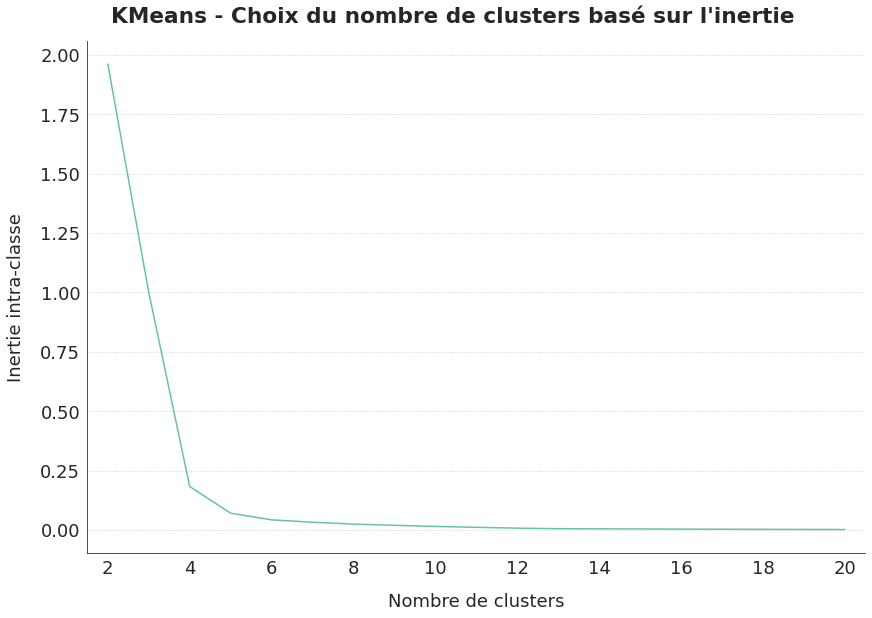

In [ ]:
fig, ax = clust.graphique_choix_nclusters()

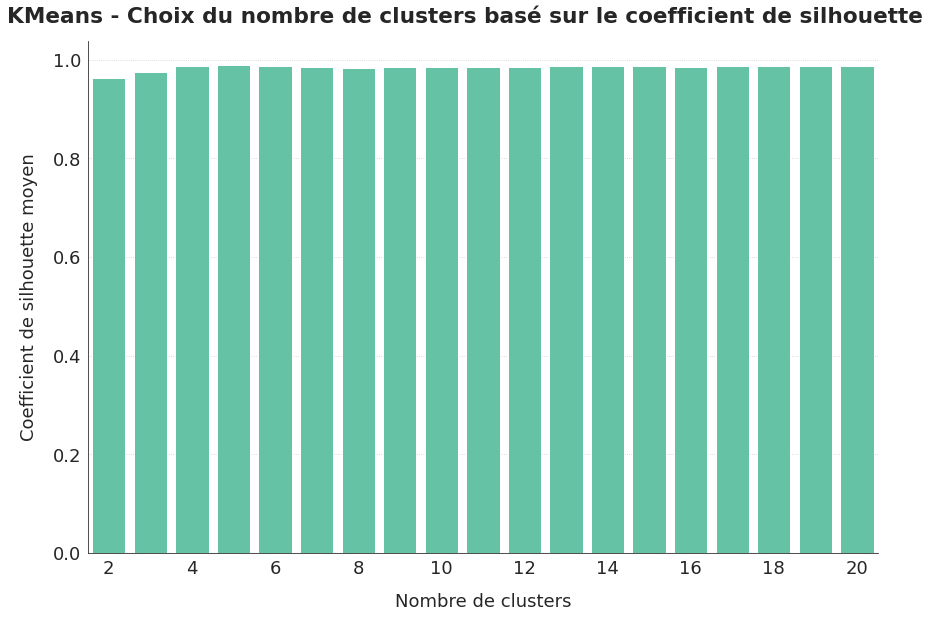

In [ ]:
fig, ax = clust.graphique_silhouette_scores()

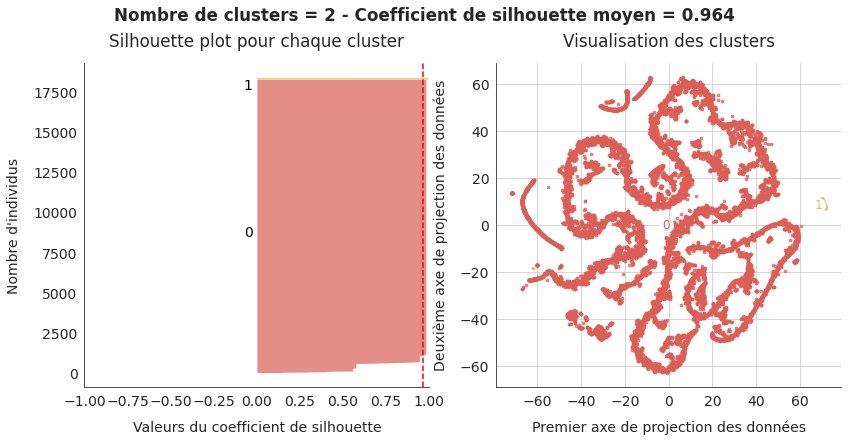

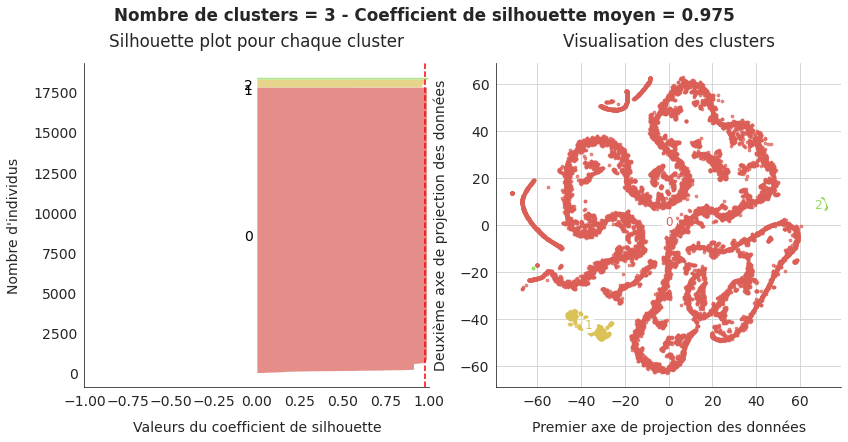

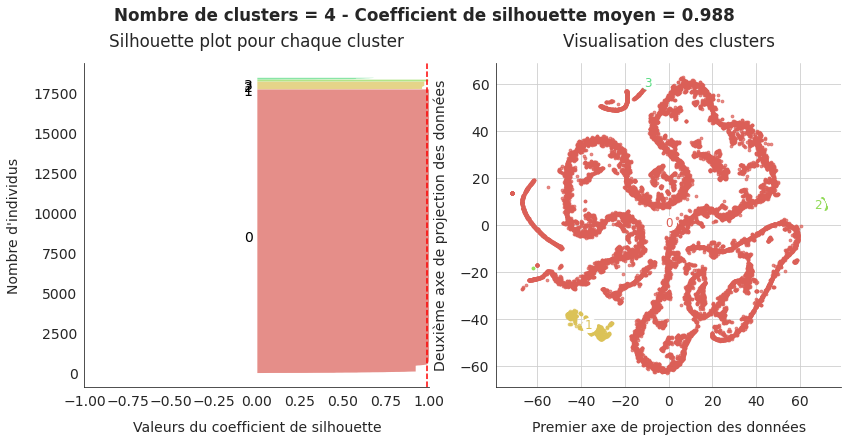

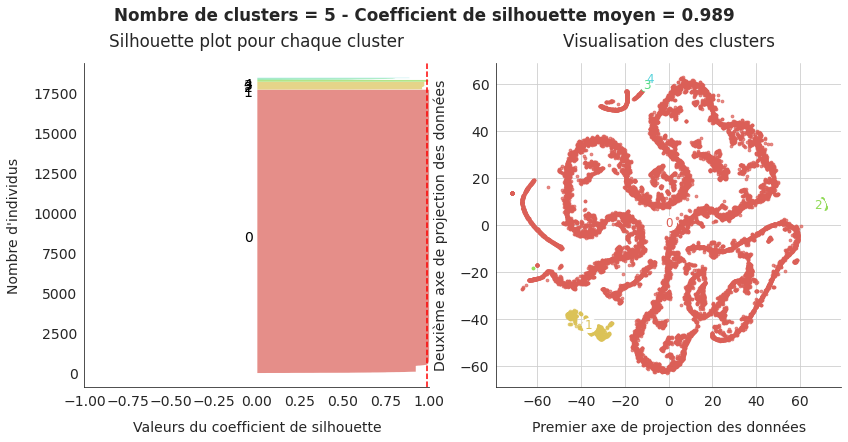

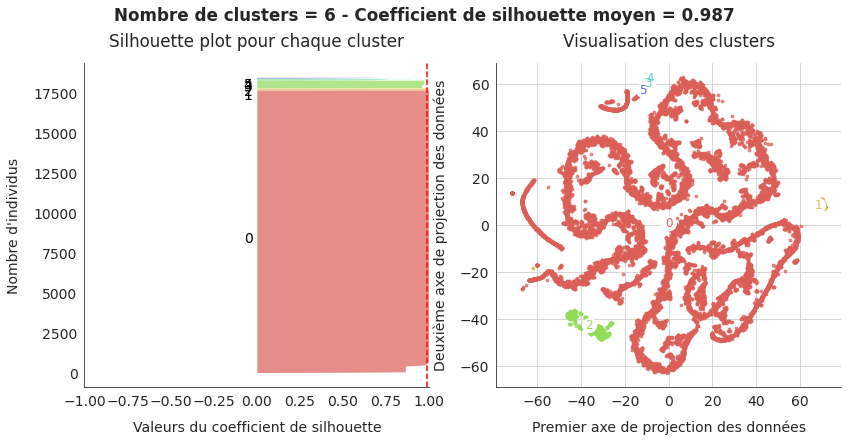

In [ ]:
clust.graphique_silhouette_analysis(data_tsne_reduced,
                                    min_nclust=2,
                                    max_nclust=6,
                                    plt_mult_param=0.8)

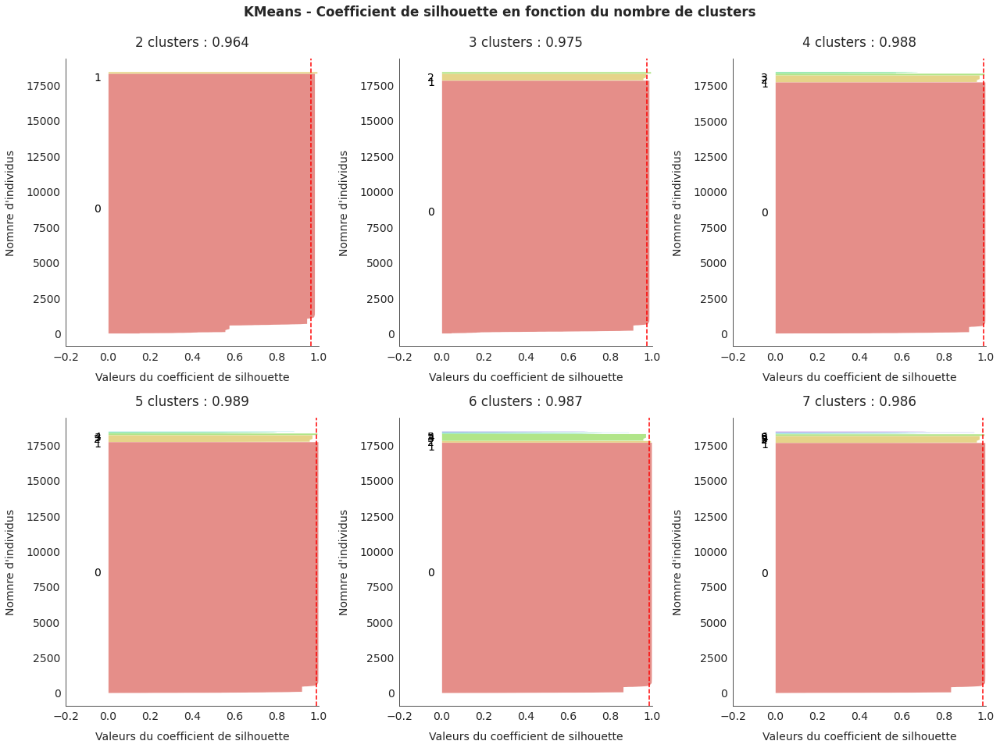

In [ ]:
fig, ax = clust.graphique_silhouette_details(min_nclust=2,
                                             max_nclust=7,
                                             nbcol=3,
                                             min_silhouette=-0.2,
                                             plt_mult_param=0.8,
                                             figsize=(18, 13))
save_fig("ML04_part2_alldata12_lle_silhouette")
plt.show()

On voit que cette approche n'est pas efficace. Nous obtenons un cluster qui regroupe plus de 90% des clients et quelques groupes avec très peu d'individus. Ce n'est pas une segmentation intéressante par rapport à notre projet.

Il va falloir rechercher des clusterings plus spécifiques en ciblant des caractéristiques clients basées sur la connaissance métier telles que :
- la satisfaction client (rapidité de traitement et d'expédition de la commande, retard de livraison, score et commentaires) ;
- le type de produits achetés (prix moyen, volume, poids, précision de la description, distance du vendeur) ;
- le type de paniers (prix total, pourcentage des frais de port, prix moyen par article, le nombre d'échéances de paiement, dépense moyenne par produit et par vendeur).

---
<a id='4_0'></a>

## <font color=blue>4. Clustering sur la satisfaction client</font>

Je vais essayer de segmenter la clientèle sur la base de sa satisfaction. Je mesure cette satisfaction grâce aux variables :
- rapidité de traitement et d'expédition de la commande liée au vendeur (average_approbation_time, average_shipping_time) ;
- retard de livraison (average_delivery_lag) ;
- score et longueur des titres et des commentaires (average_review_score, average_comment_title_length, average_comment_message_length).

### 4.1. Préparation des données

In [ ]:
data_satisfaction = data[["average_approbation_time",
                          "average_shipping_time",
                          "average_delivery_lag",
                          "average_review_score",
                          "average_comment_title_length",
                          "average_comment_message_length"]].copy()
satisfaction_scaled = \
    pd.DataFrame(StandardScaler().fit_transform(data_satisfaction),
                 index=data_satisfaction.index,
                 columns=data_satisfaction.columns)

Il n'est pas nécessaire de faire une réduction de dimension au préalable de la segmentation car nous n'avons que 6 variables.  
Il faut effectuer la segmentation sur les valeurs standardisées.

Je prépare mes données pour la visualisation sur mon sous-ensemble de 20% des données. J'utiliserai ce même sous-ensemble pour évaluer le clustering.

In [ ]:
satisfaction_tsne = satisfaction_scaled.iloc[selected_indices].copy()

In [ ]:
X_reduc = []
list_perplexity = [10, 20, 30, 50, 75, 100]
for perplexity in list_perplexity:
    reduc = TSNE(perplexity=perplexity, n_jobs=-1, random_state=42)
    embedding = reduc.fit(satisfaction_tsne.values)
    X_reduc.append(pd.DataFrame(embedding.transform(satisfaction_tsne.values),
                                index=satisfaction_tsne.index,
                                columns=["Axe 1", "Axe 2"]))

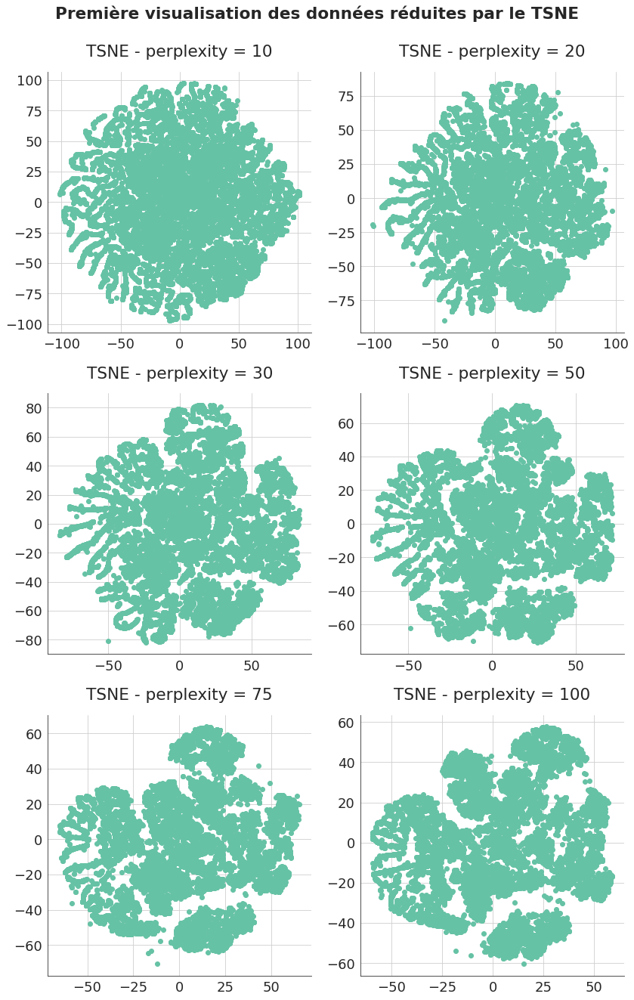

In [ ]:
graph_title = "Première visualisation des données réduites par le TSNE"
graph = sfg.MyGraph(graph_title, nblin=3, nbcol=2)
for i in range(len(list_perplexity)):
    xreduc = X_reduc[i]
    graph.add_scatter(xreduc.iloc[:, 0], xreduc.iloc[:, 1],
                      subtitle="TSNE - perplexity = {}".format(
                          list_perplexity[i]),
                      multi_index=i+1)
fig, ax = graph.fig, graph.ax
plt.show()

Je dois espacer plus mes coefficients de perplexité et chercher dans des coefficients supérieurs. Je choisis de commencer à 50, puis d'appliquer des paliers de 50 ou de 100.

In [ ]:
X_reduc = []
list_perplexity = [50, 100, 200, 300, 400, 500]
for perplexity in list_perplexity:
    reduc = TSNE(perplexity=perplexity, n_jobs=-1, random_state=42)
    embedding = reduc.fit(satisfaction_tsne.values)
    X_reduc.append(pd.DataFrame(embedding.transform(satisfaction_tsne.values),
                                index=satisfaction_tsne.index,
                                columns=["Axe 1", "Axe 2"]))

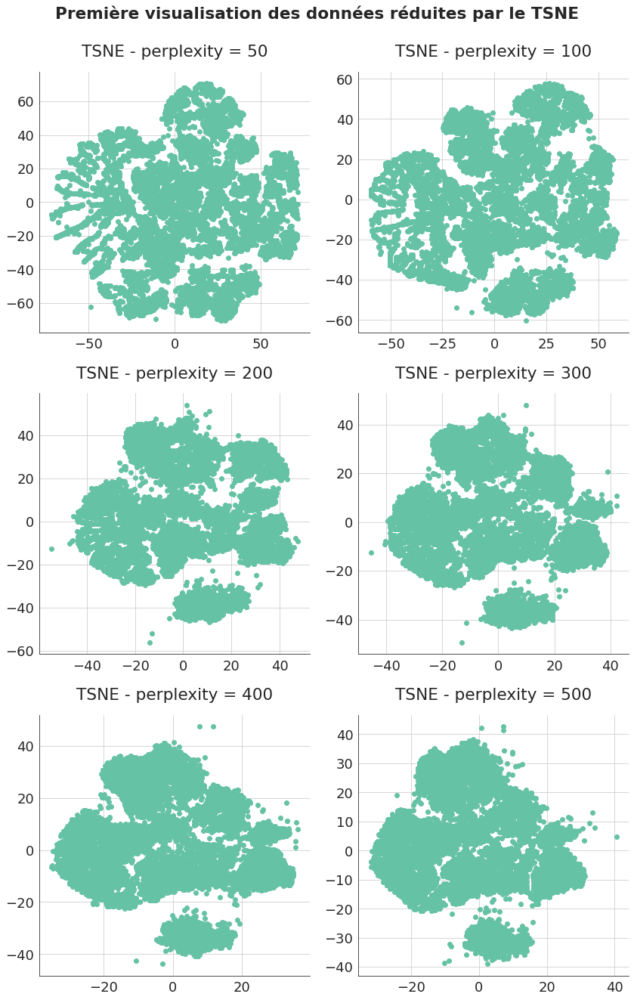

In [ ]:
graph_title = "Première visualisation des données réduites par le TSNE"
graph = sfg.MyGraph(graph_title, nblin=3, nbcol=2)
for i in range(len(list_perplexity)):
    xreduc = X_reduc[i]
    graph.add_scatter(xreduc.iloc[:, 0], xreduc.iloc[:, 1],
                      subtitle="TSNE - perplexity = {}".format(
                          list_perplexity[i]),
                      multi_index=i+1)
fig, ax = graph.fig, graph.ax
plt.show()

J'opte pour une perpléxité de 300.

In [ ]:
reduc = TSNE(perplexity=300, n_jobs=-1, random_state=42)
embedding = reduc.fit(satisfaction_tsne.values)
satisfaction_tsne_reduced = \
    pd.DataFrame(embedding.transform(satisfaction_tsne.values),
                 index=satisfaction_tsne.index,
                 columns=["Axe 1", "Axe 2"])

<a id='4_2'></a>

### 4.2. Essai de clustering avec K-means

In [ ]:
satisfaction_kmeans = sfc.MyKmeans(satisfaction_tsne, random_state=42)

In [ ]:
satisfaction_kmeans.choix_n_clusters(2, 20)

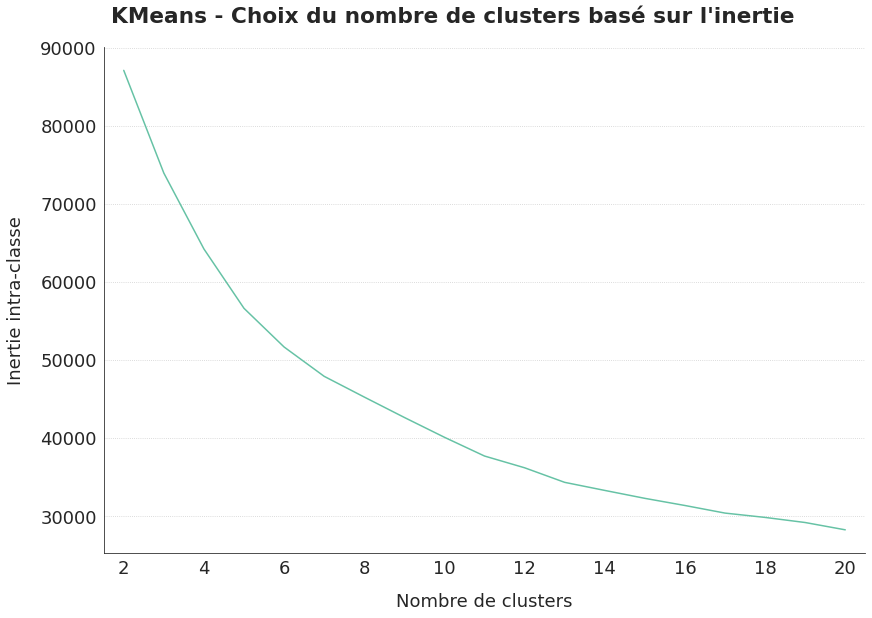

In [ ]:
fig, ax = satisfaction_kmeans.graphique_choix_nclusters()

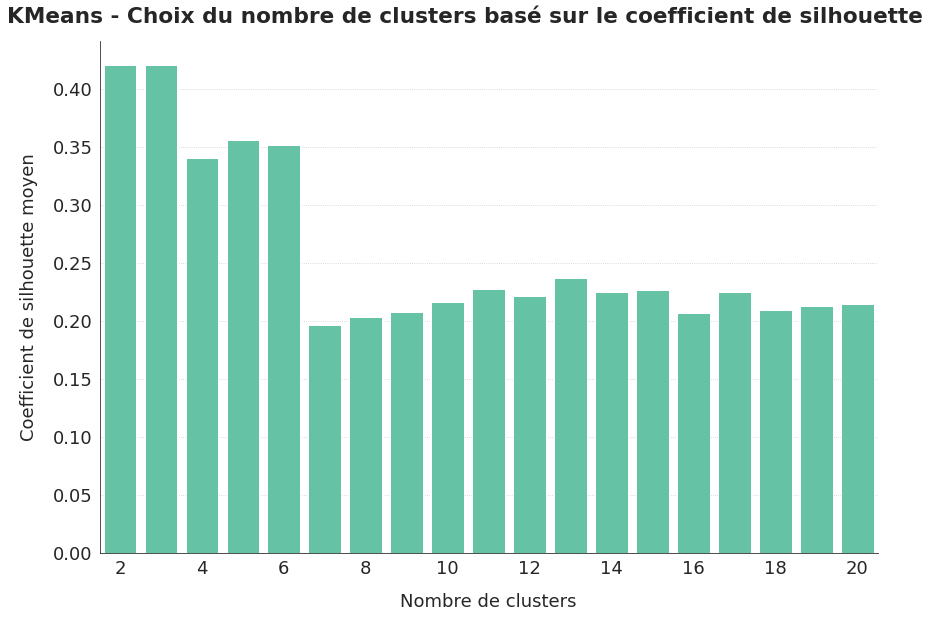

In [ ]:
fig, ax = satisfaction_kmeans.graphique_silhouette_scores()
save_fig("ML04_part2_satisf01_kmeans_nclusters")
plt.show()

Les coefficients de silhouette moyens favorisent entre 2 et 6 clusters.

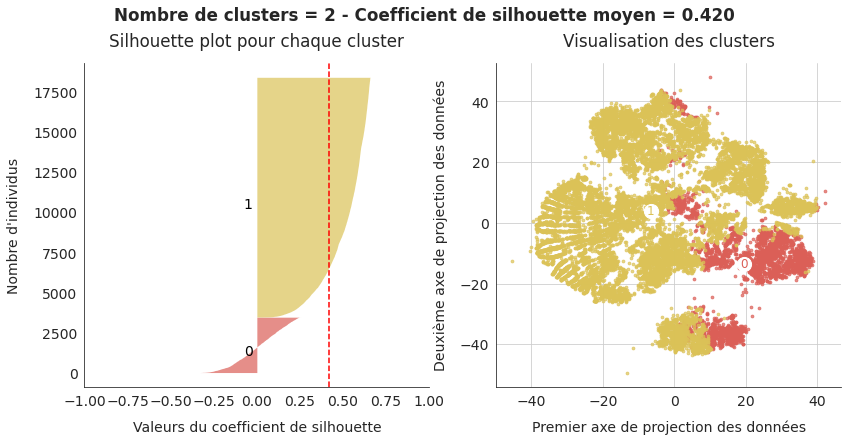

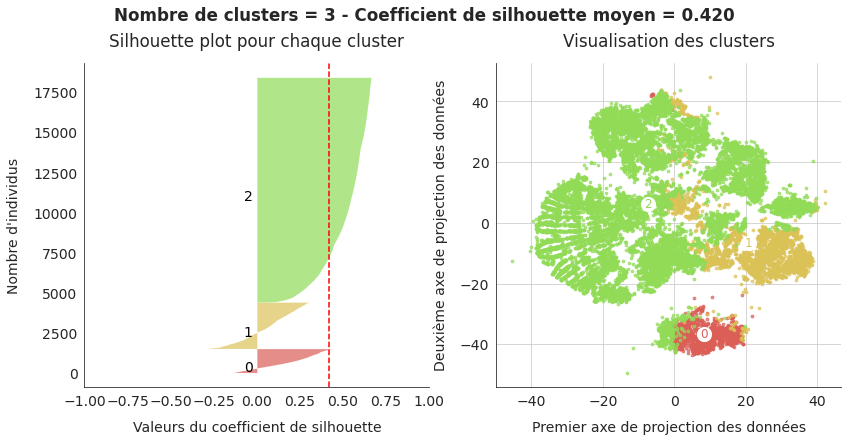

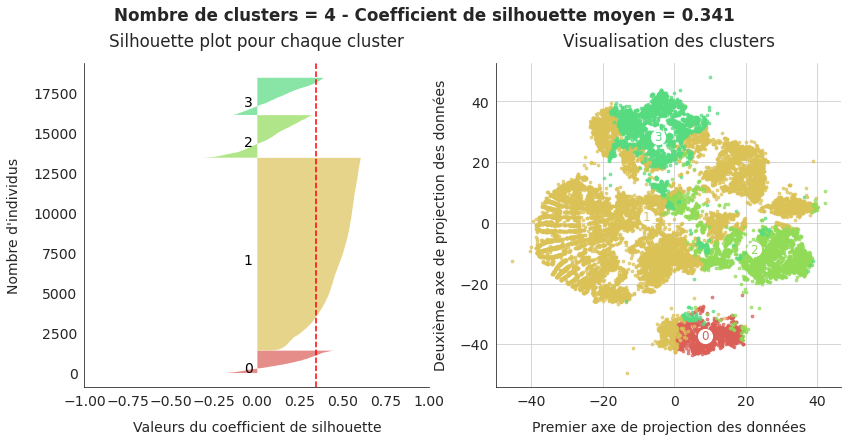

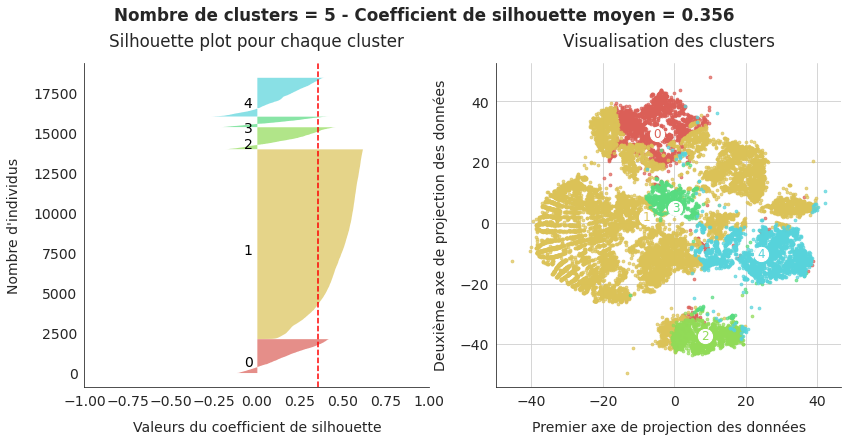

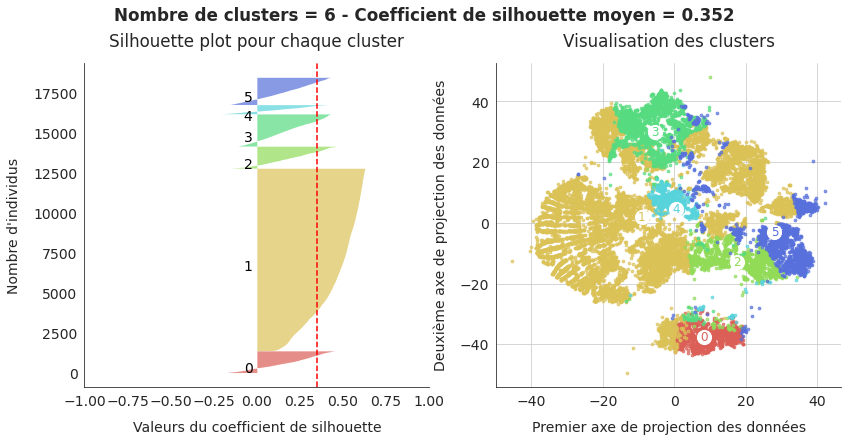

In [ ]:
satisfaction_kmeans.graphique_silhouette_analysis(satisfaction_tsne_reduced,
                                                  min_nclust=2,
                                                  max_nclust=6,
                                                  plt_mult_param=0.8)

Je regarde également le coefficient de silhouette pour un nombre de clusters compris entre 7 et 13.

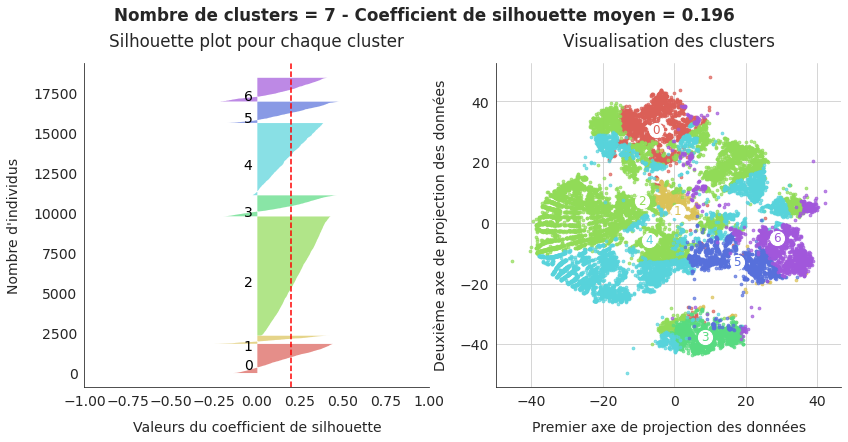

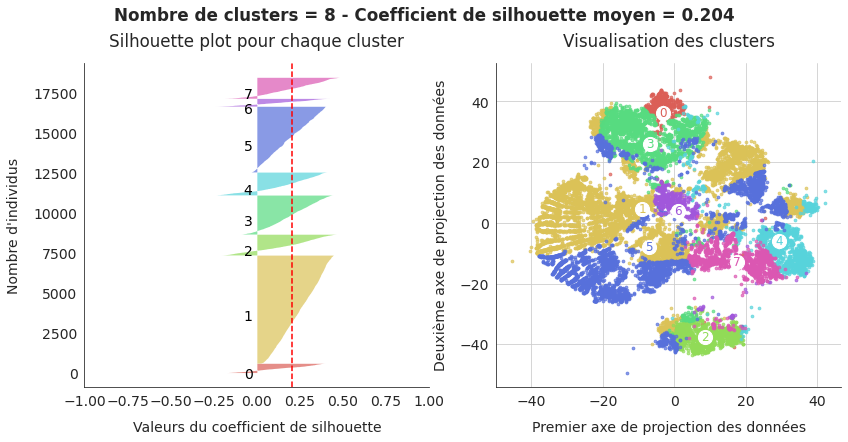

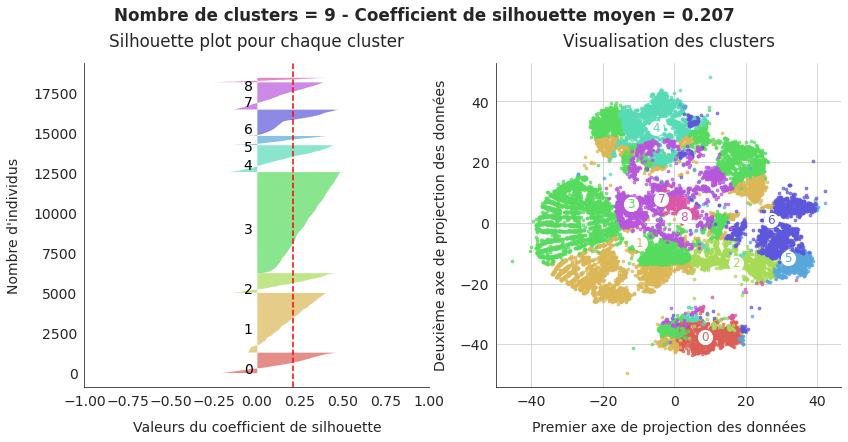

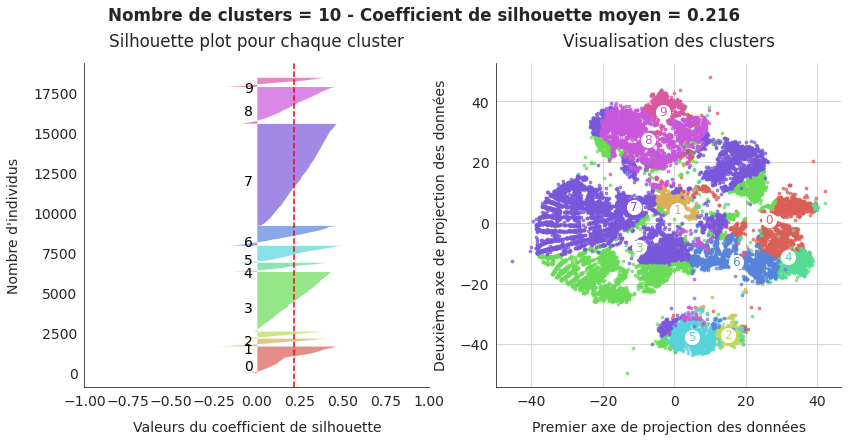

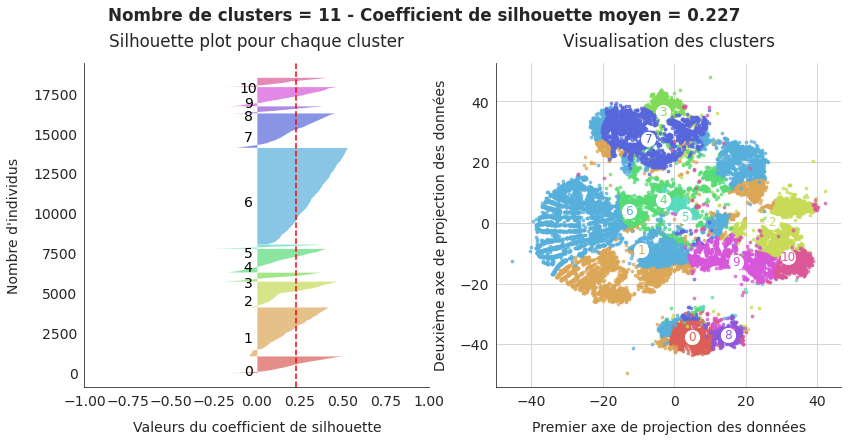

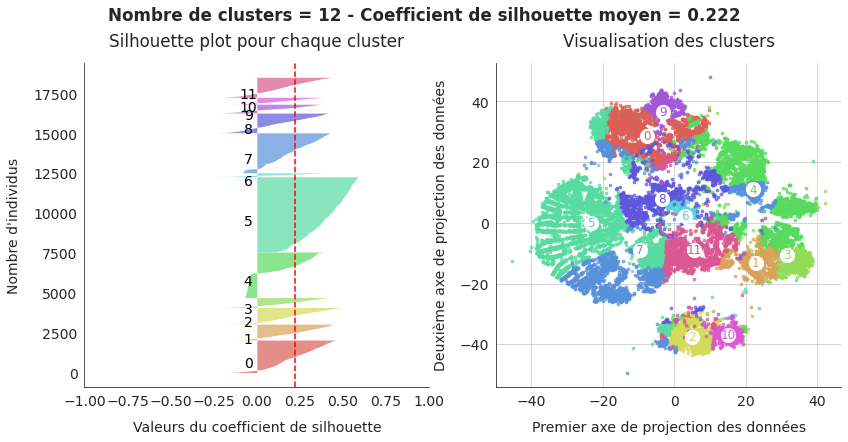

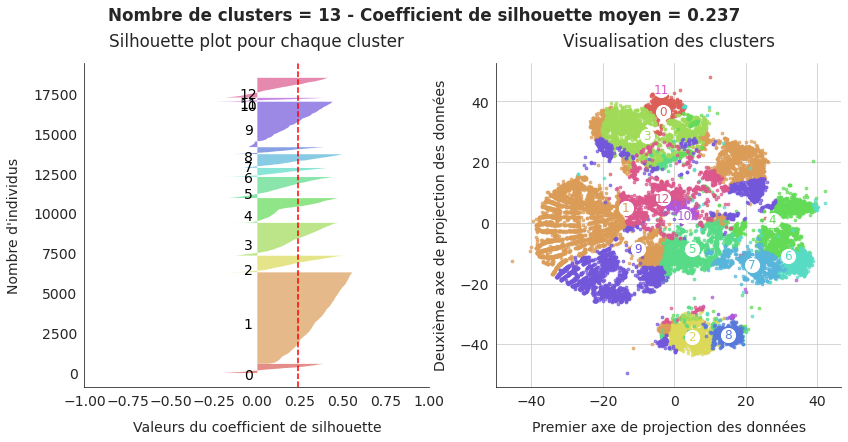

In [ ]:
satisfaction_kmeans.graphique_silhouette_analysis(satisfaction_tsne_reduced,
                                                  min_nclust=7,
                                                  max_nclust=13,
                                                  plt_mult_param=0.8)

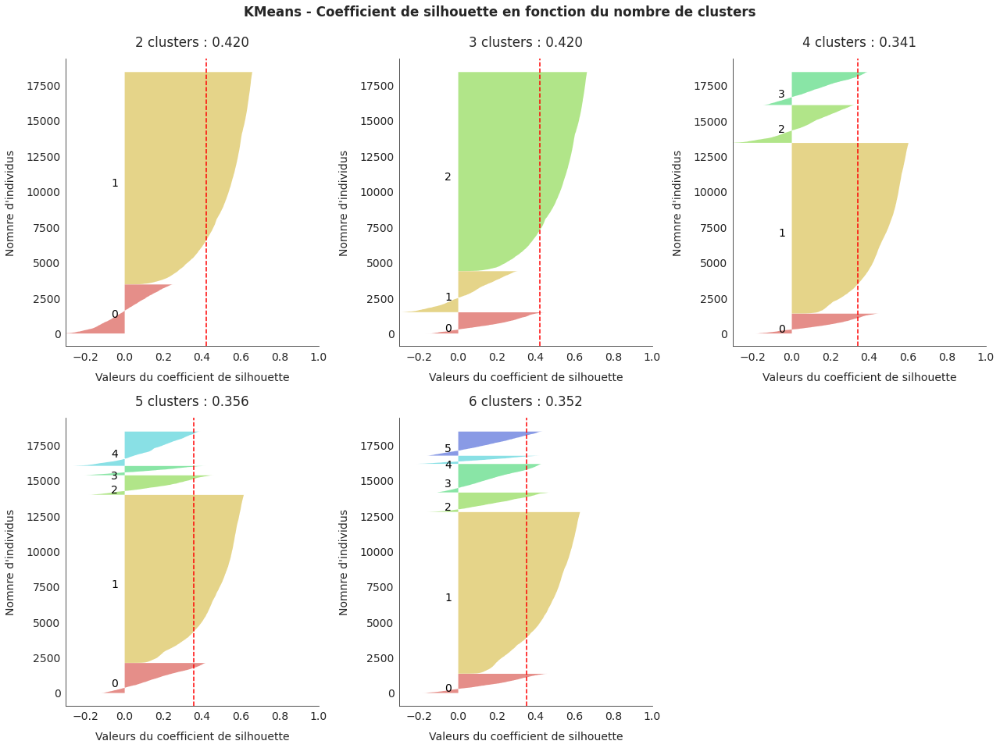

In [ ]:
fig, ax = satisfaction_kmeans.graphique_silhouette_details(min_nclust=2,
                                                           max_nclust=6,
                                                           nbcol=3,
                                                           min_silhouette=-0.3,
                                                           plt_mult_param=0.8,
                                                           figsize=(18, 13))
save_fig("ML04_part2_satisf02_kmeans_silhouette1")
plt.show()

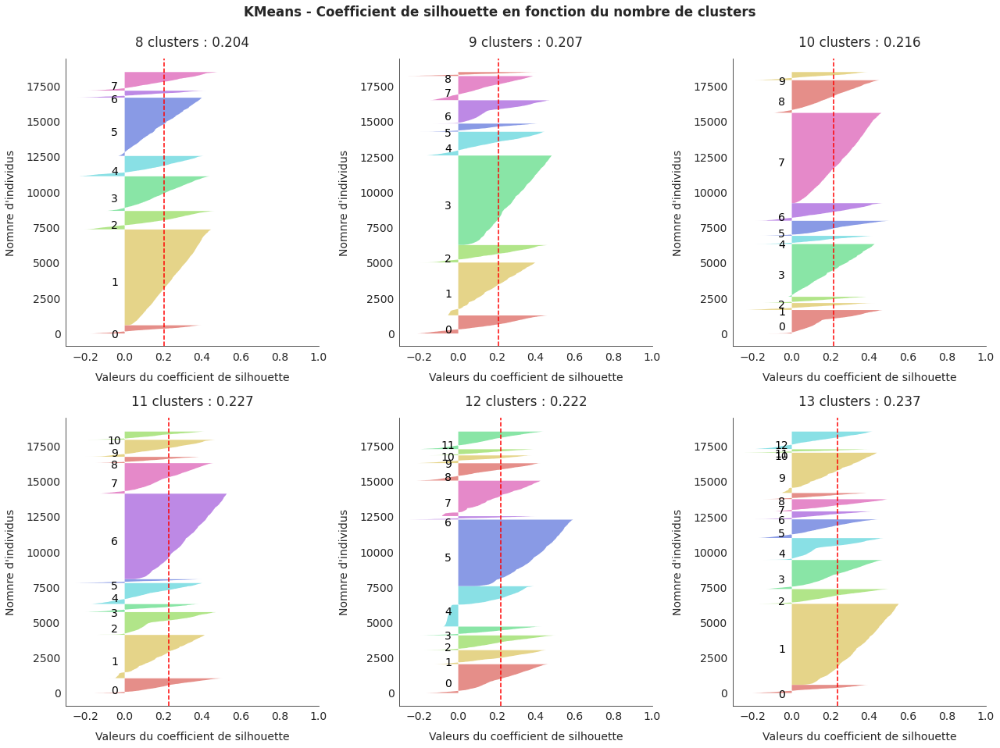

In [ ]:
fig, ax = satisfaction_kmeans.graphique_silhouette_details(min_nclust=8,
                                                           max_nclust=13,
                                                           nbcol=3,
                                                           min_silhouette=-0.3,
                                                           plt_mult_param=0.8,
                                                           figsize=(18, 13))
save_fig("ML04_part2_satisf03_kmeans_silhouette2")
plt.show()

Les segmentations avec plus de clusters voient leur coefficient de silhouette diminuer car les nouveaux clusters sont créés au milieu du gros cluster principal.  
J'examine le graphique en radar des centroïdes pour 5 et pour 6 clusters, qui ont de bons scores de silhouette moyens.  
J'étudie également la segmentation en 11 clusters qui me paraît équilibrée.

**Pour 5 clusters**

In [ ]:
nclust = 5
satisfaction_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust = check_clust.merge(satisfaction_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,2.024821,-0.178470,0.020473,0.231632,-0.232165,-0.228514
cluster_1,-0.332978,-0.156571,-0.174225,0.379099,-0.268317,-0.334630
cluster_2,-0.087894,-0.180985,-0.074652,-0.218449,3.155324,0.855237
cluster_3,0.009971,3.732092,0.635829,-0.503290,-0.121076,0.076909
cluster_4,-0.160623,0.006724,0.631535,-1.779383,-0.255055,1.326979
all_data,-0.008679,-0.001936,-0.009883,0.002795,-0.002234,-0.000913


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

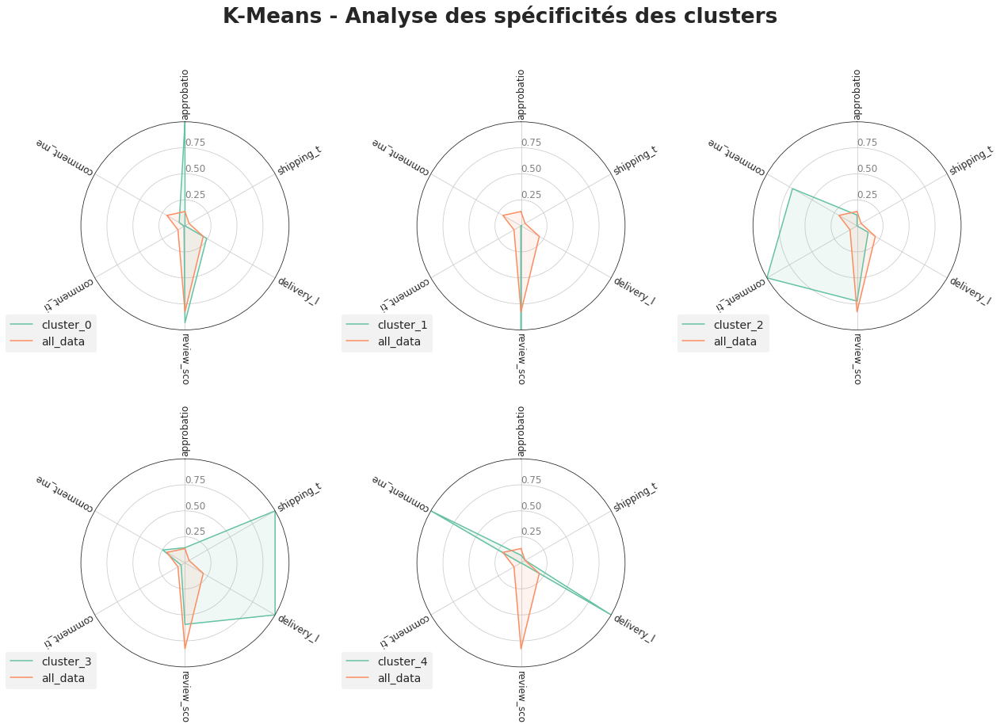

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=3, polar=True, figsize=(18, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
graph.ax[5].set_axis_off()
fig, ax = graph.fig, graph.ax
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 2118 individus
Cluster 1 : 11850 individus
Cluster 2 : 1371 individus
Cluster 3 : 651 individus
Cluster 4 : 2419 individus


Voici l'analyse que l'on peut faire de ces graphiques :
- cluster 0 : le temps d'approbation des commandes est long (très supérieur à la moyenne) mais les clients attribuent malgré tout une note supérieure à la moyenne. Clients satisfaits des articles reçus.
- cluster 1 : les temps de validation et de préparation sont inférieurs à la moyenne, les commandes sont arrivées en avance sur le délai annoncé, et ces clients ont tendance à ne pas laisser de titre ou de message. Ils sont satisfaits du traitement de la commande et des articles reçus. Clients pour qui les commandes se sont bien déroulées et qui ont attribué les meilleures notes. 
- cluster 2 : les notes sont un peu moins bonnes que la moyenne et les clients ont laissé des titres et commentaires plus longs que la moyenne, alors que les délais d'approbation, de préparation et de livraison sont inférieurs à la moyenne. Clients exigeants moyennement satisfaits qui laissent des commentaires sur les articles reçus.
- cluster 3 : mauvaises notes à cause d'un long délai de préparation et/ou d'un retard de livraison. Les titres et commentaires sont dans la moyenne : il ne semble pas y avoir de grief contre les articles. Clients mécontents à cause du délai de préparation et/ou de livraison de la commande, qui ne laissent pas de commentaire particulier.
- cluster 4 : les notes sont les moins bonnes, le retard de livraison supérieur à la moyenne et les messages d'une grande longueur. Clients très mécontents à cause d'un retard de livraison et qui se sont plaints à travers un long message. On peut supposer qu'ils ne sont pas totalement satisfaits des articles non plus.

**Pour 6 clusters**

In [ ]:
nclust = 6
satisfaction_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust = check_clust.merge(satisfaction_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-0.093561,-0.189135,-0.074419,-0.205348,3.159851,0.806608
cluster_1,-0.328974,-0.152141,-0.192724,0.423611,-0.268434,-0.350390
cluster_2,-0.120913,-0.018955,0.066070,-1.258412,-0.213817,2.500919
cluster_3,2.069582,-0.181020,-0.014095,0.273104,-0.231635,-0.257430
cluster_4,0.018772,3.993586,0.648604,-0.568686,-0.082085,0.149401
cluster_5,-0.165303,0.045594,0.991748,-1.767128,-0.272062,-0.060944
all_data,-0.008679,-0.001936,-0.009883,0.002795,-0.002234,-0.000913


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

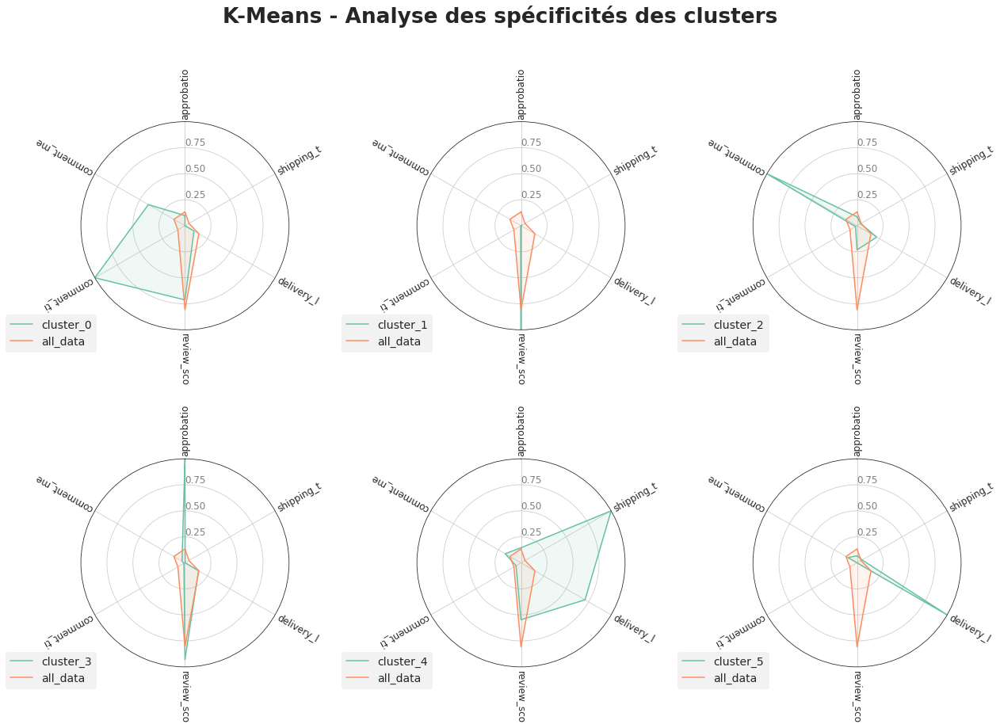

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=3, polar=True, figsize=(18, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf04_kmeans_radar6")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 1357 individus
Cluster 1 : 11407 individus
Cluster 2 : 1368 individus
Cluster 3 : 2008 individus
Cluster 4 : 568 individus
Cluster 5 : 1701 individus


Voici l'analyse que l'on peut faire de ces graphiques :
- cluster 0 : les notes sont un peu moins bonnes que la moyenne et les clients ont laissé des titres et commentaires plus longs que la moyenne, alors que les délais d'approbation, de préparation et de livraison sont inférieurs à la moyenne. Clients exigeants moyennement satisfaits qui laissent des commentaires sur les articles reçus.
- cluster 1 : les temps de validation et de préparation sont inférieurs à la moyenne, les commandes sont arrivées en avance sur le délai annoncé, et ces clients ont tendance à ne pas laisser de titre ou de message. Ils sont satisfaits du traitement de la commande et des articles reçus. Clients pour qui les commandes se sont bien déroulées et qui ont attribué les meilleures notes.
- cluster 3 : le temps d'approbation des commandes est long (très supérieur à la moyenne) mais les clients attribuent malgré tout une note supérieure à la moyenne. Clients satisfaits des articles reçus.
- cluster 4 : mauvaises notes à cause d'un long délai de préparation et/ou d'un retard de livraison. Les titres et commentaires sont dans la moyenne : il ne semble pas y avoir de grief contre les articles. Clients mécontents à cause du délai de préparation et/ou de livraison de la commande, qui ne laissent pas de commentaire particulier.
- cluster 2 et 5 : séparation d'un cluster précédent qui regroupe les notes les moins bonnes. Un cluster regroupe les clients mécontents à cause d'un grand retard de livraison. L'autre cluster regroupe les clients qui ont laissé un très long message, dont on peut déduire qu'ils sont insatisfaits des articles reçus.

La segmentation avec 6 clusters me paraît plus précise, notamment pour identifier la source de mécontentement des clients qui ont attribué les moins bonnes notes.

**Pour 11 clusters**

In [ ]:
nclust = 11
satisfaction_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust = check_clust.merge(satisfaction_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-0.140890,-0.259129,-0.161978,0.453255,2.639642,0.308275
cluster_1,-0.371496,-0.278344,-1.078356,0.471953,-0.275643,-0.310340
cluster_2,-0.226932,-0.126964,-0.023532,-1.511765,-0.271828,-0.148825
cluster_3,3.737689,-0.179600,0.016159,-0.005109,-0.219337,-0.105486
cluster_4,-0.255618,1.417045,0.268496,0.313724,-0.276160,-0.319190
cluster_5,0.114663,5.400740,1.065504,-1.246651,0.058028,0.582860
cluster_6,-0.420475,-0.278752,0.163450,0.476921,-0.285829,-0.364204
cluster_7,1.170595,-0.234031,0.015939,0.416136,-0.267310,-0.314828
cluster_8,0.034668,-0.022690,0.084667,-1.638007,4.001155,1.848853
cluster_9,-0.125860,-0.014775,0.058878,-1.201029,-0.238561,2.611896


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

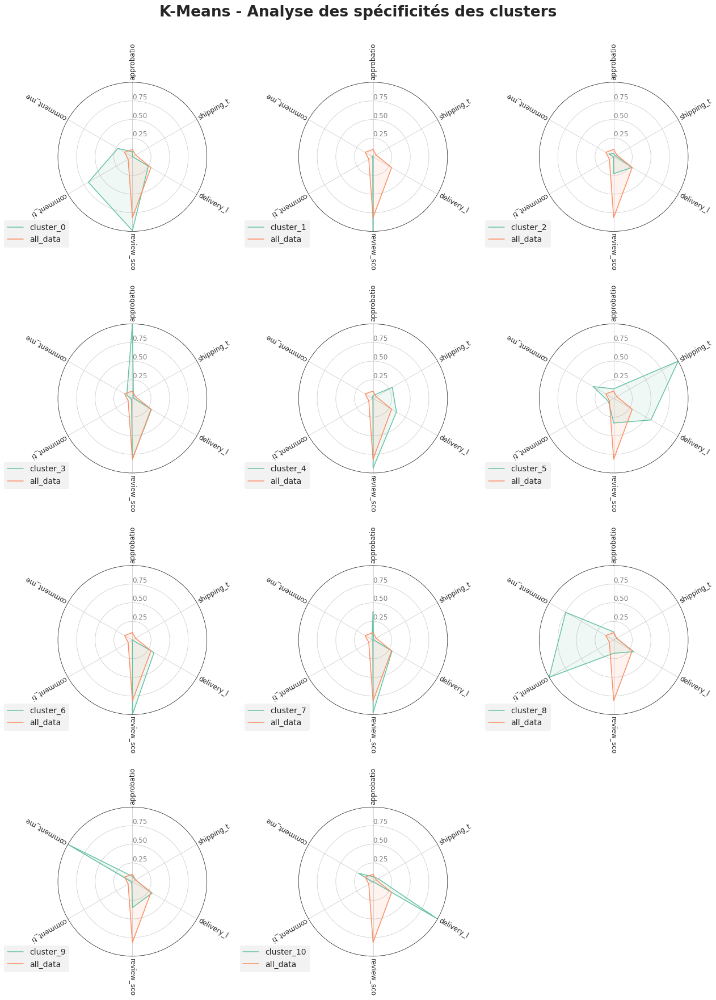

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=4, nbcol=3, polar=True, figsize=(18, 24))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
graph.ax[11].set_axis_off()
fig, ax = graph.fig, graph.ax

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 1041 individus
Cluster 1 : 3060 individus
Cluster 2 : 1607 individus
Cluster 3 : 556 individus
Cluster 4 : 1478 individus
Cluster 5 : 262 individus
Cluster 6 : 6047 individus
Cluster 7 : 2153 individus
Cluster 8 : 433 individus
Cluster 9 : 1199 individus
Cluster 10 : 573 individus


Voici l'analyse que l'on peut faire de ces graphiques :
- cluster 0 : clients satisfaits qui laissent un commentaire
- cluster 1 : clients satisfaits qui ne laissent pas de commentaire
- cluster 2 : clients mécontents de l'article, qui ne laissent pas de commentaire
- cluster 3 : clients dans la moyenne de satisfaction, magré un long délai d'approbation
- cluster 4 : clients satisfaits, malgré un délai de préparation supérieur à la moyenne qui a entraîné un retard de livraison supérieur à la moyenne.
- cluster 5 : clients mécontents à causse d'un long délai de préparation qui a entraîné un retard de livraison. Ils laissent des messages.
- cluster 6 : clients satisfaits malgré un retard de livraison supérieur à la moyenne
- cluster 7 : clients satisfaits malgré un délai d'approbation supérieur à la moyenne
- cluster 8 : clients mécontents qui laissent un commentaire avec un titre
- cluster 9 : clients mécontents qui laissent un commentaire sans titre
- cluster 10 : clients très mécontents à cause d'un très grand retard de livraison

La segmentation sur 11 clusters entre dans des détails de séparation qui ne me paraissent pas pertinents pour définir des cibles pour une campagne marketing. En effet, les clients de différents clusters constituent une cible identique (par exemple, les clusters 8 et 9, ou les clusters 5 et 10).

Je préfère la segmentation avec 6 clusters qui me paraît plus pertinente dans notre contexte.

**Même essai avec K-Means mais sur toutes les données**

Open TSNE est une libraire qui permet de projeter des données qui n'ont pas été utilisées pour le fitting du TSNE.  
Je teste donc de nouveau la classification K-Means, mais sur toutes les données, dans le but de valider la représentativité de mon échantillon de 20% des données.

In [ ]:
satisfaction_scaled_reduced = \
    pd.DataFrame(embedding.transform(satisfaction_scaled.values),
                 index=satisfaction_scaled.index,
                 columns=["Axe 1", "Axe 2"])

In [ ]:
satisfaction_kmeans = sfc.MyKmeans(satisfaction_scaled, random_state=42)

In [ ]:
satisfaction_kmeans.choix_n_clusters(2, 20)

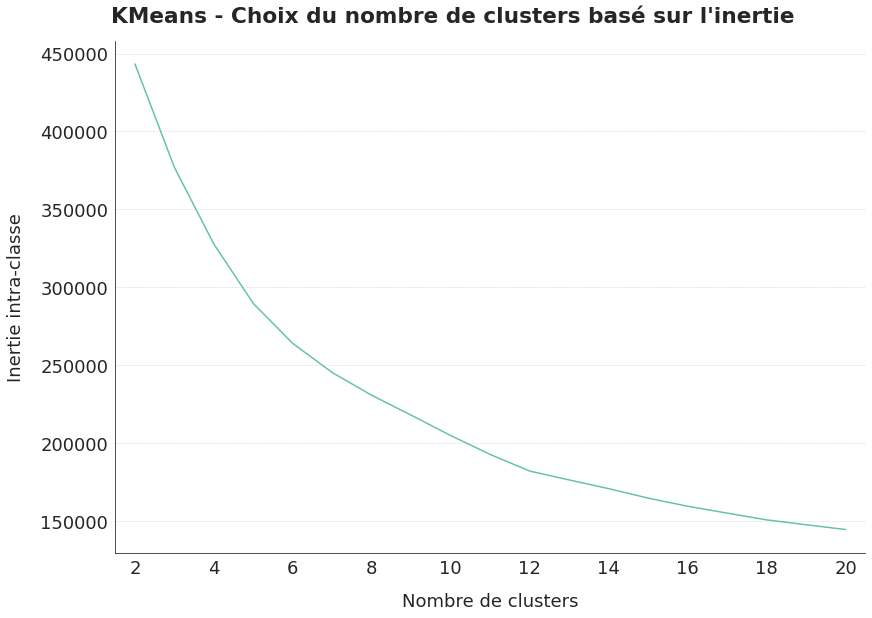

In [ ]:
fig, ax = satisfaction_kmeans.graphique_choix_nclusters()

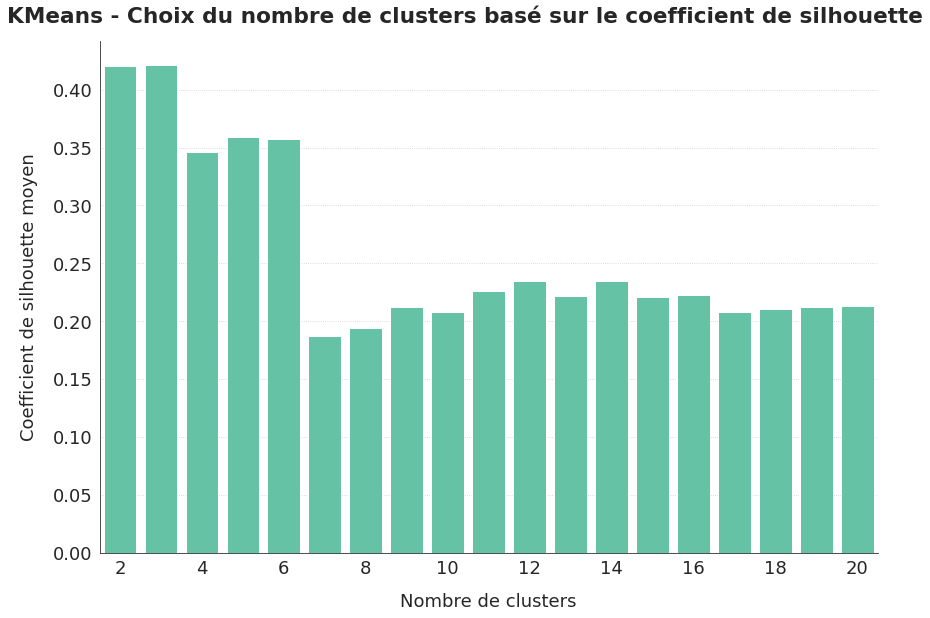

In [ ]:
fig, ax = satisfaction_kmeans.graphique_silhouette_scores()

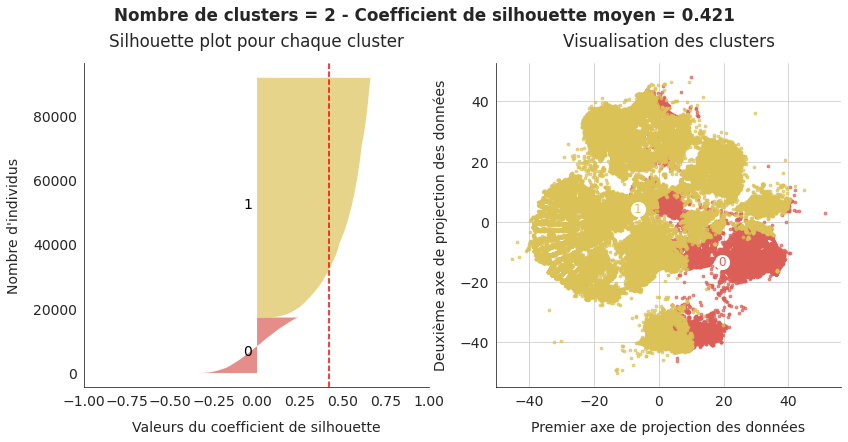

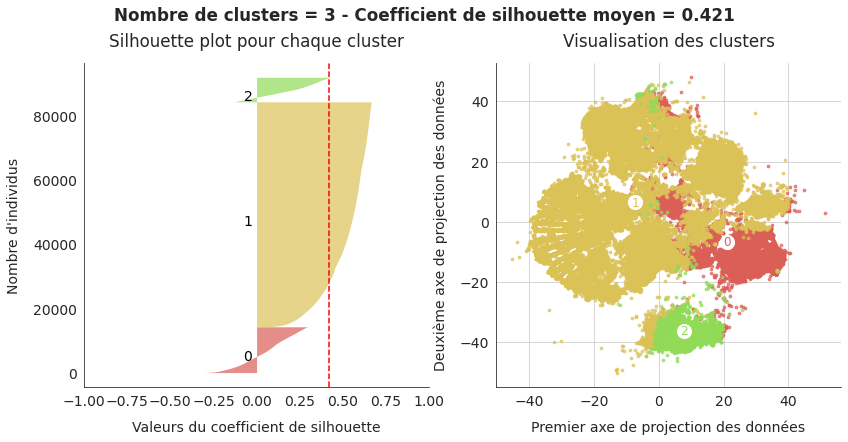

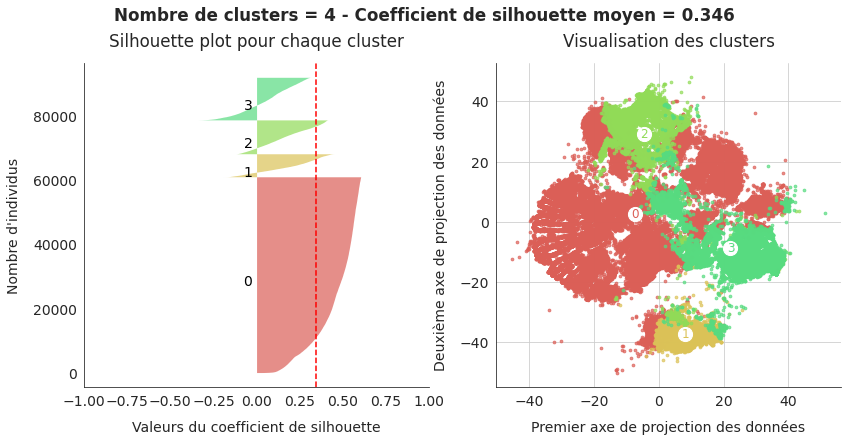

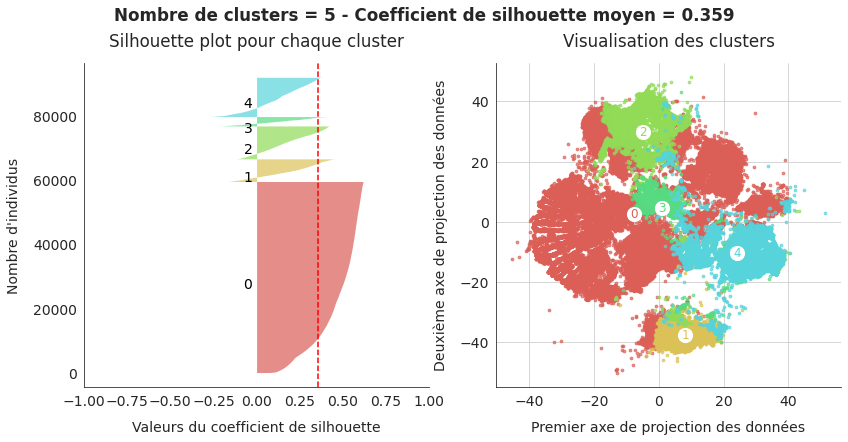

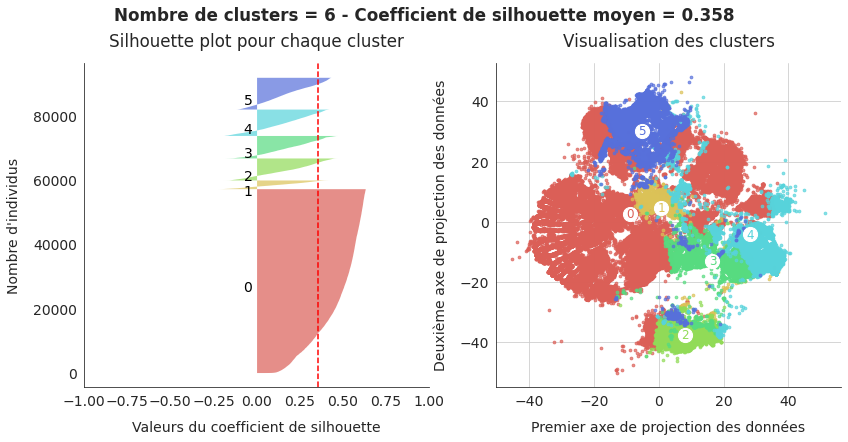

In [ ]:
satisfaction_kmeans.graphique_silhouette_analysis(satisfaction_scaled_reduced,
                                                  min_nclust=2,
                                                  max_nclust=6,
                                                  plt_mult_param=0.8)

J'examine le graphique en radar des centroïdes pour 6 clusters.

Pour 6 clusters

In [ ]:
nclust = 6
satisfaction_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = satisfaction_scaled.copy()
check_clust = check_clust.merge(satisfaction_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-3.225014e-01,-1.465774e-01,-1.836330e-01,4.054127e-01,-2.733315e-01,-3.614212e-01
cluster_1,7.698799e-03,4.073766e+00,6.970470e-01,-6.175374e-01,-7.749591e-02,1.638409e-01
cluster_2,-9.572017e-02,-1.857382e-01,-9.012756e-02,-1.498068e-01,3.143248e+00,7.521896e-01
cluster_3,-1.201128e-01,-1.370906e-02,1.057153e-02,-1.115527e+00,-1.773637e-01,2.487466e+00
cluster_4,-1.215061e-01,5.231084e-02,1.116303e+00,-1.863206e+00,-2.634840e-01,2.674863e-02
cluster_5,2.118471e+00,-1.694680e-01,8.024201e-04,2.614005e-01,-2.276852e-01,-2.546929e-01
all_data,1.324905e-16,7.843098e-17,1.748812e-16,-7.359119e-16,7.570587e-16,-2.577586e-16


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

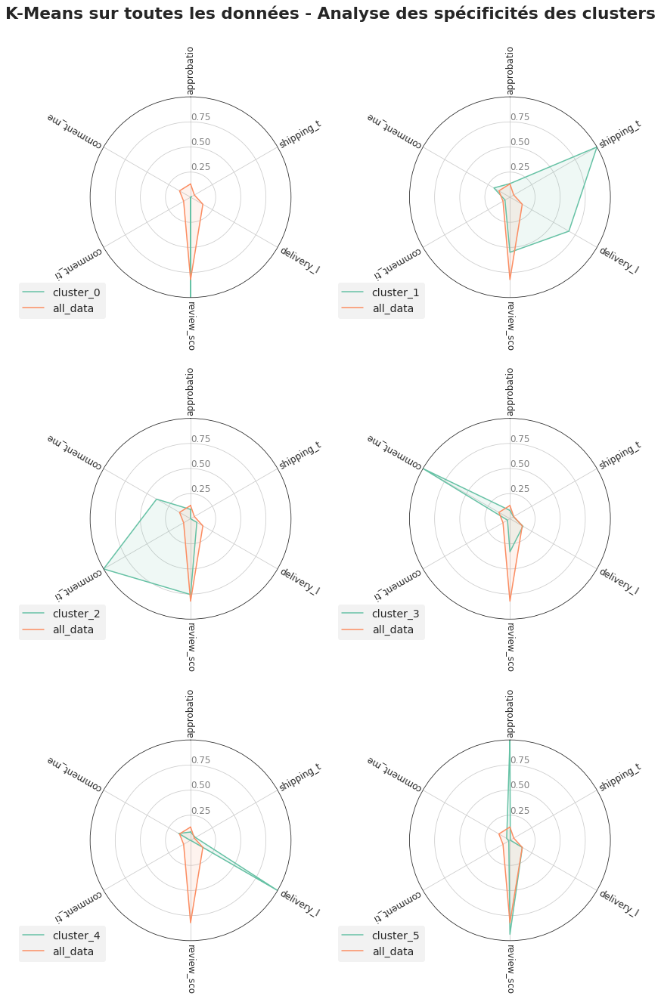

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph_title = ("K-Means sur toutes les données - "
               "Analyse des spécificités des clusters")
graph = sfg.MyGraph(graph_title, nblin=3, nbcol=2, polar=True, figsize=(12, 8))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax

J'obtiens des résultats et un clustering similaire avec toutes les données et avec mon échantillon de 20% des données.  
Pour accélérer les temps de calcul, je continue l'étude sur ma sélection de 20% des clients, stratifiée sur le nombre de commandes.

<a id='4_3'></a>

### 4.3. Essai de clustering avec DBDScan

Je souhaite obtenir également 6 clusters, afin de comparer les clusters obtenus avec ceux du k-means.

In [ ]:
satisfaction_dbscan = DBSCAN(n_jobs=-1).fit(satisfaction_tsne)
np.unique(satisfaction_dbscan.labels_)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29])

Je change epsilon afin d'obtenir seulement 6 clusters (valeur d'epsilon obtenue grâce à quelques tatonnements).

In [ ]:
satisfaction_dbscan = DBSCAN(eps=0.95, n_jobs=-1).fit(satisfaction_tsne)
np.unique(satisfaction_dbscan.labels_)

array([-1,  0,  1,  2,  3,  4,  5])

In [ ]:
sil_score = silhouette_score(satisfaction_tsne, satisfaction_dbscan.labels_)
sil_values = silhouette_samples(satisfaction_tsne, satisfaction_dbscan.labels_)

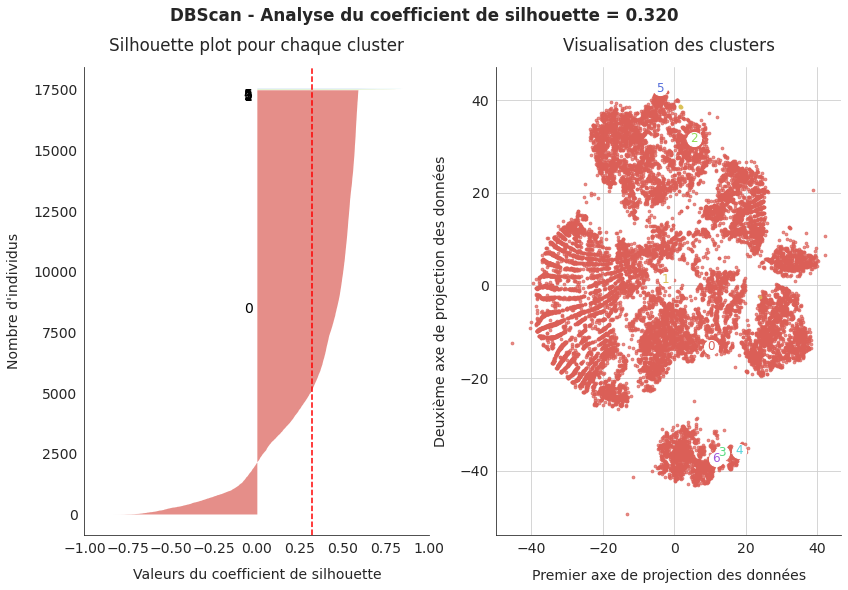

In [ ]:
graph_title = "DBScan - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(7, satisfaction_dbscan.labels_,
                                sil_score, sil_values,
                                satisfaction_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf05_dbscan_silhouette")
plt.show()

In [ ]:
np.unique(satisfaction_dbscan.labels_[satisfaction_dbscan.labels_ >= 0])

array([0, 1, 2, 3, 4, 5])

In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust["cluster"] = satisfaction_dbscan.labels_
check_clust = check_clust[check_clust.cluster >= 0].copy()
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-0.064338,-0.080543,-0.037446,0.057651,-0.087856,-0.063498
cluster_1,3.161856,-0.431411,1.555553,-2.427618,-0.315444,-0.312594
cluster_2,-0.490086,-0.648806,-0.524431,-0.880551,4.050772,3.414701
cluster_3,0.585794,-0.545847,-0.453047,-2.272911,2.691751,0.508862
cluster_4,6.390264,0.571688,0.078641,0.666516,-0.315444,-0.531603
cluster_5,-0.475077,-0.221778,0.945096,0.666516,4.912449,3.116241
all_data,-0.061517,-0.080910,-0.036927,0.056053,-0.083888,-0.061057


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

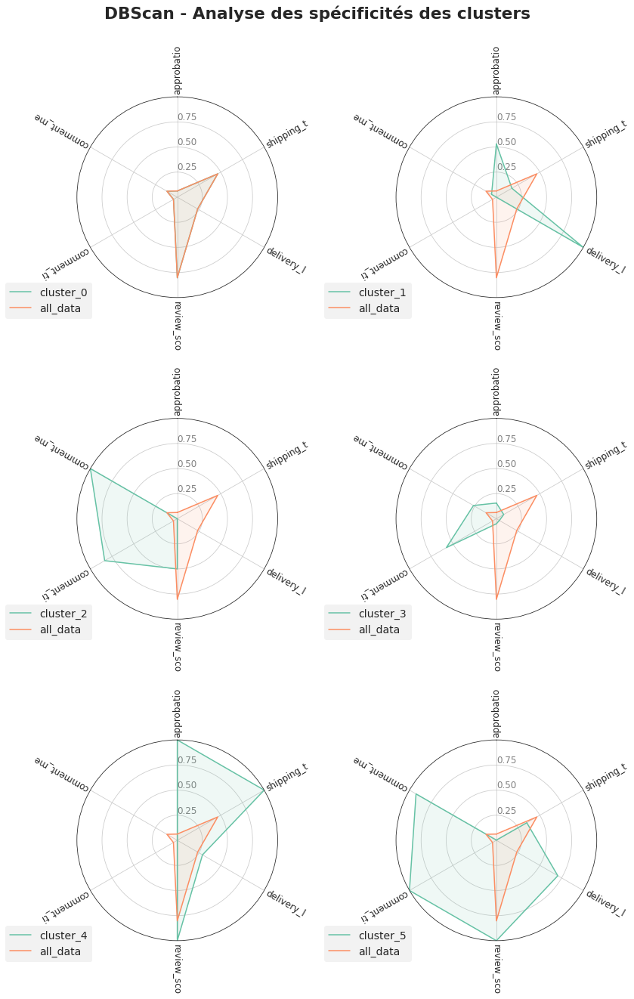

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("DBScan - Analyse des spécificités des clusters",
                    nblin=3, nbcol=2, polar=True, figsize=(12, 8))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 17486 individus
Cluster 1 : 6 individus
Cluster 2 : 8 individus
Cluster 3 : 5 individus
Cluster 4 : 5 individus
Cluster 5 : 5 individus


Sur ce jeu de données, le DBSCAN détecte les clients atypiques plus qu'il n'effectue une segmentation : chaque cluster, à part le principal, comporte trop peu d'individus  pour présenter un intérêt.

<a id='4_4'></a>

### 4.4. Essai de clustering avec MeanShift

In [ ]:
satisfaction_meanshift = MeanShift(n_jobs=-1).fit(satisfaction_tsne)
np.unique(satisfaction_meanshift.labels_)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41])

Je cherche le bandwidth qui me permet d'obtenir 6 clusters (quelques tatonnements ici).

In [ ]:
satisfaction_meanshift = \
    MeanShift(bandwidth=3.75, n_jobs=-1).fit(satisfaction_tsne)
np.unique(satisfaction_meanshift.labels_)

array([0, 1, 2, 3, 4, 5])

In [ ]:
sil_score = silhouette_score(satisfaction_tsne, satisfaction_meanshift.labels_)
sil_values = silhouette_samples(satisfaction_tsne,
                                satisfaction_meanshift.labels_)

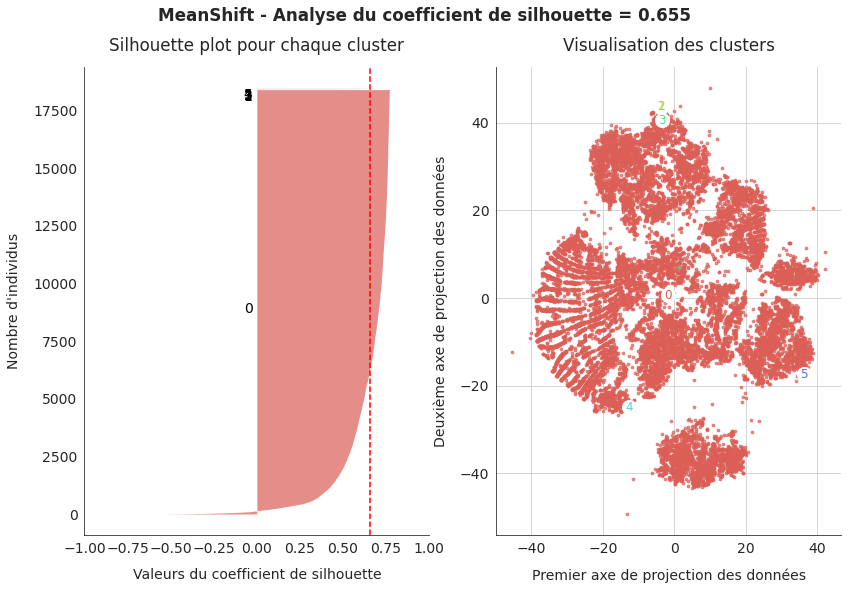

In [ ]:
graph_title = "MeanShift - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, satisfaction_meanshift.labels_,
                                sil_score, sil_values,
                                satisfaction_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf06_meanshift_silhouette")
plt.show()

In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust["cluster"] = satisfaction_meanshift.labels_
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-0.019410,-0.002302,-0.012981,0.003414,-0.001791,-0.000769
cluster_1,15.227879,-0.432233,0.767866,0.279749,-0.315444,0.865355
cluster_2,38.422120,-0.440715,1.850935,-0.880551,-0.315444,-0.585491
cluster_3,7.955391,0.366946,0.454023,-0.638822,-0.315444,-0.281073
cluster_4,0.485253,0.758834,-9.619744,-0.107018,-0.315444,0.948261
cluster_5,-0.017987,0.120074,13.055770,-0.107018,-0.315444,-0.241433
all_data,-0.008679,-0.001936,-0.009883,0.002795,-0.002234,-0.000913


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

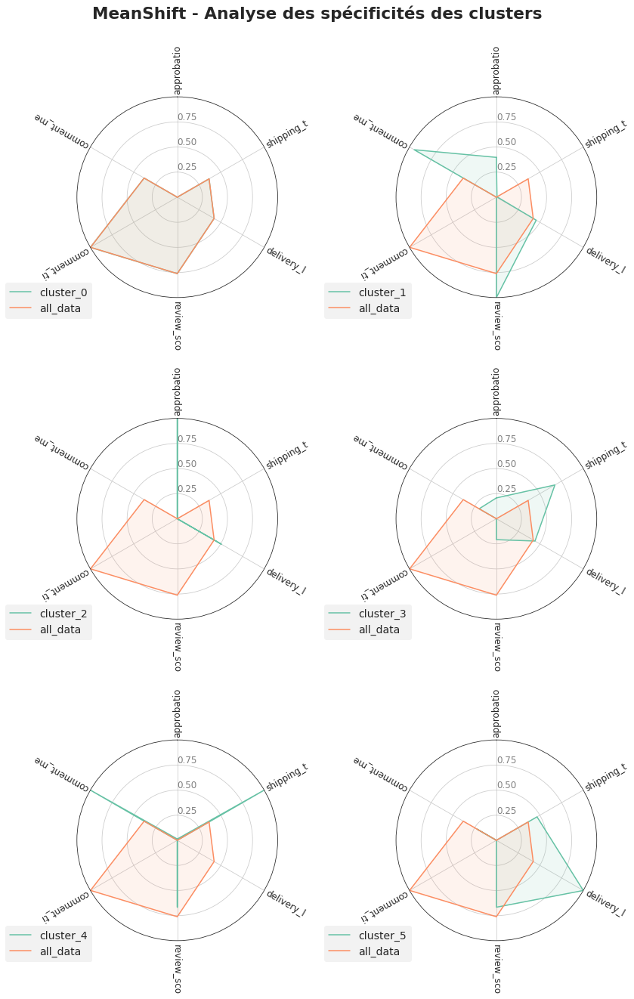

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("MeanShift - Analyse des spécificités des clusters",
                    nblin=3, nbcol=2, polar=True, figsize=(12, 8))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 18383 individus
Cluster 1 : 2 individus
Cluster 2 : 1 individus
Cluster 3 : 16 individus
Cluster 4 : 2 individus
Cluster 5 : 5 individus


On retrouve le même genre de segmentation peu intéressante qu'avec DBScan.

<a id='4_5'></a>

### 4.5. Essai de clustering avec GMM

In [ ]:
satisfaction_gmm = GaussianMixture(n_components=nclust, random_state=42)
gmm_labels = satisfaction_gmm.fit_predict(satisfaction_tsne)

In [ ]:
sil_score = silhouette_score(satisfaction_tsne, gmm_labels)
sil_values = silhouette_samples(satisfaction_tsne, gmm_labels)

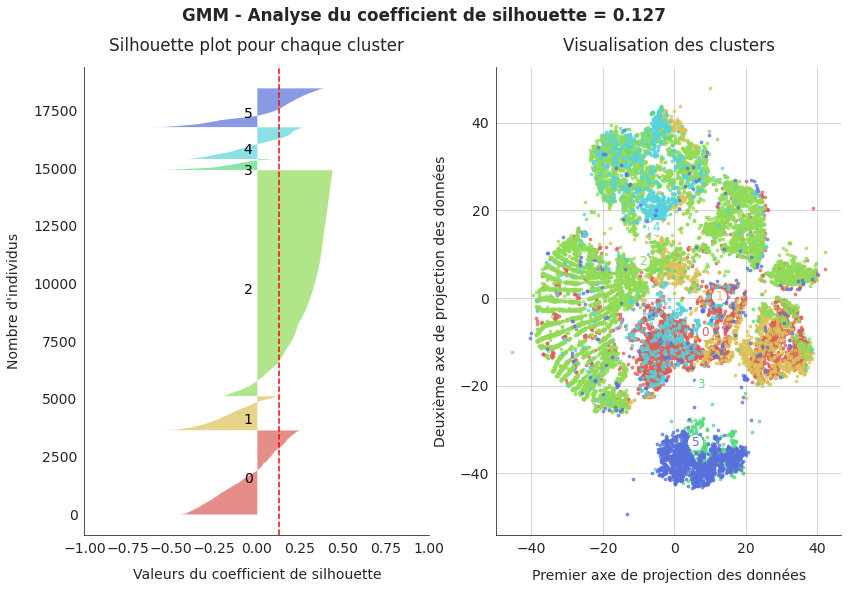

In [ ]:
graph_title = "GMM - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, gmm_labels,
                                sil_score, sil_values,
                                satisfaction_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf07_gmm_silhouette")
plt.show()

In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust["cluster"] = gmm_labels
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-0.494430,-0.083796,0.042912,-0.432916,-0.315444,0.706345
cluster_1,0.667637,1.277306,0.575000,-1.241885,-0.315444,1.044822
cluster_2,-0.086728,-0.108307,-0.092939,0.305085,-0.315444,-0.585491
cluster_3,1.131096,0.837766,0.202774,-0.455606,2.556978,0.783562
cluster_4,1.061649,-0.251541,-0.107140,0.522520,-0.315444,0.213607
cluster_5,-0.280551,-0.349817,-0.130263,-0.025088,2.321437,0.566794
all_data,-0.008679,-0.001936,-0.009883,0.002795,-0.002234,-0.000913


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

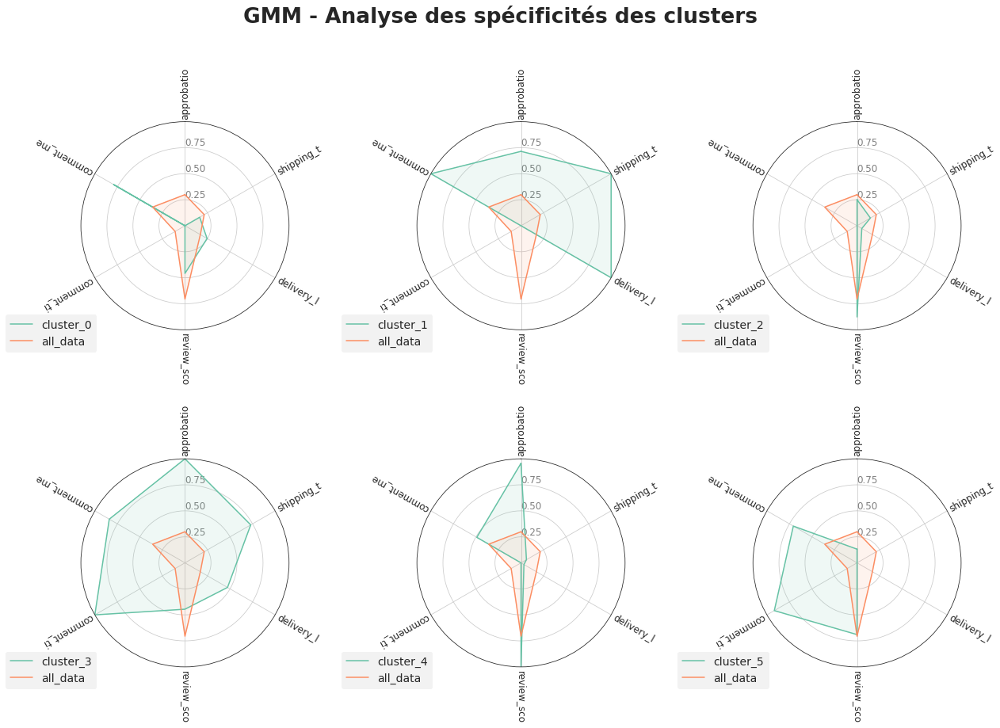

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("GMM - Analyse des spécificités des clusters",
                    nblin=2, nbcol=3, polar=True, figsize=(18, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf08_gmm_radar6")
plt.show()

- Cluster 0 : clients peu satisfaits de leur article ayant laissé un commentaire plus long que la moyenne ;
- Cluster 1 : clients mécontents à cause d'un retard de livraison (dû à un délai trop long de traitement du vendeur) ayant laissé un long message de commentaire ;
- Cluster 2 : clients contents n'ayant pas laissé de commentaire ;
- Cluster 3 : clients mécontents à cause d'un délai trop long de traitement de la commande ayant laissé un long titre de commentaire ;
- Cluster 4 : clients satisfaits malgré un lng délai d'approbation de la commande ;
- Cluster 5 : clients dans la moyenne de la satisfaction ayant tendance à laisser de longs titres de commentaires.

La segmentation du GMM me paraît moins pertinente et précise que celle du kmeans, du point de vue interprétation métier.

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 3642 individus
Cluster 1 : 1465 individus
Cluster 2 : 9786 individus
Cluster 3 : 466 individus
Cluster 4 : 1371 individus
Cluster 5 : 1679 individus


<a id='4_6'></a>

### 4.6. Essai de clustering hiérarchique

In [ ]:
satisfaction_agglo = AgglomerativeClustering(n_clusters=nclust, linkage="ward")
agglo_labels = satisfaction_agglo.fit_predict(satisfaction_tsne)

In [ ]:
sil_score = silhouette_score(satisfaction_tsne, agglo_labels)
sil_values = silhouette_samples(satisfaction_tsne, agglo_labels)

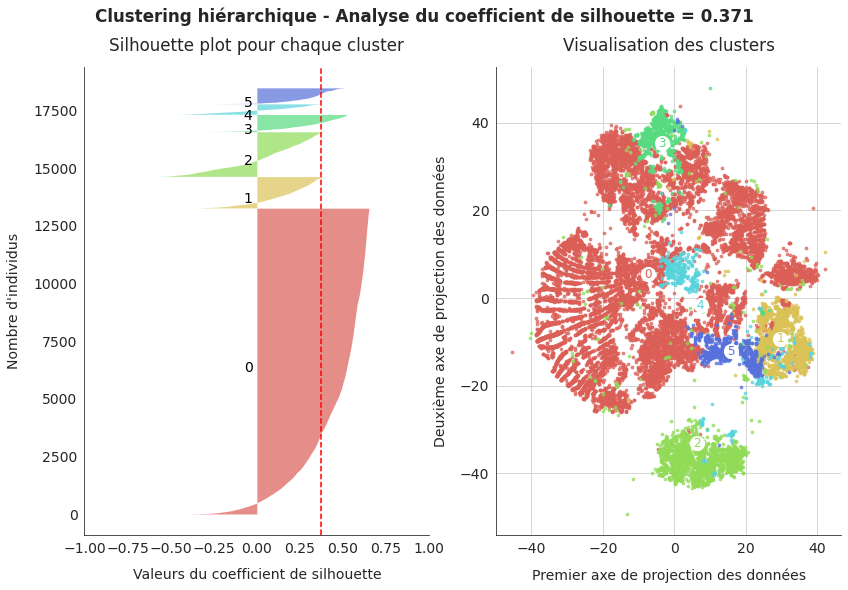

In [ ]:
graph_title = \
    "Clustering hiérarchique - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, agglo_labels,
                                sil_score, sil_values,
                                satisfaction_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf09_agglo_silhouette")
plt.show()

In [ ]:
check_clust = satisfaction_tsne.copy()
check_clust["cluster"] = agglo_labels
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_approbation_time,average_shipping_time,average_delivery_lag,average_review_score,average_comment_title_length,average_comment_message_length
cluster_0,-0.161582,-0.085605,-0.132429,0.345265,-0.310842,-0.311103
cluster_1,-0.196030,-0.024117,0.989476,-2.234140,-0.306409,0.531148
cluster_2,-0.054763,-0.225356,-0.089094,-0.089010,2.510291,0.622540
cluster_3,3.150488,-0.322878,-0.036764,0.069835,-0.307283,-0.197926
cluster_4,-0.049005,4.055536,0.978682,-1.362291,0.149772,0.765708
cluster_5,0.076951,-0.029658,-0.016753,-1.104989,-0.293325,2.892768
all_data,-0.008679,-0.001936,-0.009883,0.002795,-0.002234,-0.000913


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

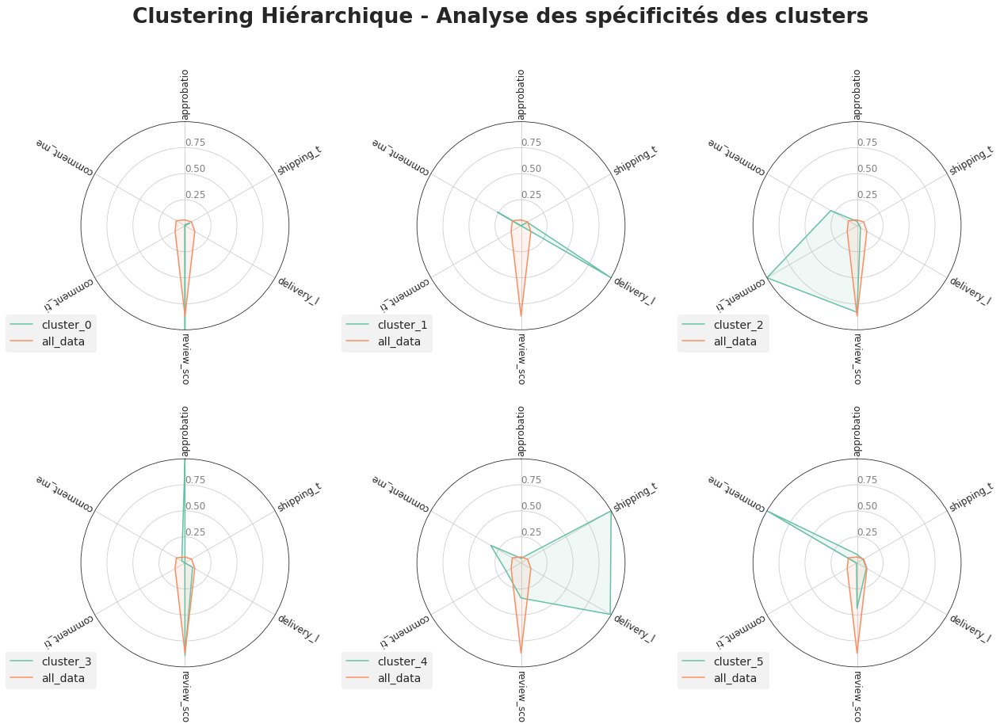

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph_title = "Clustering Hiérarchique - Analyse des spécificités des clusters"
graph = sfg.MyGraph(graph_title, nblin=2, nbcol=3,
                    polar=True, figsize=(18, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_satisf10_agglo_radar6")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 13247 individus
Cluster 1 : 1357 individus
Cluster 2 : 1933 individus
Cluster 3 : 737 individus
Cluster 4 : 450 individus
Cluster 5 : 685 individus


- Cluster 0 : clients satisfaits de leur commande qui ne laissent pas ou peu de titre et de message de commentaire ;
- Cluster 1 : clients mécontents à cause d'un retard de livraison (dû au transporteur et non pas au vendeur), qui ont tendance à laisser un message de commentaire plus long que la moyenne ;
- Cluster 2 : clients dans la moyenne de la satisfaction, laissant de très longs titres de commentaire et des messages plus longs que la moyenne ;
- Cluster 3 : clients dans la moyenne de la satisfaction malgré un délai d'approbation plus long que le moyenne ;
- Cluster 4 : clients mécontents à cause d'un délai d'expédition de la commande trop long ayant entraîné un grand retard de livraison ;
- Cluster 5 : clients mécontents des articles reçus ayant laissé un long message de commentaire.

La segmentation du Hiérarchical Clustering est intéressante. Cependant le K-means présente deux avantages :
- la répartition des individus entre les clusters est plus équilibrée ;
- il permet de prédire l'appartenance à un cluster pour de nouveaux points sans nécessiter un ré-apprentissage.

---
<a id='5_0'></a>

## <font color=blue>5. Clustering sur le type de produits achetés</font>

Je vais essayer de segmenter la clientèle sur la base du type de produits achetés grâce aux variables :
- prix moyen (average_item_price) ;
- dimensions moyennes du produit (average_weight_g, average_volume_cm3) ;
- précision de la description (average_name_lenght, average_description_lenght, average_photos_qty ) ;  
- distance du vendeur (average_distance_customer_seller).

### 5.1. Préparation des données

In [ ]:
data_products = data[["average_item_price",
                      "average_weight_g",
                      "average_volume_cm3",
                      "average_name_lenght",
                      "average_description_lenght",
                      "average_photos_qty",
                      "average_distance_customer_seller"]].copy()
products_scaled = pd.DataFrame(StandardScaler().fit_transform(data_products),
                               index=data_products.index,
                               columns=data_products.columns)

Il n'est pas nécessaire de faire une réduction de dimension au préalable de la segmentation car nous n'avons que 7 variables.  
Il faut effectuer la segmentation sur les valeurs standardisées.

In [ ]:
products_tsne = products_scaled.iloc[selected_indices].copy()

In [ ]:
X_reduc = []
list_perplexity = [50, 100, 200, 300, 400, 500]
for perplexity in list_perplexity:
    reduc = TSNE(perplexity=perplexity, n_jobs=-1, random_state=42)
    embedding = reduc.fit(products_tsne.values)
    X_reduc.append(pd.DataFrame(embedding.transform(products_tsne.values),
                                index=products_tsne.index,
                                columns=["Axe 1", "Axe 2"]))

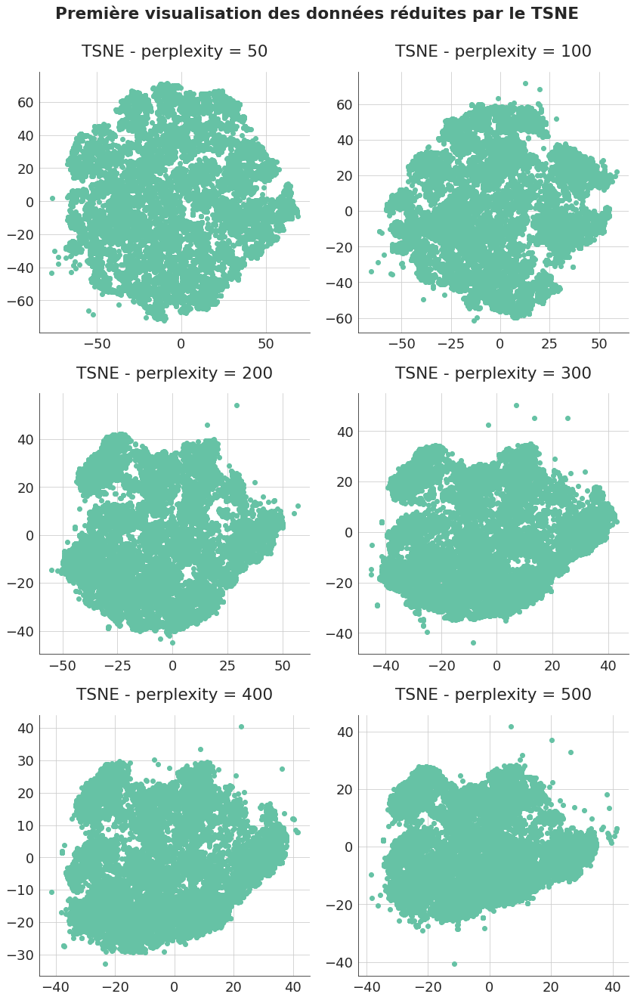

In [ ]:
graph_title = "Première visualisation des données réduites par le TSNE"
graph = sfg.MyGraph(graph_title, nblin=3, nbcol=2)
for i in range(len(list_perplexity)):
    xreduc = X_reduc[i]
    graph.add_scatter(xreduc.iloc[:, 0], xreduc.iloc[:, 1],
                      subtitle="TSNE - perplexity = {}".format(
                          list_perplexity[i]),
                      multi_index=i+1)
fig, ax = graph.fig, graph.ax
plt.show()

Je choisis une perplexité de 100.

In [ ]:
reduc = TSNE(perplexity=100, n_jobs=-1, random_state=42)
embedding = reduc.fit(products_tsne.values)
products_tsne_reduced = pd.DataFrame(embedding.transform(products_tsne.values),
                                     index=products_tsne.index,
                                     columns=["Axe 1", "Axe 2"])

<a id='5_2'></a>

### 5.2. Clustering avec K-means

In [ ]:
products_kmeans = sfc.MyKmeans(products_tsne, random_state=42)

In [ ]:
products_kmeans.choix_n_clusters(2, 20)

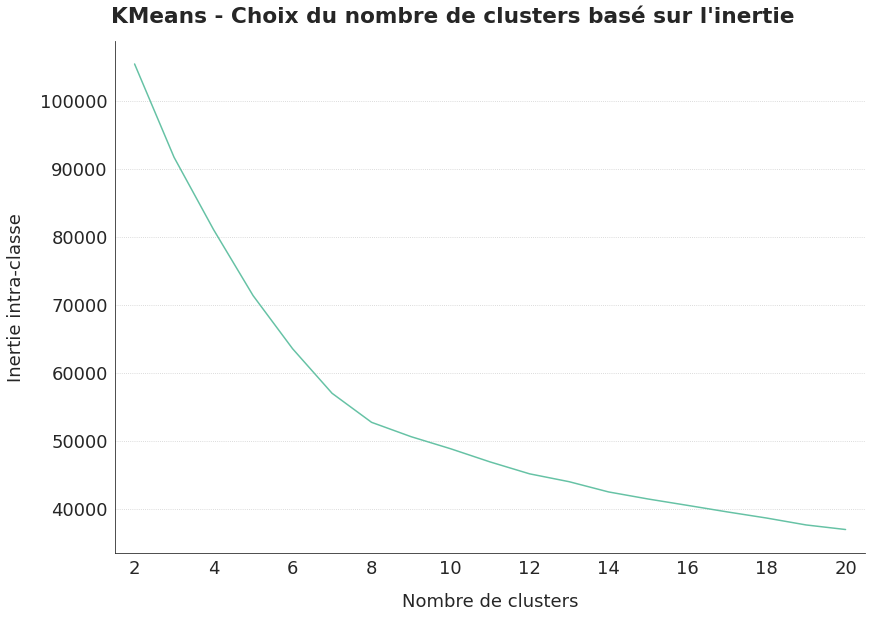

In [ ]:
fig, ax = products_kmeans.graphique_choix_nclusters()

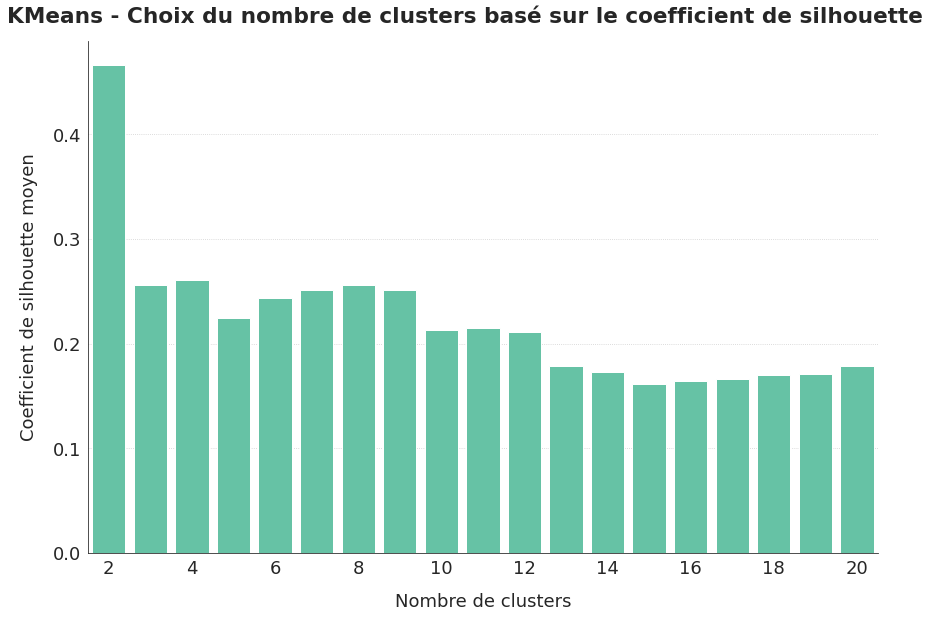

In [ ]:
fig, ax = products_kmeans.graphique_silhouette_scores()
save_fig("ML04_part2_produits01_kmeans_nclusters")
plt.show()

Les coefficients de silhouette moyens favorisent entre 2 et 9 clusters.

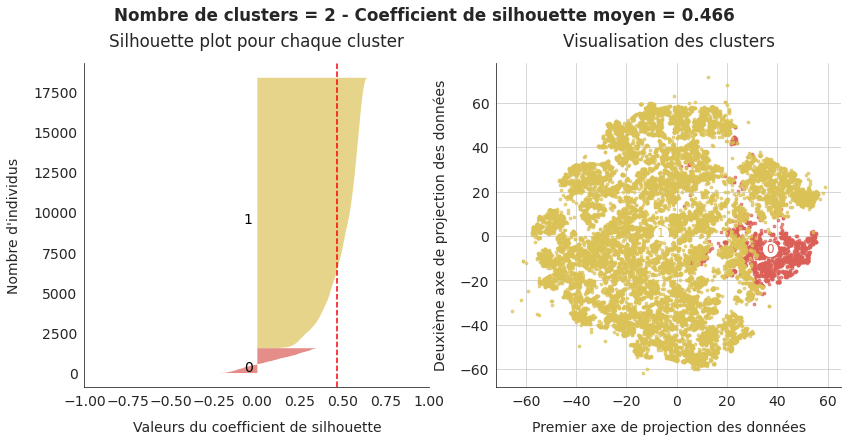

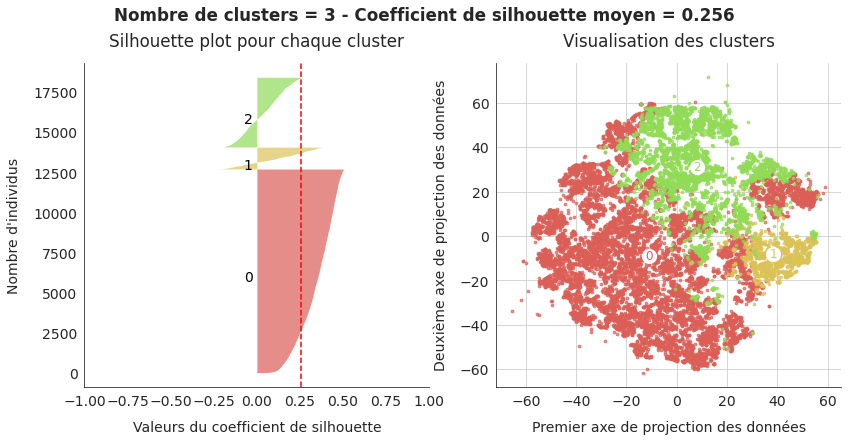

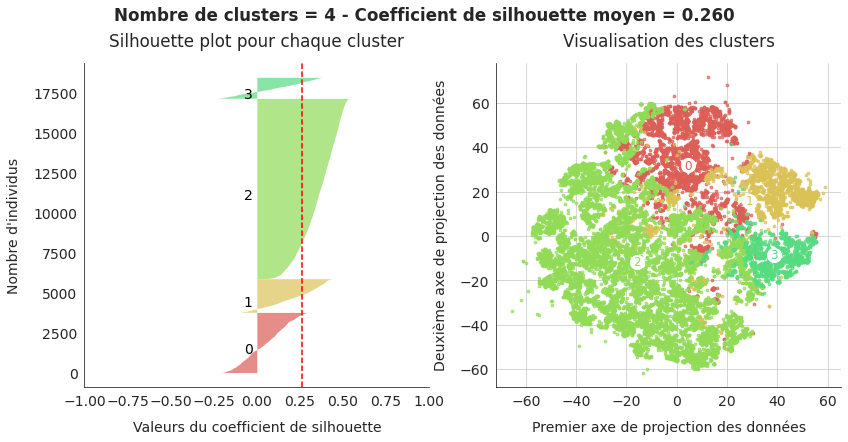

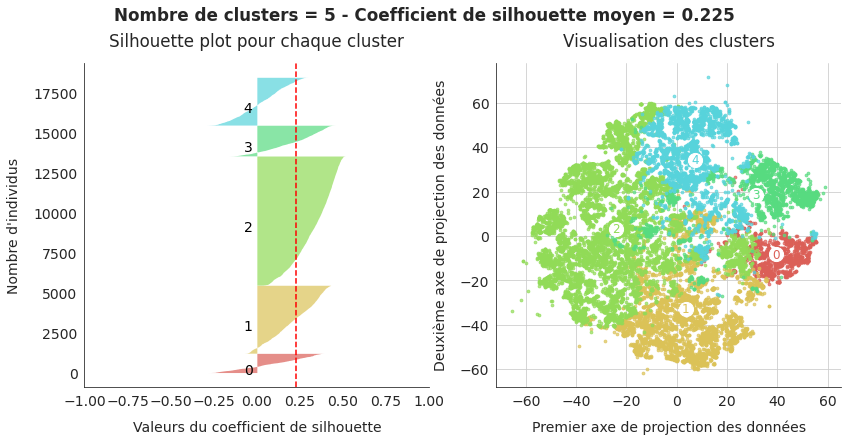

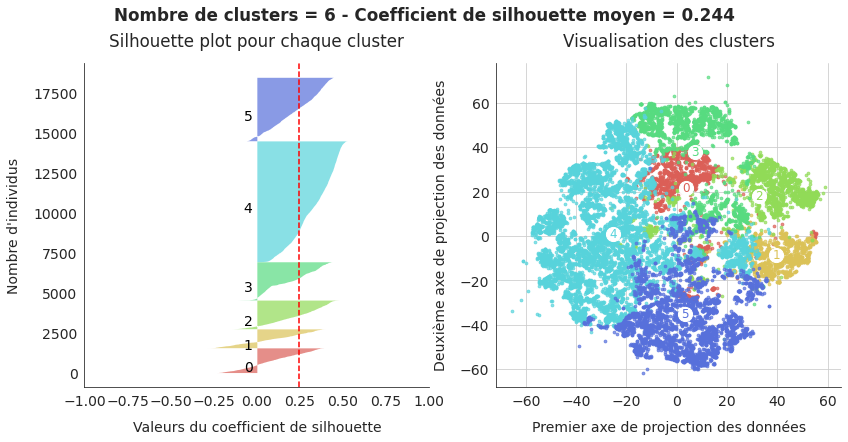

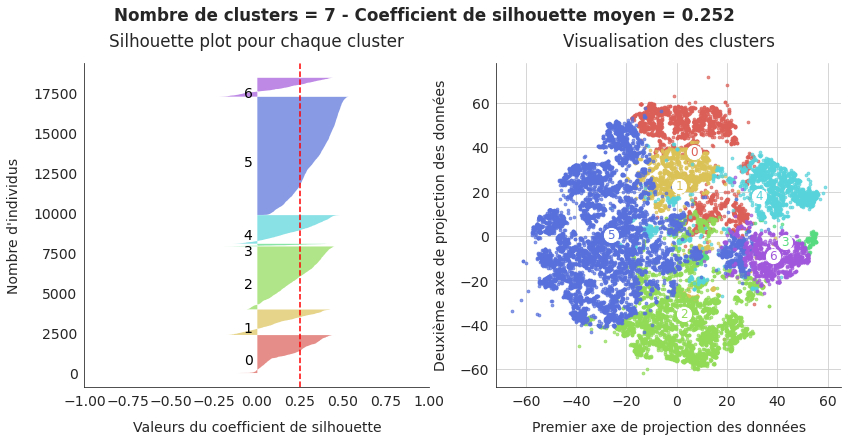

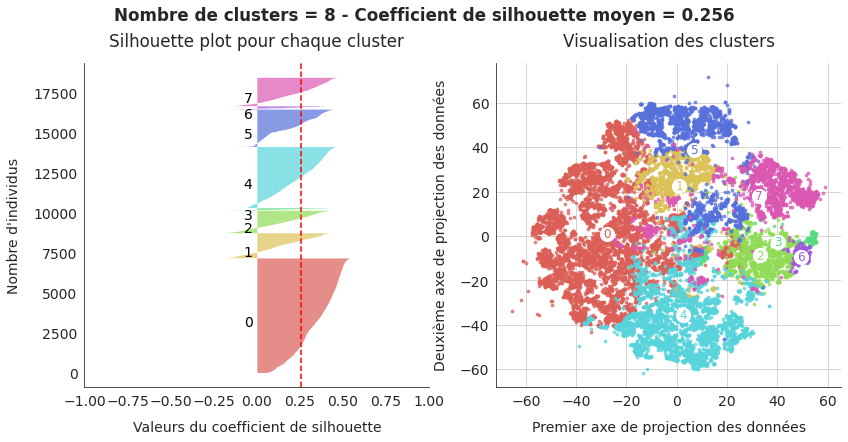

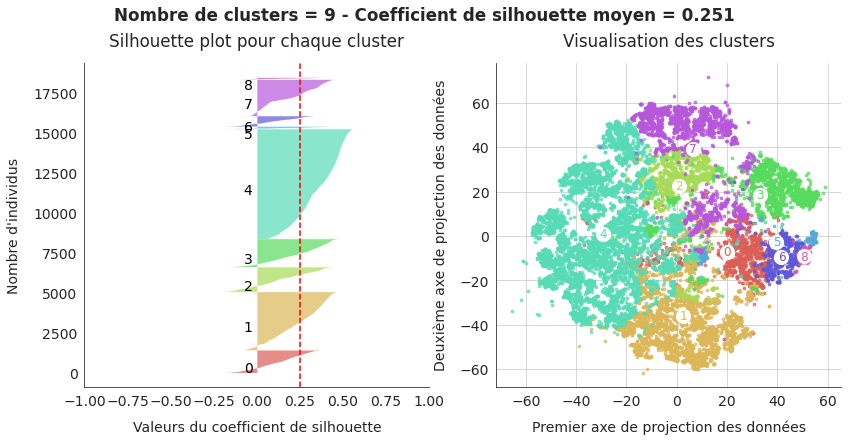

In [ ]:
products_kmeans.graphique_silhouette_analysis(products_tsne_reduced,
                                              min_nclust=2, max_nclust=9,
                                              plt_mult_param=0.8)

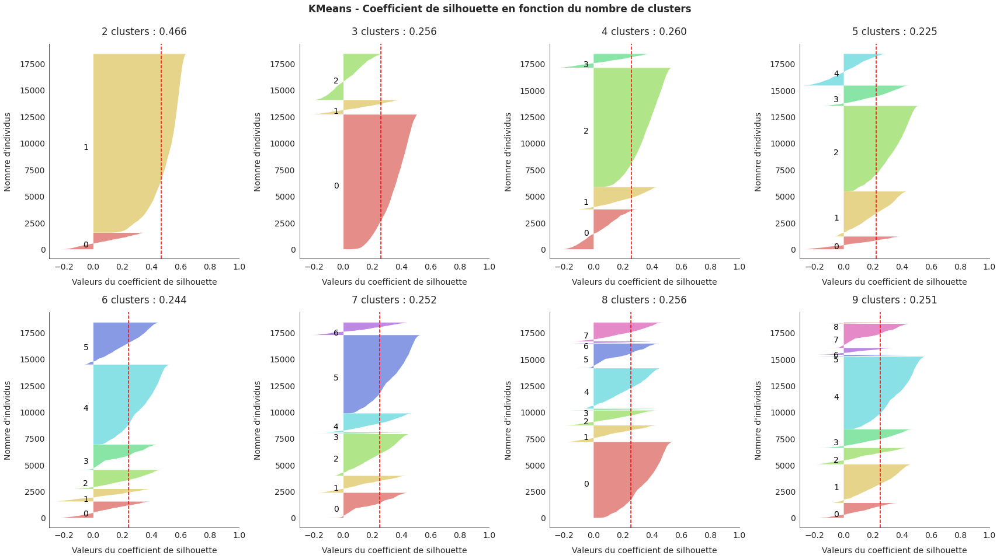

In [ ]:
fig, ax = products_kmeans.graphique_silhouette_details(min_nclust=2,
                                                       max_nclust=9,
                                                       nbcol=4,
                                                       min_silhouette=-0.3,
                                                       plt_mult_param=0.8,
                                                       figsize=(24, 13))
save_fig("ML04_part2_produits02_kmeans_silhouette")
plt.show()

Les segmentations avec 4 et 8 clusters me semblent les plus efficaces pour créer des groupes homogènes suffisamment séparés les uns des autres. J'examine ces 2 segmentations.

**Pour 4 clusters**

In [ ]:
nclust = 4
products_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = products_tsne.copy()
check_clust = check_clust.merge(products_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_item_price,average_weight_g,average_volume_cm3,average_name_lenght,average_description_lenght,average_photos_qty,average_distance_customer_seller
cluster_0,0.080077,-0.109381,-0.162703,0.475334,0.982601,1.168238,-0.218011
cluster_1,0.025756,-0.211188,-0.215488,0.049420,-0.019157,-0.039533,2.227295
cluster_2,-0.176552,-0.255077,-0.204785,-0.168587,-0.338880,-0.377085,-0.325692
cluster_3,1.236433,2.848149,2.664058,-0.020761,0.145961,-0.059292,-0.106641
all_data,-0.000995,-0.000374,0.005950,-0.001930,0.001461,-0.000897,0.002616


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

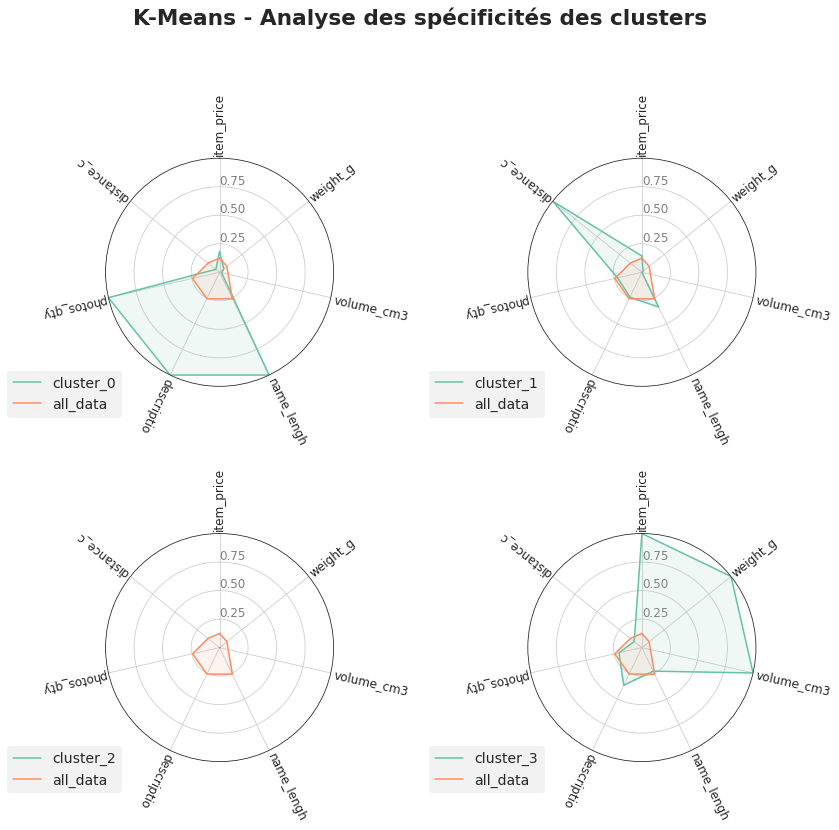

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=2, polar=True, figsize=(12, 12))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 3755 individus
Cluster 1 : 2097 individus
Cluster 2 : 11252 individus
Cluster 3 : 1305 individus


Analyse des clusters :
- cluster 0 : Clients qui commandent des articles ayant une description précise.
- cluster 1 : Clients qui commandent à des vendeurs lointains, peu attentifs au commerce de proximité.
- cluster 2 : Clients "moyens".
- cluster 3 : Clients qui commendent des articles volumineux et chers.

Je ne vois pas l'intérêt de cette segmentation d'un point de vue marketing. Et elle n'est pas suffisamment précise pour faire de la recommandation de produits.

**Pour 8 clusters**

In [ ]:
nclust = 8
products_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = products_tsne.copy()
check_clust = check_clust.merge(products_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_item_price,average_weight_g,average_volume_cm3,average_name_lenght,average_description_lenght,average_photos_qty,average_distance_customer_seller
cluster_0,-0.183821,-0.277994,-0.200749,0.505332,-0.339513,-0.417022,-0.316587
cluster_1,0.117207,-0.132187,-0.251753,0.397063,2.357265,0.064786,-0.024162
cluster_2,0.383857,2.119387,1.901689,-0.032741,-0.045662,-0.172658,-0.160784
cluster_3,7.260890,0.904379,0.632637,0.131743,1.533148,0.364267,0.344817
cluster_4,-0.149168,-0.304557,-0.297171,-1.427219,-0.296325,-0.342418,-0.258551
cluster_5,-0.161624,-0.162068,-0.189585,0.418635,-0.058397,1.866222,-0.274146
cluster_6,2.293784,5.262588,5.823328,0.267400,0.396990,0.391930,-0.151042
cluster_7,-0.010779,-0.228897,-0.216385,0.093024,-0.108168,-0.032361,2.358634
all_data,-0.000995,-0.000374,0.005950,-0.001930,0.001461,-0.000897,0.002616


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

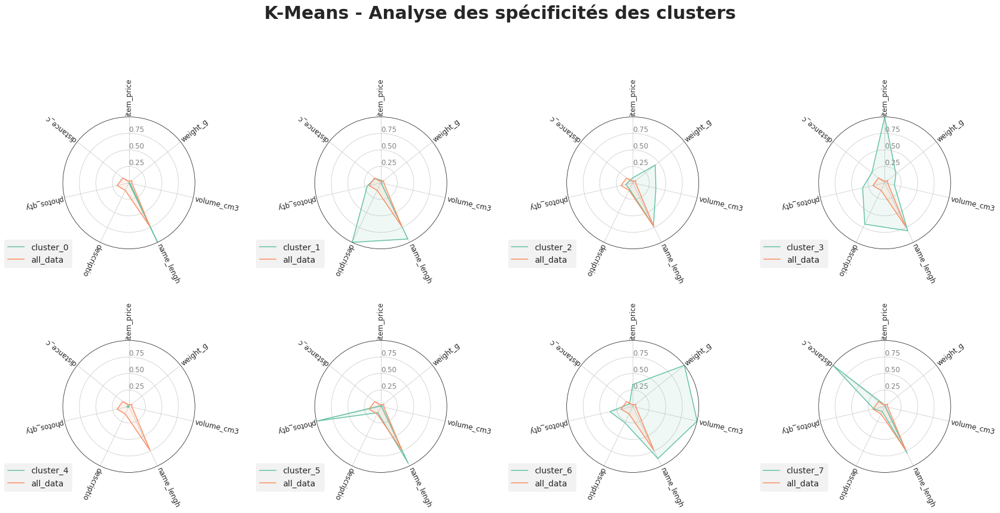

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=4, polar=True, figsize=(24, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_produits03_kmeans_radar8")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 7175 individus
Cluster 1 : 1560 individus
Cluster 2 : 1405 individus
Cluster 3 : 151 individus
Cluster 4 : 3817 individus
Cluster 5 : 2331 individus
Cluster 6 : 195 individus
Cluster 7 : 1775 individus


Analyse des clusters :
- cluster 0 : toutes les variables sont inférieures à la moyenne, sauf le nom qui est plus long que la moyenne. Clients qui commandent de petits articles, peu décrits avec un nom très long, principalement à des vendeurs proches.
- cluster 1 : la longueur du nom et de la description du produit sont supérieurs à la moyenne, pas le nombre de photos. Clients qui préfèrent commander des articles de taille moyenne bien décrits.
- cluster 2 : prix moyen des articles supérieur à la moyenne, poids et volumes très supérieurs à la moyenne. Clients qui commandent de très gros articles dont le prix reste modéré.
- cluster 3 : toutes les variables sont supérieures à la moyenne, en particulier le prix moyen et la longueur de la description. Clients qui commandent des articles de grande valeur, de taille supérieure à la moyenne, très bien décrits.
- cluster 4 : toutes les variables sont inférieures à la moyenne, avec un nom très court. Clients qui commandent de petits articles, peu décrits avec un nom très court, principalement à des vendeurs proches.
- cluster 5 : le nombre de photos est très supérieur à la moyenne. Clients qui attachent une grande importance aux visuels des articles achetés.
- cluster 6 : toutes les variables, excepté la distance du vendeur, sont supérieures à la moyenne, en particulier le prix moyen, le volume et le poids. Clients qui commandent des articles très volumeux de très grande valeur, avec une description assez précise.
- cluster 7 : la distance entre le vendeur et l'acheteur est très supérieure à la moyenne. Clients qui achètent à des vendeurs lointains, peu attentifs au commerce de proximité.

La segmentation avec 8 clusters me paraît très pertinente pour cibler les clients en fonction des articles qu'ils ont commandé.

In [ ]:
nclust = 8

<a id='5_3'></a>

### 5.3. Clustering avec GMM

In [ ]:
products_gmm = GaussianMixture(n_components=nclust, random_state=42)
gmm_labels = products_gmm.fit_predict(products_tsne)

In [ ]:
sil_score = silhouette_score(products_tsne, gmm_labels)
sil_values = silhouette_samples(products_tsne, gmm_labels)

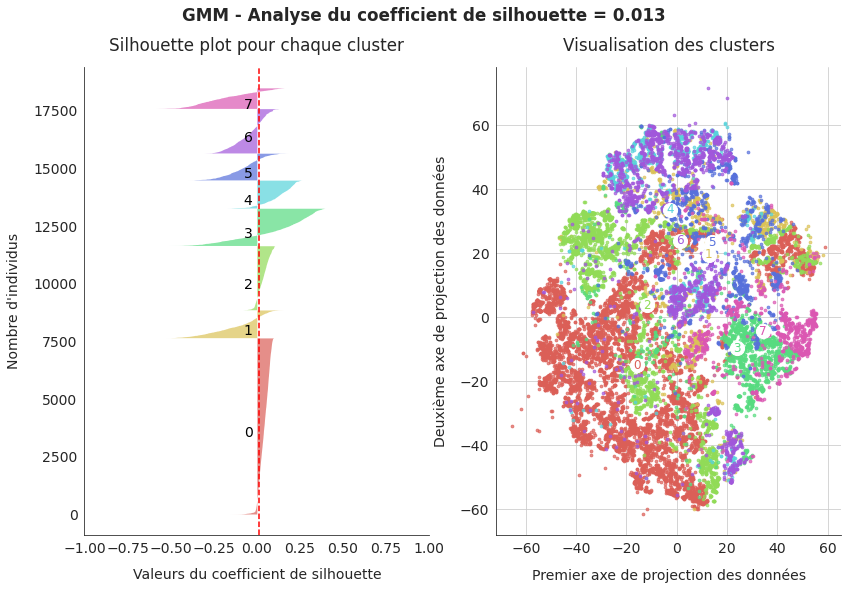

In [ ]:
graph_title = "GMM - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, gmm_labels,
                                sil_score, sil_values,
                                products_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_produits04_gmm_silhouette")
plt.show()

In [ ]:
check_clust = products_tsne.copy()
check_clust["cluster"] = gmm_labels
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_item_price,average_weight_g,average_volume_cm3,average_name_lenght,average_description_lenght,average_photos_qty,average_distance_customer_seller
cluster_0,-0.187284,-0.323694,-0.266641,-0.118503,-0.122237,-0.715726,-0.016548
cluster_1,0.573896,-0.446246,-0.497690,0.151922,0.698040,0.784942,0.796102
cluster_2,-0.266777,-0.356211,-0.243527,0.032127,-0.121123,-0.137432,0.006656
cluster_3,0.057568,1.543610,1.362979,-0.155457,-0.331469,-0.210037,-0.406326
cluster_4,-0.441639,-0.502753,-0.582055,0.301746,-0.358786,1.076619,-0.275232
cluster_5,0.093031,0.604107,0.413334,0.630121,0.779804,1.118161,0.415970
cluster_6,-0.267194,-0.300631,-0.231092,-0.039768,-0.067847,1.223569,-0.352098
cluster_7,2.588995,2.220559,2.113706,-0.189253,0.733909,0.313793,0.430562
all_data,-0.000995,-0.000374,0.005950,-0.001930,0.001461,-0.000897,0.002616


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

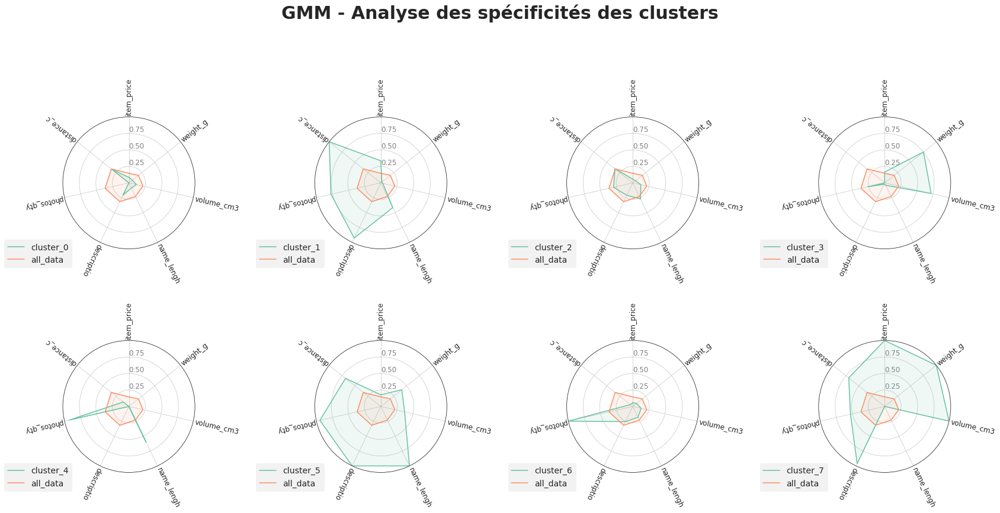

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("GMM - Analyse des spécificités des clusters",
                    nblin=2, nbcol=4, polar=True, figsize=(24, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_produits05_gmm_radar8")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 7636 individus
Cluster 1 : 1201 individus
Cluster 2 : 2776 individus
Cluster 3 : 1616 individus
Cluster 4 : 1208 individus
Cluster 5 : 1158 individus
Cluster 6 : 1922 individus
Cluster 7 : 892 individus


Clients achetant des :
- Cluster 0 : petits articles bon marché peu décrits;
- Cluster 1 : petits articles plus chers que la moyenne bien décrits ;
- Cluster 2 : proches de la moyenne ;
- Cluster 3 : gros articles peu décrits ;
- Cluster 4 : articles avec beaucoup de photos et un long nom ;
- Cluster 5 : gros articles très bien décrits, plutôt vendus par des vendeurs lointains ;
- Cluster 6 : artciles avec beaucoup de photos et un petit nom ;
- Cluster 7 : gros articles chers très bien décrits mais avec un nom très court.

La segmentation du GMM obtient un score de silhouette très faible. Il est confirmé par une segmentation qui me paraît moins pertinente que celle du kmeans, du point de vue interprétation métier.

<a id='5_4'></a>

### 5.4. Clustering hiérarchique

In [ ]:
products_agglo = AgglomerativeClustering(n_clusters=nclust, linkage="ward")
agglo_labels = products_agglo.fit_predict(products_tsne)

In [ ]:
sil_score = silhouette_score(products_tsne, agglo_labels)
sil_values = silhouette_samples(products_tsne, agglo_labels)

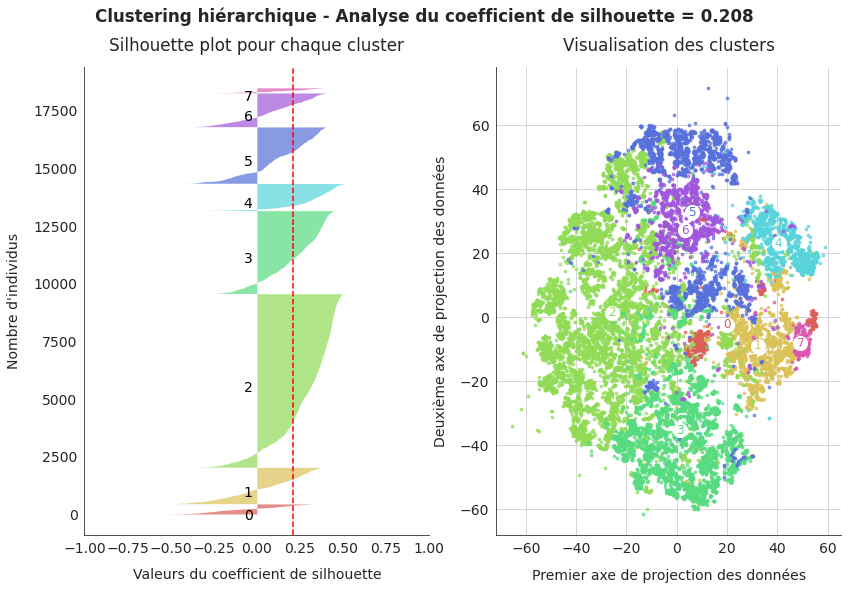

In [ ]:
graph_title = \
    "Clustering hiérarchique - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, agglo_labels,
                                sil_score, sil_values,
                                products_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_produits06_agglo_silhouette")
plt.show()

In [ ]:
check_clust = products_tsne.copy()
check_clust["cluster"] = agglo_labels
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,average_item_price,average_weight_g,average_volume_cm3,average_name_lenght,average_description_lenght,average_photos_qty,average_distance_customer_seller
cluster_0,4.068020,0.133925,0.082344,0.009440,0.803734,0.167559,0.330960
cluster_1,0.284609,1.945888,1.649149,-0.152388,-0.182298,-0.264830,0.057176
cluster_2,-0.207767,-0.282980,-0.184239,0.466796,-0.317502,-0.414775,-0.222482
cluster_3,-0.205235,-0.363937,-0.391135,-1.367289,-0.167090,-0.382421,-0.186784
cluster_4,-0.133718,-0.324645,-0.308677,0.052669,-0.119372,0.138253,2.624427
cluster_5,-0.184701,-0.120802,-0.112096,0.263155,-0.137100,1.656577,-0.394819
cluster_6,0.079105,-0.051000,-0.166194,0.586891,2.291906,0.348633,0.063104
cluster_7,2.560603,4.970104,5.396010,0.201098,0.344136,0.480416,-0.157335
all_data,-0.000995,-0.000374,0.005950,-0.001930,0.001461,-0.000897,0.002616


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

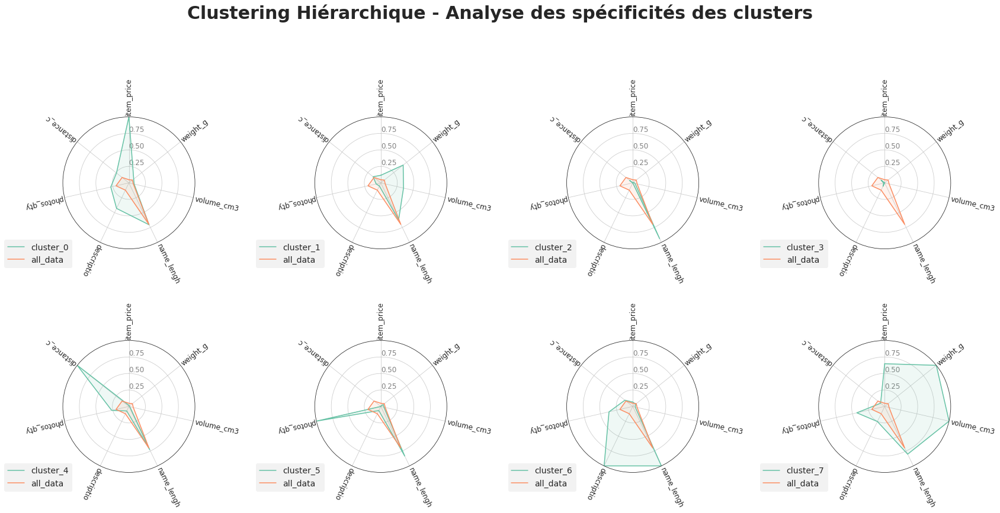

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph_title = "Clustering Hiérarchique - Analyse des spécificités des clusters"
graph = sfg.MyGraph(graph_title, nblin=2, nbcol=4,
                    polar=True, figsize=(24, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
save_fig("ML04_part2_produits07_agglo_radar8")
fig, ax = graph.fig, graph.ax

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 438 individus
Cluster 1 : 1575 individus
Cluster 2 : 7518 individus
Cluster 3 : 3594 individus
Cluster 4 : 1167 individus
Cluster 5 : 2443 individus
Cluster 6 : 1462 individus
Cluster 7 : 212 individus


Les graphiques en radar montrent que nous obtenons des clusters très similaires à ceux du K-Means. Le score de silhouette est également proche.

---
<a id='6_0'></a>

## <font color=blue>6. Clustering sur les caractéristiques des commandes</font>

Je vais essayer de segmenter la clientèle sur la base des commandes grâce aux variables :
- commandes : nombre total de commandes, fréquence de commandes sur la dernière année, prix total moyen, pourcentage des frais de port (orders_number, last_year_orders_frequency, average_total_price, average_order_percent_freight);
- articles : nombre moyen et prix moyen des articles dans le panier (average_items_number, average_item_price) ;
- paiement : nombre d'échéances (average_payment_installments).

### 6.1. Préparation des données

In [ ]:
data_orders = data[["orders_number",
                    "last_year_orders_frequency",
                    "average_total_price",
                    "average_order_percent_freight",
                    "average_items_number",
                    "average_item_price",
                    "average_payment_installments"]].copy()
orders_scaled = pd.DataFrame(StandardScaler().fit_transform(data_orders),
                             index=data_orders.index,
                             columns=data_orders.columns)

Il n'est pas nécessaire de faire une réduction de dimension au préalable de la segmentation car nous n'avons que 7 variables.  
Il faut effectuer la segmentation sur les valeurs standardisées.

In [ ]:
orders_tsne = orders_scaled.iloc[selected_indices].copy()

In [ ]:
X_reduc = []
list_perplexity = [50, 100, 200, 300, 400, 500]
for perplexity in list_perplexity:
    reduc = TSNE(perplexity=perplexity, n_jobs=-1, random_state=42)
    embedding = reduc.fit(orders_tsne.values)
    X_reduc.append(pd.DataFrame(embedding.transform(orders_tsne.values),
                                index=orders_tsne.index,
                                columns=["Axe 1", "Axe 2"]))

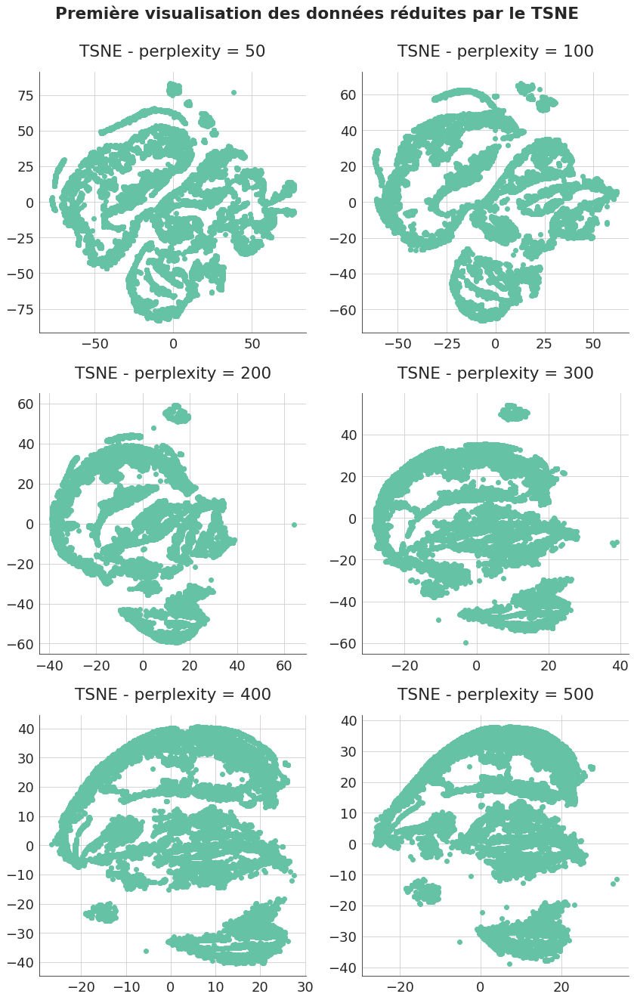

In [ ]:
graph = sfg.MyGraph("Première visualisation des données réduites par le TSNE",
                    nblin=3, nbcol=2)
for i in range(len(list_perplexity)):
    xreduc = X_reduc[i]
    graph.add_scatter(xreduc.iloc[:, 0], xreduc.iloc[:, 1],
                      subtitle="TSNE - perplexity = {}".format(
                          list_perplexity[i]),
                      multi_index=i+1)
fig, ax = graph.fig, graph.ax
plt.show()

J'opte pour une perpléxité de 500.

In [ ]:
reduc = TSNE(perplexity=500, n_jobs=-1, random_state=42)
embedding = reduc.fit(orders_tsne.values)
orders_tsne_reduced = pd.DataFrame(embedding.transform(orders_tsne.values),
                                   index=orders_tsne.index,
                                   columns=["Axe 1", "Axe 2"])

<a id='6_2'></a>

### 6.2. Clustering avec K-means

In [ ]:
orders_kmeans = sfc.MyKmeans(orders_tsne, random_state=42)

In [ ]:
orders_kmeans.choix_n_clusters(2, 20)

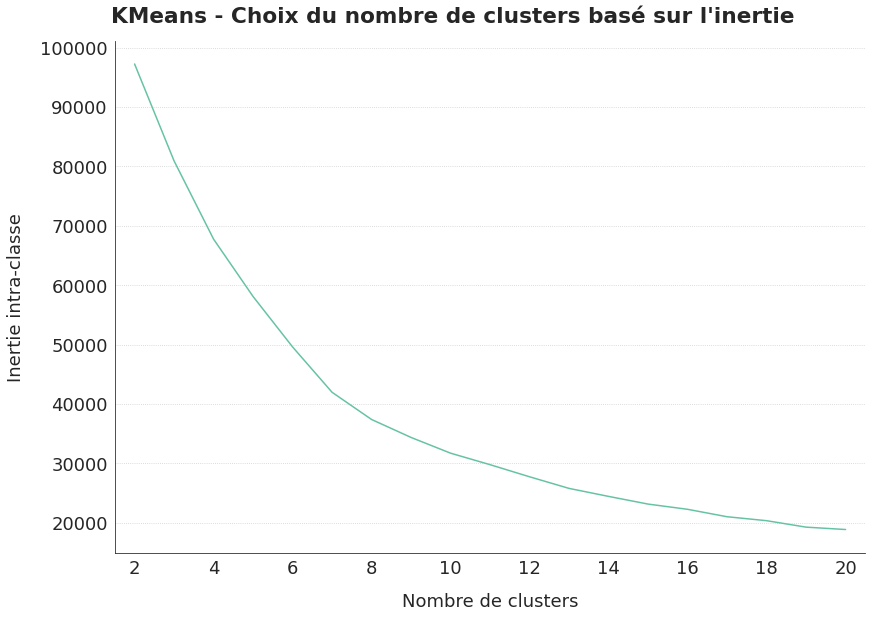

In [ ]:
fig, ax = orders_kmeans.graphique_choix_nclusters()

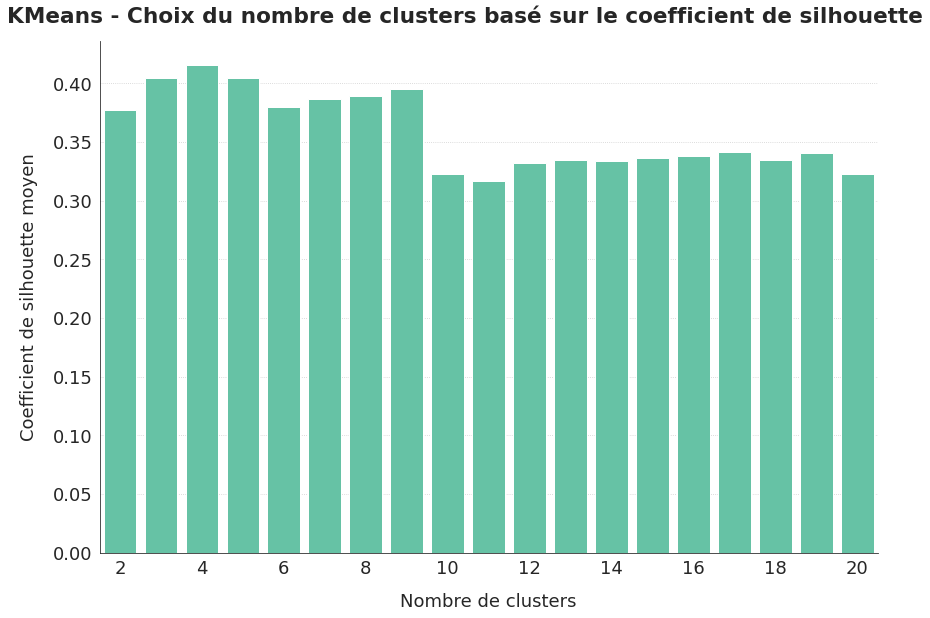

In [ ]:
fig, ax = orders_kmeans.graphique_silhouette_scores()
save_fig("ML04_part2_commandes01_kmeans_nclusters")
plt.show()

Les coefficients de silhouette moyens favorisent entre 2 et 9 clusters.

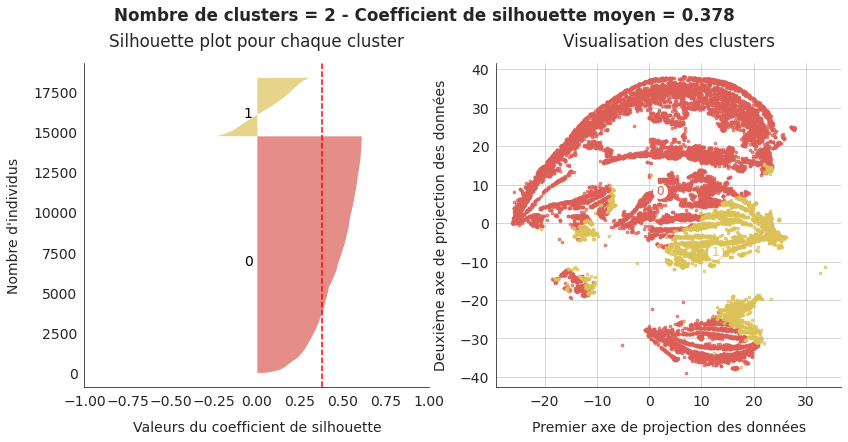

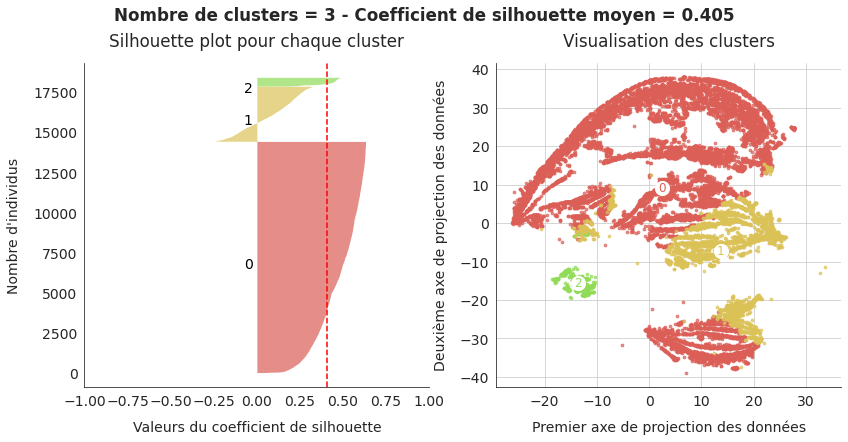

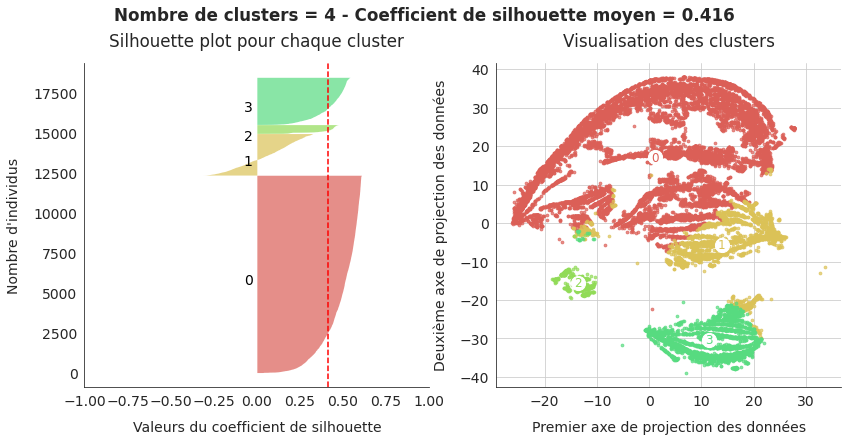

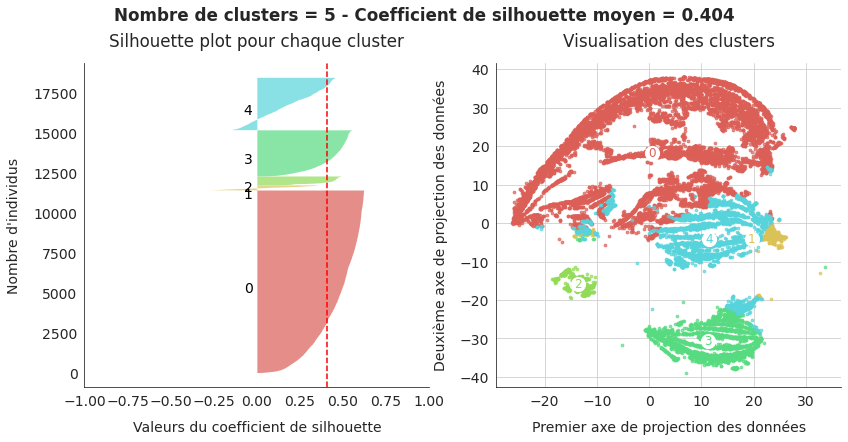

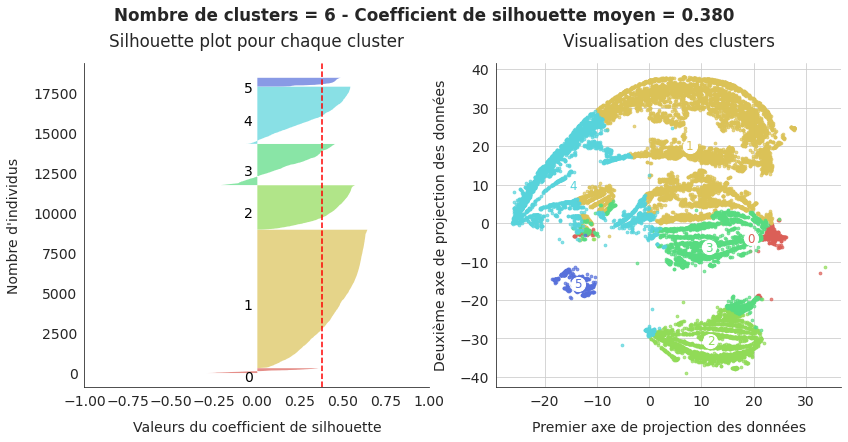

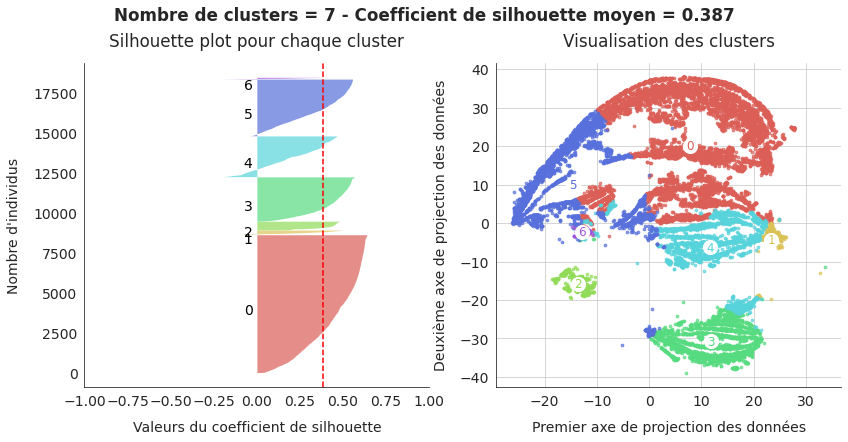

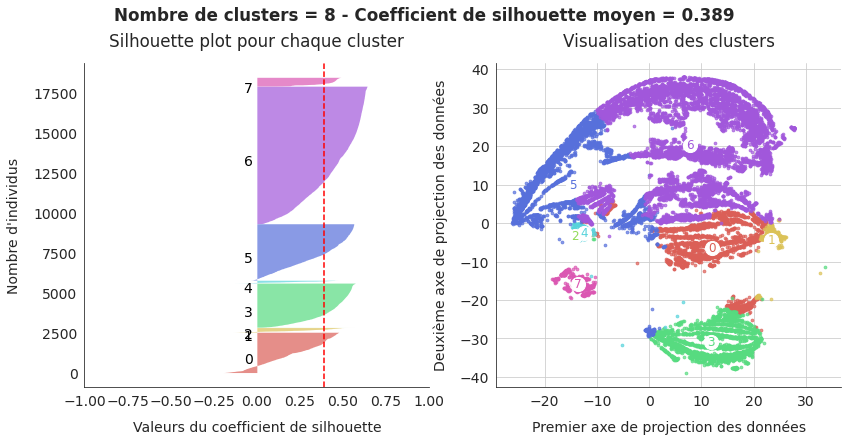

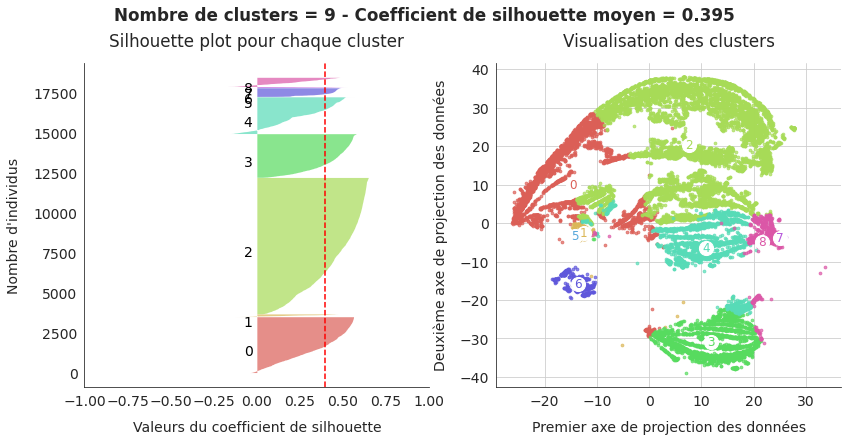

In [ ]:
orders_kmeans.graphique_silhouette_analysis(orders_tsne_reduced,
                                            min_nclust=2, max_nclust=9,
                                            plt_mult_param=0.8)

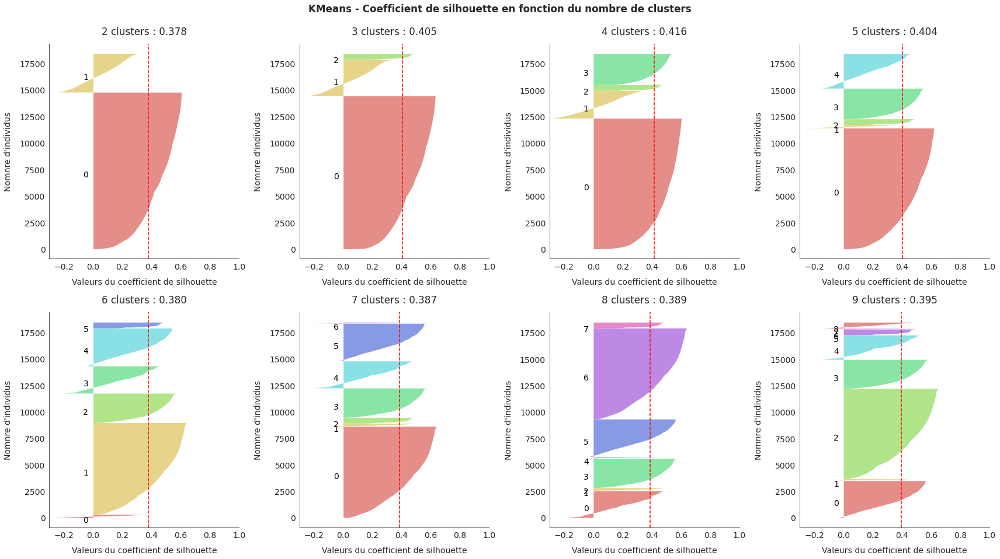

In [ ]:
fig, ax = orders_kmeans.graphique_silhouette_details(min_nclust=2,
                                                     max_nclust=9,
                                                     nbcol=4,
                                                     min_silhouette=-0.3,
                                                     plt_mult_param=0.8,
                                                     figsize=(24, 13))
save_fig("ML04_part2_commandes02_kmeans_silhouette")
plt.show()

La segmentation en 7 groupes me paraît la plus équilibrée. Elle permet d'obtenir des groupes bien séparés et homogènes, tout en gardant des tailles de cluster suffisantes. J'analyse la segmentation sur 7 clusters.

**Pour 7 clusters**

In [ ]:
nclust = 7
orders_kmeans.define_n_clusters(nclust)

Done


In [ ]:
check_clust = orders_tsne.copy()
check_clust = check_clust.merge(orders_kmeans.df_clusters[["cluster"]],
                                how="left",
                                left_index=True, right_index=True)
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,orders_number,last_year_orders_frequency,average_total_price,average_order_percent_freight,average_items_number,average_item_price,average_payment_installments
cluster_0,-0.162524,0.417009,-0.080702,-0.402685,-0.069734,-0.069007,-0.382604
cluster_1,-0.162524,-0.140137,3.079257,-1.306429,-0.121054,5.843435,1.505374
cluster_2,5.303915,1.193159,-0.044688,-0.002691,0.049412,-0.113374,0.186711
cluster_3,-0.162524,-2.000145,-0.137691,0.020807,-0.073446,-0.158896,-0.186872
cluster_4,-0.162524,0.104078,0.259485,-0.609679,0.004262,0.446790,1.873477
cluster_5,-0.162524,0.345455,-0.286299,1.461271,-0.023259,-0.476352,-0.423194
cluster_6,0.031856,0.058025,4.420928,0.223498,8.198547,-0.193452,0.569374
all_data,0.000377,0.009445,-0.007598,-0.007186,-0.002986,-0.000995,0.002350


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

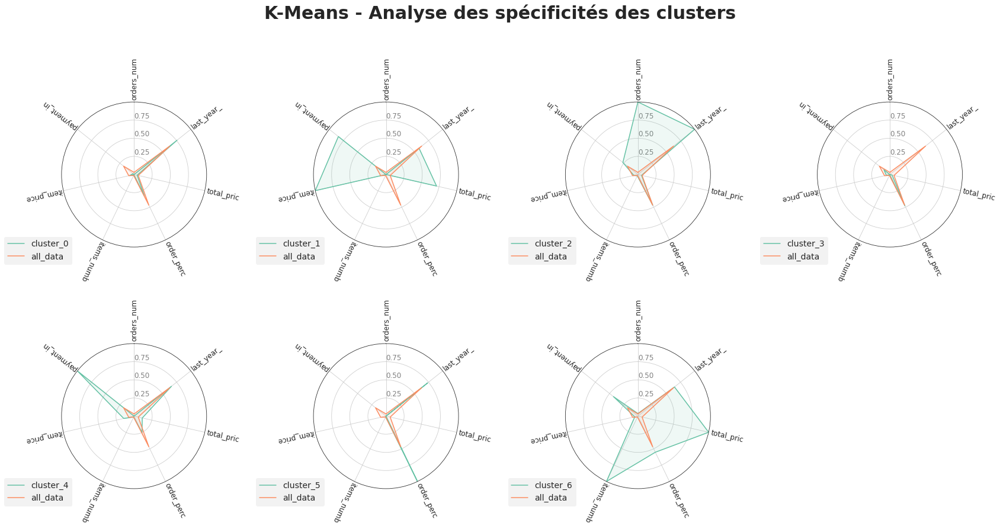

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("K-Means - Analyse des spécificités des clusters",
                    nblin=2, nbcol=4, polar=True, figsize=(24, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
graph.ax[7].set_axis_off()
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_commandes03_kmeans_radar7")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 8621 individus
Cluster 1 : 282 individus
Cluster 2 : 545 individus
Cluster 3 : 2764 individus
Cluster 4 : 2549 individus
Cluster 5 : 3547 individus
Cluster 6 : 101 individus


Analyse des clusters :
- cluster 0 : le nombre d'échéances de paiement et le pourcentage des frais de port dans le prix total sont inférieurs à la moyenne. Clients achètent des articles d'un prix moyen, qui paient comptant et qui font attention au coût de livraison. Ils ont eu tendance à commander plusieurs fois lors de la dernière année.
- cluster 1 : le prix moyen des paniers et des articles et le nombre d'échéances de paiement sont très supérieurs à la moyenne. Clients qui commandent des articles très chers, qu'ils paient à crédit.
- cluster 2 : le nombre de commandes et leur fréquence lors de la dernière année sont très supérieurs à la moyenne. Clients fidèles qui passent de nombreuses commandes fréquemment.
- cluster 3 : la fréquence d'achat sur la dernière année est nulle. Anciens clients qui n'ont pas commandé lors de l'année passée.
- cluster 4 : le prix moyen des paniers et des articles et le nombre d'échéances de paiement sont moyennement supérieurs à la moyenne. Clients qui commandent des articles au prix supérieur à la moyenne, sans être très onéreux, qu'ils paient à crédit.
- cluster 5 : le prix moyen des paniers et des articles et le nombre d'échéances de paiement sont inférieurs à la moyenne. Clients qui commandent des articles de faible valeur, qui paient comptant et qui ne font pas attention à la proportion des coûts de livraison. Ils ont eu tendance à commander plusieurs fois lors de la dernière année.
- cluster 6 : le prix moyen des paniers et le nombre moyen d'articles sont très supérieurs à la moyenne. Clients qui passent de grosses commandes car leurs paniers comportent de nombreux articles.

In [ ]:
nclust = 7

<a id='6_3'></a>

### 6.3. Clustering avec GMM

In [ ]:
orders_gmm = GaussianMixture(n_components=nclust, random_state=42)
gmm_labels = orders_gmm.fit_predict(orders_tsne)

In [ ]:
sil_score = silhouette_score(orders_tsne, gmm_labels)
sil_values = silhouette_samples(orders_tsne, gmm_labels)

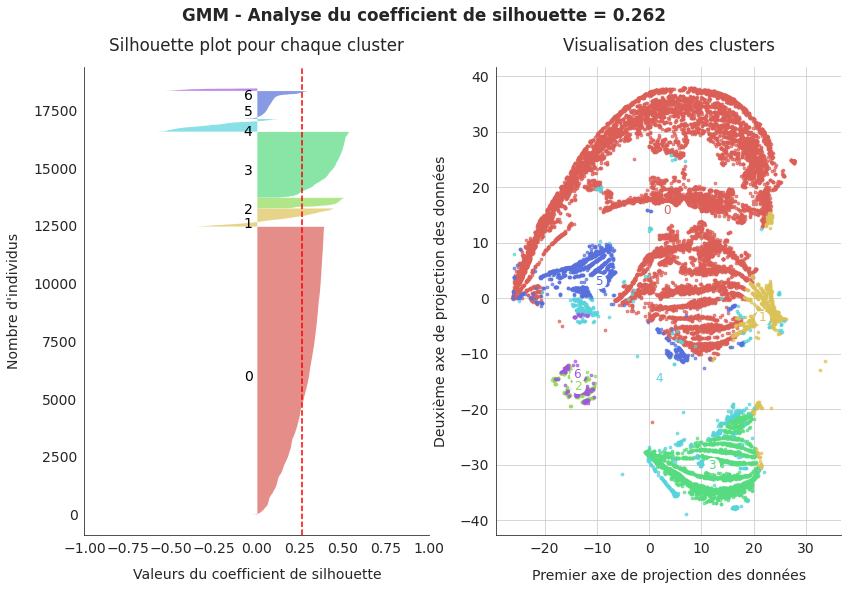

In [ ]:
graph_title = "GMM - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, gmm_labels,
                                sil_score, sil_values,
                                orders_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_commandes04_gmm_silhouette")
plt.show()

In [ ]:
check_clust = orders_tsne.copy()
check_clust["cluster"] = gmm_labels
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,orders_number,last_year_orders_frequency,average_total_price,average_order_percent_freight,average_items_number,average_item_price,average_payment_installments
cluster_0,-0.162524,0.417009,-0.169058,0.020526,-0.160603,-0.150110,-0.114023
cluster_1,-0.162524,0.009519,1.602722,-1.255600,-0.160603,3.362252,1.165508
cluster_2,5.331928,1.192423,-0.127388,-0.036507,-0.117933,-0.102528,0.173876
cluster_3,-0.162524,-2.000145,-0.166422,0.047377,-0.160603,-0.140144,0.014560
cluster_4,-0.162524,-0.899437,1.281168,0.270769,2.100854,0.045447,0.513704
cluster_5,-0.162524,0.417009,0.270285,0.260834,0.893582,-0.285113,0.090522
cluster_6,4.609228,1.066059,2.005476,0.135333,3.308498,-0.152259,0.385507
all_data,0.000377,0.009445,-0.007598,-0.007186,-0.002986,-0.000995,0.002350


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

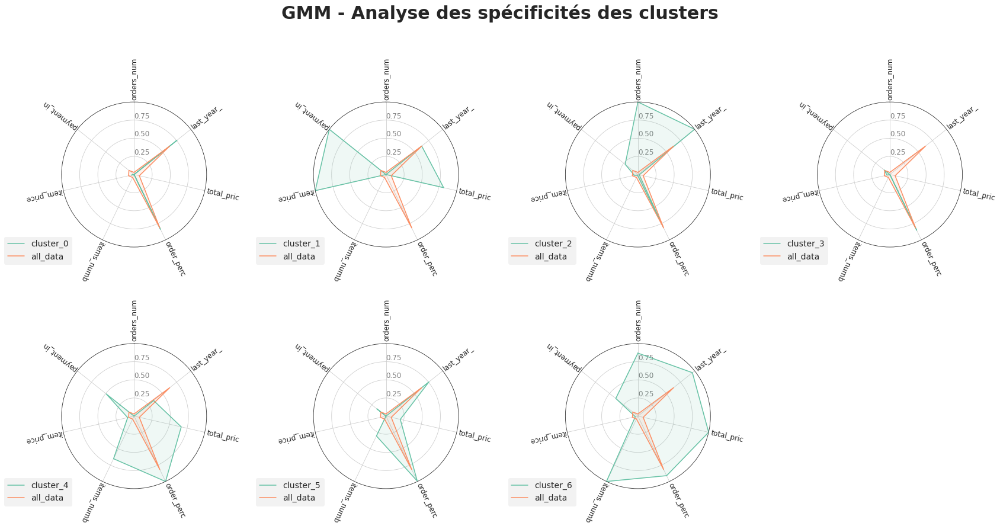

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph = sfg.MyGraph("GMM - Analyse des spécificités des clusters",
                    nblin=2, nbcol=4, polar=True, figsize=(24, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
graph.ax[7].set_axis_off()
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_commandes05_gmm_radar7")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 12469 individus
Cluster 1 : 783 individus
Cluster 2 : 452 individus
Cluster 3 : 2847 individus
Cluster 4 : 549 individus
Cluster 5 : 1201 individus
Cluster 6 : 108 individus


Analyse des clusters :
- Cluster 0 : clients qui commendent de petits articles et peu attentifs au pourcentage des frais de port ;
- Cluster 1 : clients qui achètent à crédit un seul article au prix élevé ;
- Cluster 2 : clients fidèles qui ont acheté souvent et fréquemment lors des 12 derniers mois, mais des paniers peu élevés ;
- Cluster 3 : clients qui n'ont plus commandé lors des 12 derniers mois ;
- Cluster 4 : clients qui ont effectué une commande au montant élevé car leur panier comportait plusieurs articles d'un prix unitaire moyen ;
- Cluster 5 : clients qui ont commandé 2 ou 3 articles pour un panier moyen légèrmeent supérieur à la moyenne ;
- cluster 6 : clients fidèles qui ont acheté souvent et fréquemment lors des 12 derniers mois, avec des paniers au montant élevé avec de nombreux articles. Clients les plus intéressants.

La segmentation du GMM obtient un coefficient de silhouette peu élevé. Elle paraît intéressante pour certains clusters, peu pertinente pour d'autres. Mais la répartition des clients entre les différents clusters est particulièrement inégale.

<a id='6_4'></a>

### 6.4. Clustering hiérarchique

In [ ]:
orders_agglo = AgglomerativeClustering(n_clusters=nclust, linkage="ward")
agglo_labels = orders_agglo.fit_predict(orders_tsne)

In [ ]:
sil_score = silhouette_score(orders_tsne, agglo_labels)
sil_values = silhouette_samples(orders_tsne, agglo_labels)

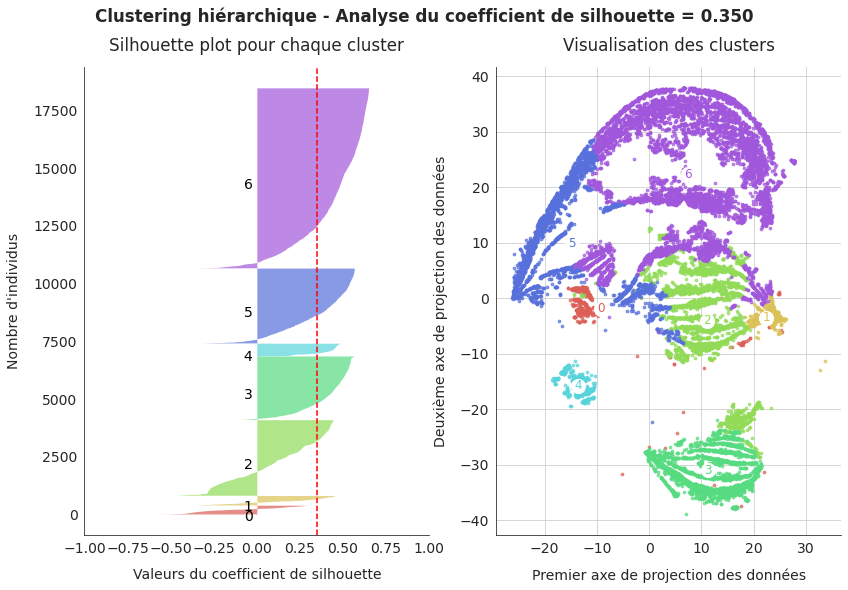

In [ ]:
graph_title = \
    "Clustering hiérarchique - Analyse du coefficient de silhouette = {:.3f}"\
    .format(sil_score)
graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2,
                    color_palette="hls", ncolors=8,
                    figsize=(12, 8), plt_mult_param=0.8)
graph.graph_silhouette_analysis(nclust, agglo_labels,
                                sil_score, sil_values,
                                orders_tsne_reduced)
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_commandes06_agglo_silhouette")
plt.show()

In [ ]:
check_clust = orders_tsne.copy()
check_clust["cluster"] = agglo_labels
data_by_clust = check_clust.groupby("cluster").mean()
data_by_clust.index = ["cluster_{}".format(idx) for idx in data_by_clust.index]
data_by_clust.loc["all_data", :] = check_clust.mean(axis=0)
data_by_clust

,orders_number,last_year_orders_frequency,average_total_price,average_order_percent_freight,average_items_number,average_item_price,average_payment_installments
cluster_0,-0.111130,0.176559,2.096899,0.142094,3.880715,-0.105077,0.378311
cluster_1,-0.162524,0.135399,2.370129,-1.270128,-0.151941,4.715400,1.680811
cluster_2,-0.162524,0.090686,0.063277,-0.570679,-0.092609,0.220751,1.438229
cluster_3,-0.162524,-2.000145,-0.161089,0.146264,-0.087791,-0.189893,-0.264960
cluster_4,5.303915,1.193159,-0.044688,-0.002691,0.049412,-0.113374,0.186711
cluster_5,-0.162524,0.417009,-0.305356,1.441778,-0.079904,-0.482412,-0.332735
cluster_6,-0.162524,0.417009,-0.085405,-0.368505,-0.089453,-0.063340,-0.486620
all_data,0.000377,0.009445,-0.007598,-0.007186,-0.002986,-0.000995,0.002350


In [ ]:
data_by_clust.columns = [col.replace("average_", "")[:10]
                         for col in data_by_clust.columns]

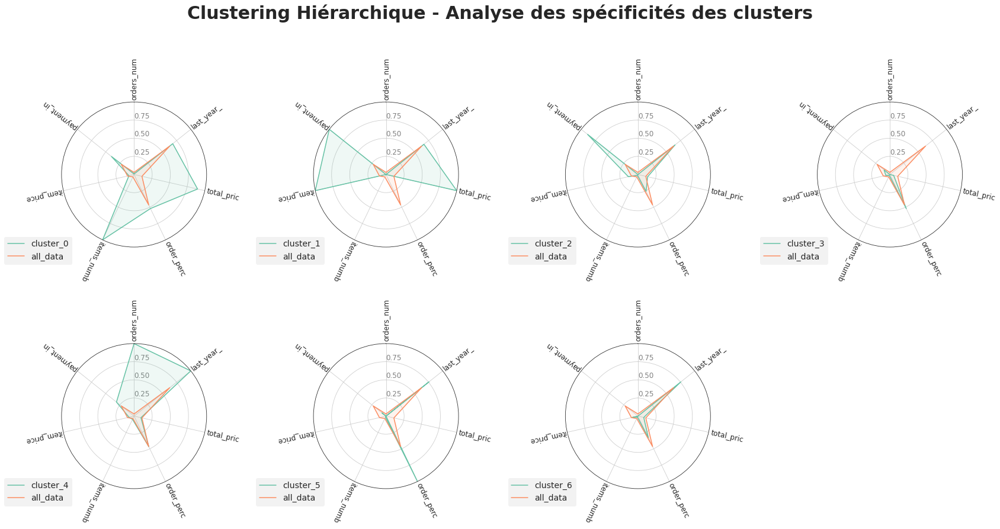

In [ ]:
df_values = pd.DataFrame(MinMaxScaler().fit_transform(data_by_clust),
                         index=data_by_clust.index,
                         columns=data_by_clust.columns)
graph_title = "Clustering Hiérarchique - Analyse des spécificités des clusters"
graph = sfg.MyGraph(graph_title, nblin=2, nbcol=4, polar=True,
                    figsize=(24, 13))
for i in range(nclust):
    graph.add_radar_plot(df_values.iloc[[i, -1]],
                         legend_fontsize=14, multi_index=i+1)
graph.ax[7].set_axis_off()
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_commandes07_agglo_radar7")
plt.show()

In [ ]:
print("Taille de chaque cluster")
for i in range(nclust):
    print("Cluster {} : {} individus".format(
        i, len(check_clust[check_clust.cluster == i])))

Taille de chaque cluster
Cluster 0 : 382 individus
Cluster 1 : 412 individus
Cluster 2 : 3274 individus
Cluster 3 : 2751 individus
Cluster 4 : 545 individus
Cluster 5 : 3245 individus
Cluster 6 : 7800 individus


Encore une fois, nous obtenons des clusters similaires à ceux du K-Means. Ceci est assez logique, étant donné que nous utilisons la distance de Ward pour notre clustering hiérarchique.

---
<a id='7_0'></a>

## <font color=blue>7. Evaluation de la stabilité à l'initialisation</font>

J'évalue le temps de calcul et la stabilité du coefficient de silhouette en même temps que la stabilité.

La stabilité à l'initialisation s'évalue en vérifiant la stabilité de la répartition des clients entre les clusters lorsqu'on répète plusieurs la segmentation sans random_state défini. On évalue ainsi la part d'aléatoire dans la segmentation obtenue.

In [ ]:
satisfaction_features = ["average_approbation_time",
                         "average_shipping_time",
                         "average_delivery_lag",
                         "average_review_score",
                         "average_comment_title_length",
                         "average_comment_message_length"]
products_features = ["average_item_price",
                     "average_weight_g",
                     "average_volume_cm3",
                     "average_name_lenght",
                     "average_description_lenght",
                     "average_photos_qty",
                     "average_distance_customer_seller"]
orders_features = ["orders_number",
                   "last_year_orders_frequency",
                   "average_total_price",
                   "average_order_percent_freight",
                   "average_items_number",
                   "average_item_price",
                   "average_payment_installments"]

<a id='7_1'></a>

### 7.1. Segmentation sur la satisfaction client

In [ ]:
satisfaction_scaled = \
    SelectFeatures(satisfaction_features, selected_indices).fit_transform(data)

In [ ]:
n_test_stab = 10
nclust = 6
satisf_kmeans_time, satisf_kmeans_stab, satisf_kmeans_sil = \
    get_stab_index(satisfaction_scaled, n_test_stab, nclust, "KMeans")
satisf_gmm_time, satisf_gmm_stab, satisf_gmm_sil = \
    get_stab_index(satisfaction_scaled, n_test_stab, nclust, "GMM")
satisf_agglo_time, satisf_agglo_stab, satisf_agglo_sil = \
    get_stab_index(satisfaction_scaled, n_test_stab, nclust, "Agglo")

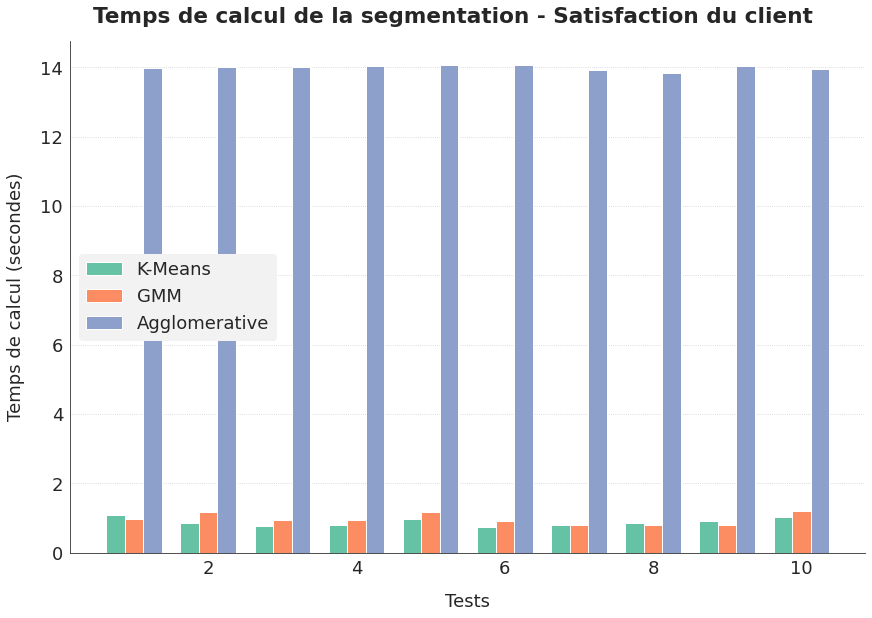

In [ ]:
graph_title = "Temps de calcul de la segmentation - Satisfaction du client"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), satisf_kmeans_time,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), satisf_gmm_time,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), satisf_agglo_time,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Temps de calcul (secondes)")
graph.set_legend(loc="center left")
fig, ax = graph.fig, graph.ax

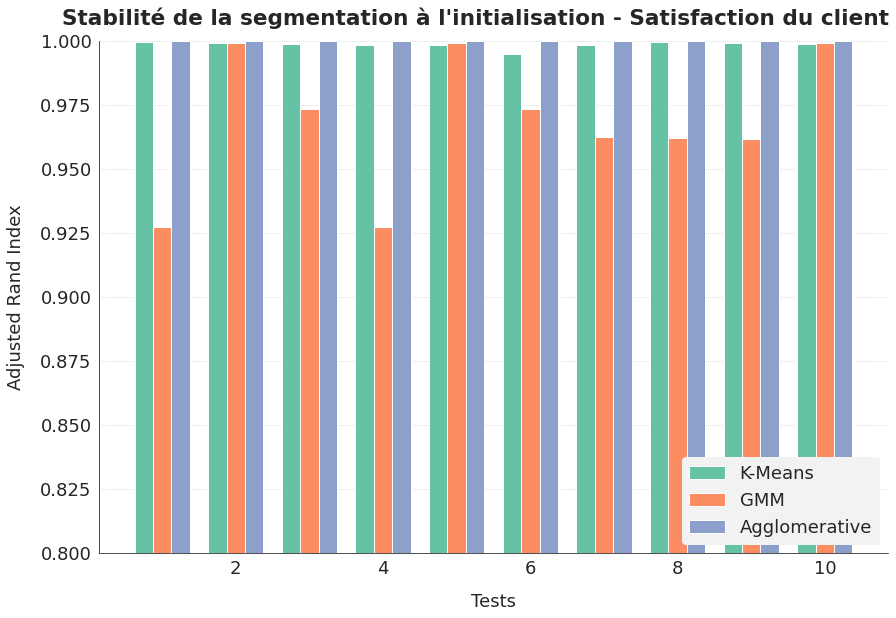

In [ ]:
graph_title = \
    "Stabilité de la segmentation à l'initialisation - Satisfaction du client"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), satisf_kmeans_stab,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), satisf_gmm_stab,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), satisf_agglo_stab,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Adjusted Rand Index", tick_min=0.8, tick_max=1.0)
graph.set_legend(loc="lower right")
fig, ax = graph.fig, graph.ax

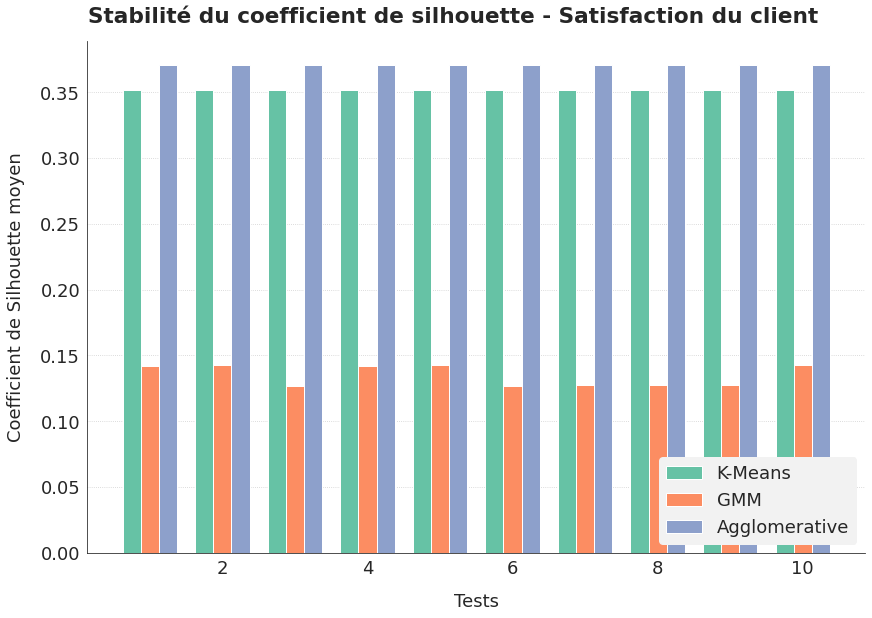

In [ ]:
graph_title = "Stabilité du coefficient de silhouette - Satisfaction du client"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), satisf_kmeans_sil,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), satisf_gmm_sil,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), satisf_agglo_sil,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Coefficient de Silhouette moyen")
graph.set_legend(loc="lower right")
fig, ax = graph.fig, graph.ax

<a id='7_2'></a>

### 7.2. Segmentation sur le type de produits

In [ ]:
products_scaled = \
    SelectFeatures(products_features, selected_indices).fit_transform(data)

In [ ]:
n_test_stab = 10
nclust = 8
products_kmeans_time, products_kmeans_stab, products_kmeans_sil = \
    get_stab_index(products_scaled, n_test_stab, nclust, "KMeans")
products_gmm_time, products_gmm_stab, products_gmm_sil = \
    get_stab_index(products_scaled, n_test_stab, nclust, "GMM")
products_agglo_time, products_agglo_stab, products_agglo_sil = \
    get_stab_index(products_scaled, n_test_stab, nclust, "Agglo")

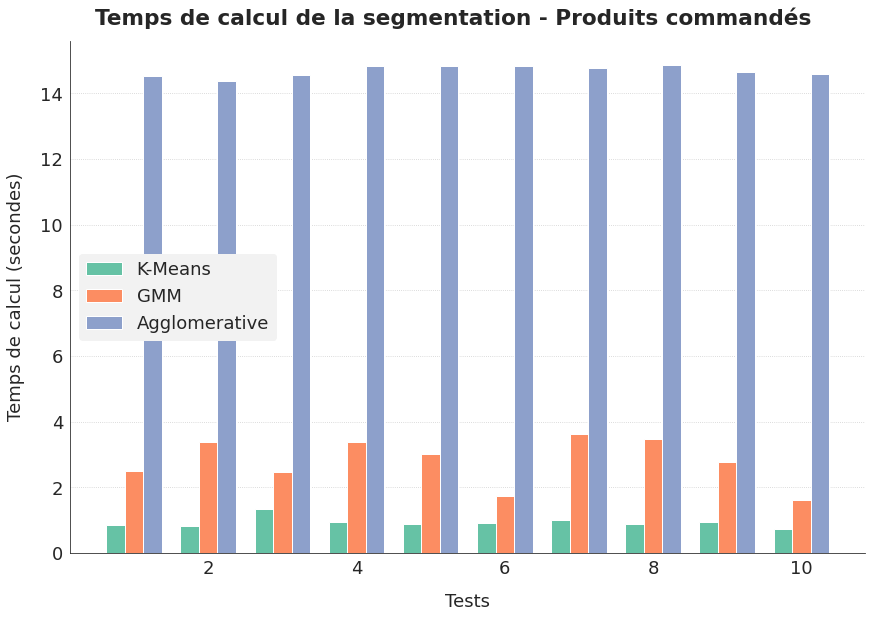

In [ ]:
graph = sfg.MyGraph("Temps de calcul de la segmentation - Produits commandés")
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), products_kmeans_time,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), products_gmm_time,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), products_agglo_time,
               bar_width=0.25, label="Agglomerative", legend=True)
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Temps de calcul (secondes)")
graph.set_legend(loc="center left")
fig, ax = graph.fig, graph.ax

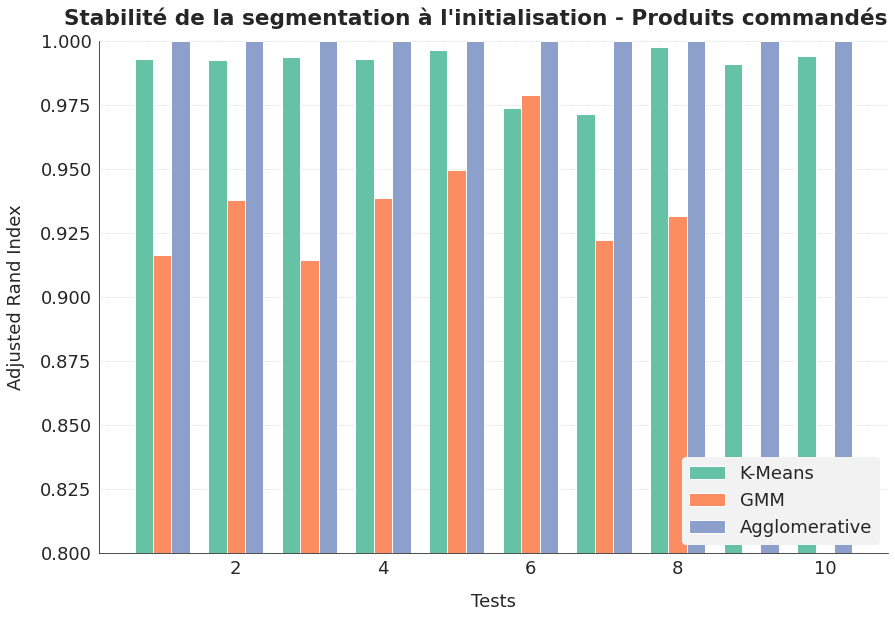

In [ ]:
graph_title = \
    "Stabilité de la segmentation à l'initialisation - Produits commandés"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), products_kmeans_stab,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), products_gmm_stab,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), products_agglo_stab,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Adjusted Rand Index", tick_min=0.8, tick_max=1.0)
graph.set_legend(loc="lower right")
fig, ax = graph.fig, graph.ax

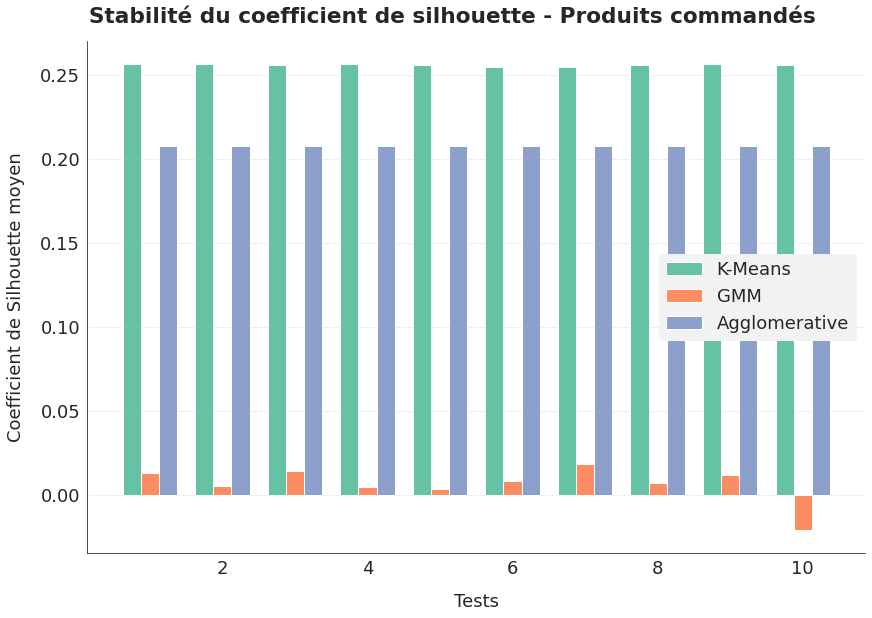

In [ ]:
graph_title = "Stabilité du coefficient de silhouette - Produits commandés"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), products_kmeans_sil,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), products_gmm_sil,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), products_agglo_sil,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Coefficient de Silhouette moyen")
graph.set_legend(loc="center right")
fig, ax = graph.fig, graph.ax


<a id='7_3'></a>

### 7.3. Segmentation sur les caractéristiques des commandes

In [ ]:
orders_scaled = \
    SelectFeatures(orders_features, selected_indices).fit_transform(data)

In [ ]:
n_test_stab = 10
nclust = 7
orders_kmeans_time, orders_kmeans_stab, orders_kmeans_sil = \
    get_stab_index(orders_scaled, n_test_stab, nclust, "KMeans")
orders_gmm_time, orders_gmm_stab, orders_gmm_sil = \
    get_stab_index(orders_scaled, n_test_stab, nclust, "GMM")
orders_agglo_time, orders_agglo_stab, orders_agglo_sil = \
    get_stab_index(orders_scaled, n_test_stab, nclust, "Agglo")

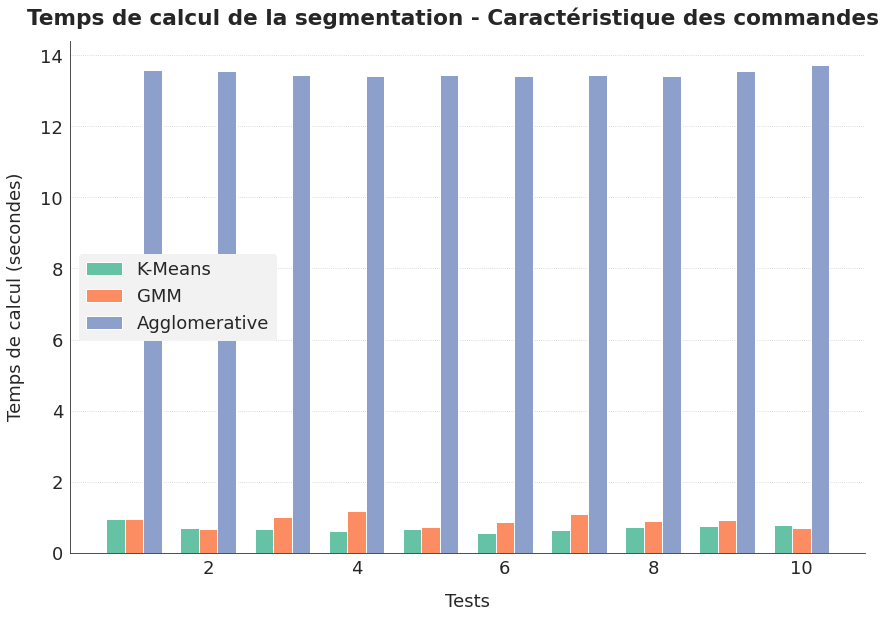

In [ ]:
graph_title = \
    "Temps de calcul de la segmentation - Caractéristique des commandes"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), orders_kmeans_time,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), orders_gmm_time,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), orders_agglo_time,
               bar_width=0.25, label="Agglomerative", legend=True)
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Temps de calcul (secondes)")
graph.set_legend(loc="center left")
fig, ax = graph.fig, graph.ax

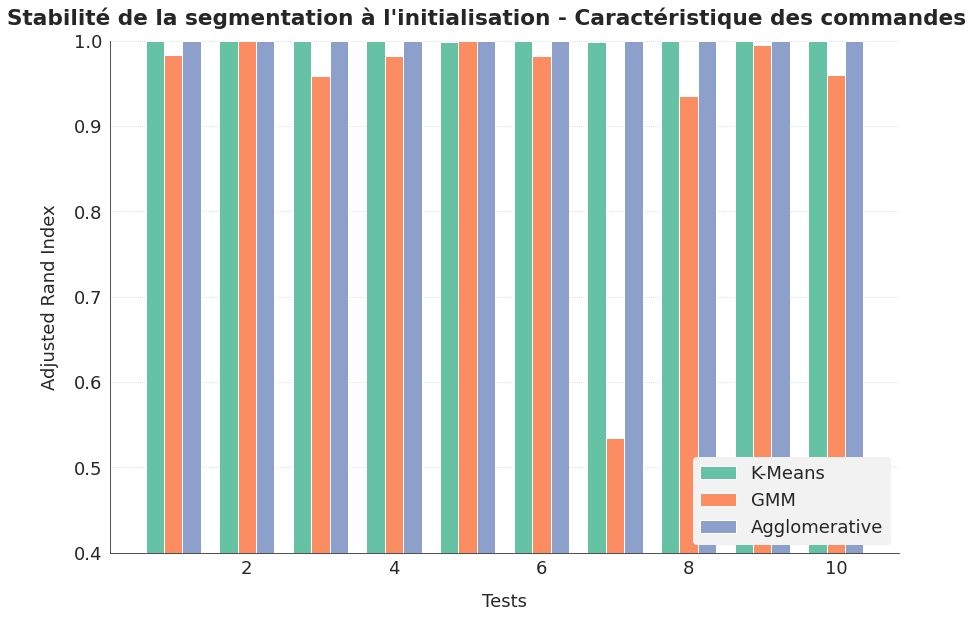

In [ ]:
graph_title = ("Stabilité de la segmentation à l'initialisation - "
               "Caractéristique des commandes")
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), orders_kmeans_stab,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), orders_gmm_stab,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), orders_agglo_stab,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Adjusted Rand Index", tick_min=0.4, tick_max=1.0)
graph.set_legend(loc="lower right")
fig, ax = graph.fig, graph.ax

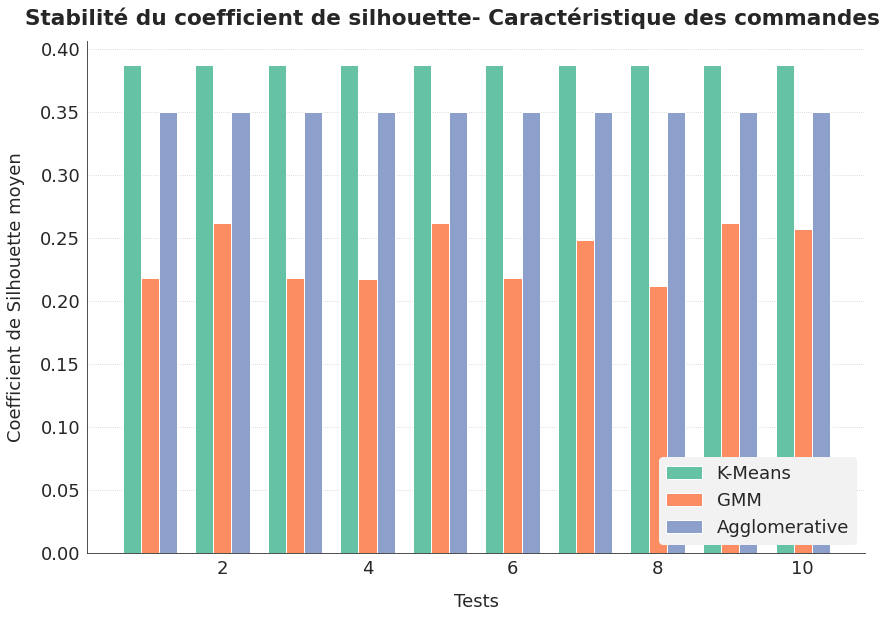

In [ ]:
graph_title = \
    "Stabilité du coefficient de silhouette- Caractéristique des commandes"
graph = sfg.MyGraph(graph_title)
graph.add_barv(np.arange(0.75, n_test_stab + 0.75), orders_kmeans_sil,
               bar_width=0.25, label="K-Means")
graph.add_barv(np.arange(1, n_test_stab + 1), orders_gmm_sil,
               bar_width=0.25, label="GMM")
graph.add_barv(np.arange(1.25, n_test_stab + 1.25), orders_agglo_sil,
               bar_width=0.25, label="Agglomerative")
graph.set_axe_x(label="Tests")
graph.set_axe_y(label="Coefficient de Silhouette moyen")
graph.set_legend(loc="lower right")
fig, ax = graph.fig, graph.ax

<a id='7_4'></a>

### 7.4. Comparaison des résultats sur les différentes segmentations

In [ ]:
df_analyse = pd.DataFrame({"calc_time": np.ravel([satisf_kmeans_time,
                                                 satisf_gmm_time,
                                                 satisf_agglo_time,
                                                 products_kmeans_time,
                                                 products_gmm_time,
                                                 products_agglo_time,
                                                 orders_kmeans_time,
                                                 orders_gmm_time,
                                                 orders_agglo_time]),
                           "ari": np.ravel([satisf_kmeans_stab,
                                           satisf_gmm_stab,
                                           satisf_agglo_stab,
                                           products_kmeans_stab,
                                           products_gmm_stab,
                                           products_agglo_stab,
                                           orders_kmeans_stab,
                                           orders_gmm_stab,
                                           orders_agglo_stab]),
                           "silhouette": np.ravel([satisf_kmeans_sil,
                                                  satisf_gmm_sil,
                                                  satisf_agglo_sil,
                                                  products_kmeans_sil,
                                                  products_gmm_sil,
                                                  products_agglo_sil,
                                                  orders_kmeans_sil,
                                                  orders_gmm_sil,
                                                  orders_agglo_sil]),
                           "method": np.ravel([np.repeat("K-Means", 10),
                                              np.repeat("GMM", 10),
                                              np.repeat("Agglomerative", 10),
                                              np.repeat("K-Means", 10),
                                              np.repeat("GMM", 10),
                                              np.repeat("Agglomerative", 10),
                                              np.repeat("K-Means", 10),
                                              np.repeat("GMM", 10),
                                              np.repeat("Agglomerative", 10)]),
                           "clustering": np.ravel(
                               [np.repeat("Satisfaction", 30),
                                np.repeat("Products", 30),
                                np.repeat("Orders", 30)])})
df_analyse.head()

,calc_time,ari,silhouette,method,clustering
0,1.084101,0.999334,0.351611,K-Means,Satisfaction
1,0.865155,0.999222,0.351608,K-Means,Satisfaction
2,0.783311,0.998526,0.351581,K-Means,Satisfaction
3,0.804210,0.998188,0.351596,K-Means,Satisfaction
4,0.981795,0.998347,0.351573,K-Means,Satisfaction


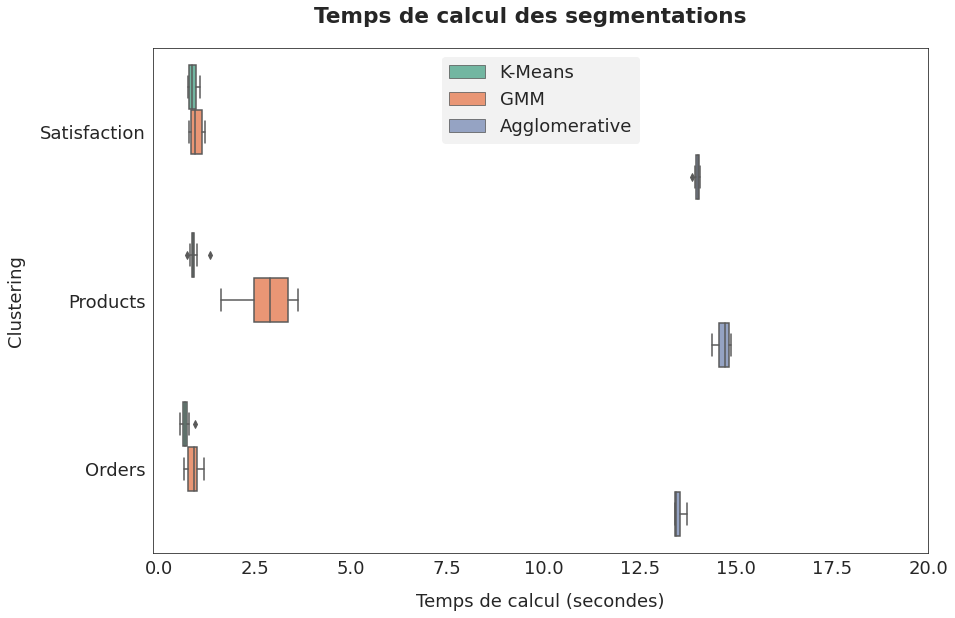

In [ ]:
graph = sfg.MyGraph("Temps de calcul des segmentations")
graph.add_sns_boxplot("calc_time", "clustering", data=df_analyse,
                      hue="method", orient="h")
graph.set_axe_y(label="Clustering")
graph.set_axe_x(label="Temps de calcul (secondes)", tick_max=20)
graph.set_legend(loc="upper center")
fig, ax = graph.fig, graph.ax
plt.show()

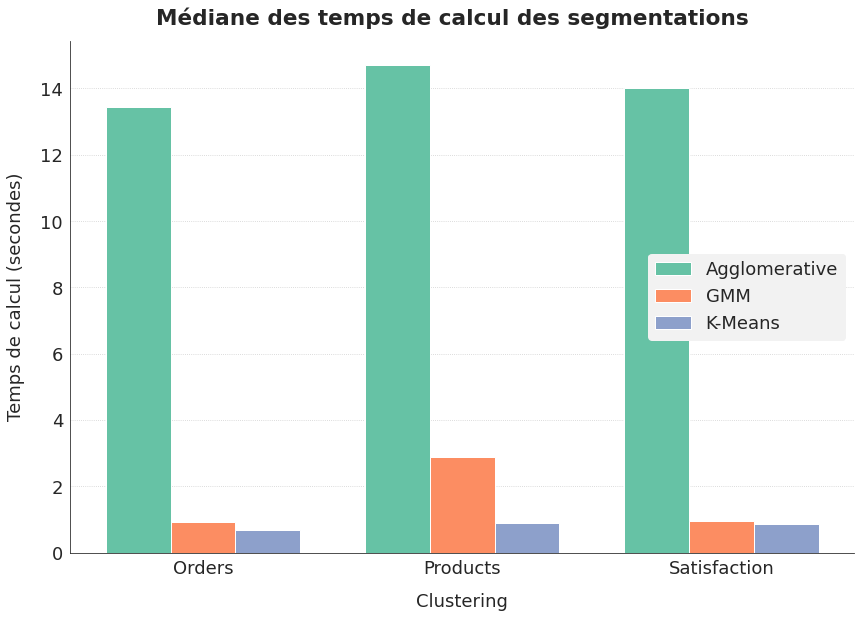

In [ ]:
graph_data = df_analyse\
    .groupby(["method", "clustering"])[["calc_time"]].median()
graph = sfg.MyGraph("Médiane des temps de calcul des segmentations")
idx = -1
for m in graph_data.index.get_level_values("method").unique():
    graph.add_barv(np.arange(3) + idx*0.25, graph_data.loc[m].calc_time,
                   bar_width=0.25, label=m)
    idx += 1
graph.set_axe_x(label="Clustering", tick_min=0, tick_max=2, tick_step=1,
                tick_labels=graph_data.index
                .get_level_values("clustering").unique())
graph.set_axe_y(label="Temps de calcul (secondes)")
graph.set_legend(loc="center right")
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_comparaison01_temps_calcul")
plt.show()

Le K-Means est toujours l'algorithme le plus rapide. La lenteur de calcul est le gros point faible de l'Agglomerative Clustering, qui est toujours l'algorithme le plus lent.  
Le temps de calcul du GMM est sensible au nombre de clusters. Il est juste un peu plus lent que le K-Means lorsqu'il recherche 6 clusters. L'écart grandit lorsqu'il recherche 7 clusters et devient important lors de la recherche de 8 clusters.

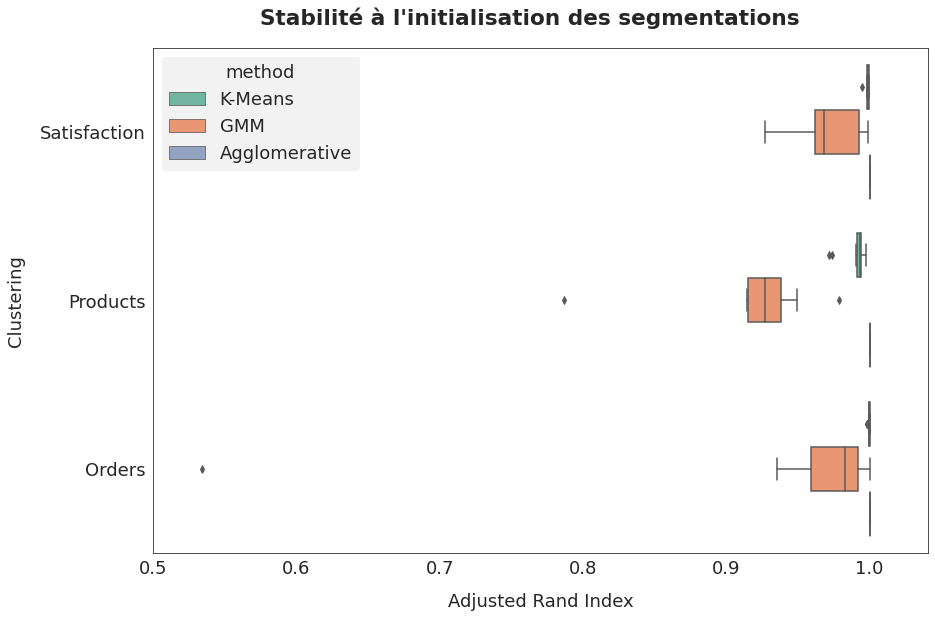

In [ ]:
graph = sfg.MyGraph("Stabilité à l'initialisation des segmentations")
graph.add_sns_boxplot("ari", "clustering", data=df_analyse,
                      hue="method", orient="h")
graph.set_axe_y(label="Clustering")
graph.set_axe_x(label="Adjusted Rand Index", tick_min=0.5)
fig, ax = graph.fig, graph.ax
plt.show()

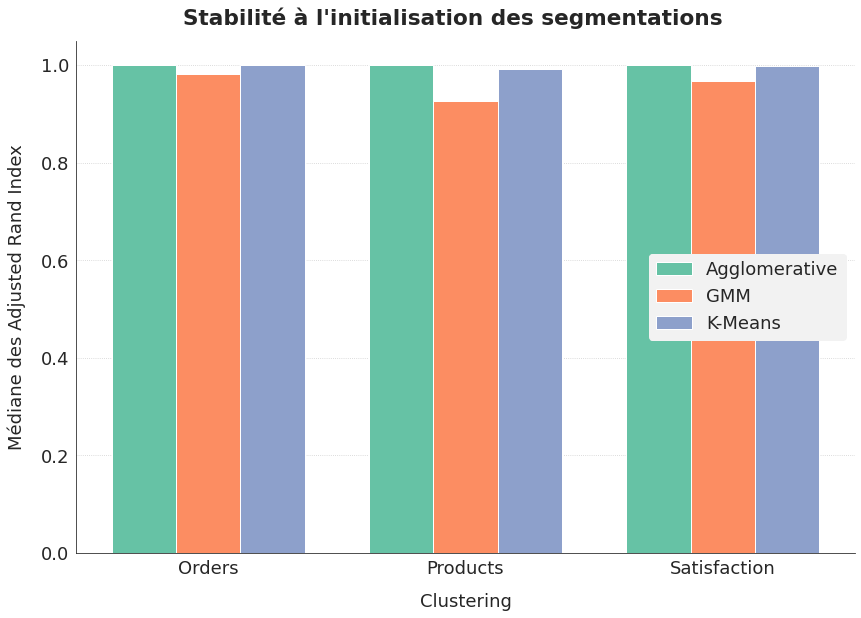

In [ ]:
graph_data = df_analyse\
    .groupby(["method", "clustering"])[["ari"]].median()
graph = sfg.MyGraph("Stabilité à l'initialisation des segmentations")
idx = -1
for m in graph_data.index.get_level_values("method").unique():
    graph.add_barv(np.arange(3) + idx*0.25, graph_data.loc[m].ari,
                   bar_width=0.25, label=m)
    idx += 1
graph.set_axe_x(label="Clustering", tick_min=0, tick_max=2, tick_step=1,
                tick_labels=graph_data.index
                .get_level_values("clustering").unique())
graph.set_axe_y(label="Médiane des Adjusted Rand Index")
graph.set_legend(loc="center right")
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_comparaison02_stabilite_initialisation")
plt.show()

Comme attendu, l'Agglomerative Clustering donne toujours les mêmes groupes. Le K-Means est un peu sensible à l'initialisation, mais conserve toujours des groupes assez semblables, avec un ARI toujours proche de 100%.  
Le GMM est l'algorithme le plus sensible à l'initialisation avec un ARI qui peut descendre jusqu'à 50%.

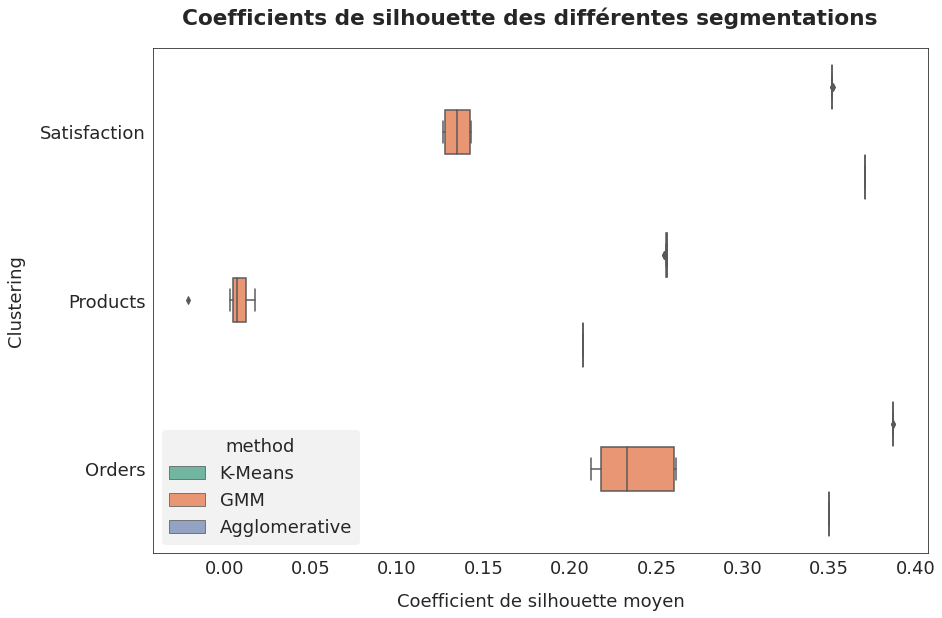

In [ ]:
graph = sfg.MyGraph("Coefficients de silhouette des différentes segmentations")
graph.add_sns_boxplot("silhouette", "clustering", data=df_analyse,
                      hue="method", orient="h")
graph.set_axe_y(label="Clustering")
graph.set_axe_x(label="Coefficient de silhouette moyen")
fig, ax = graph.fig, graph.ax
plt.show()

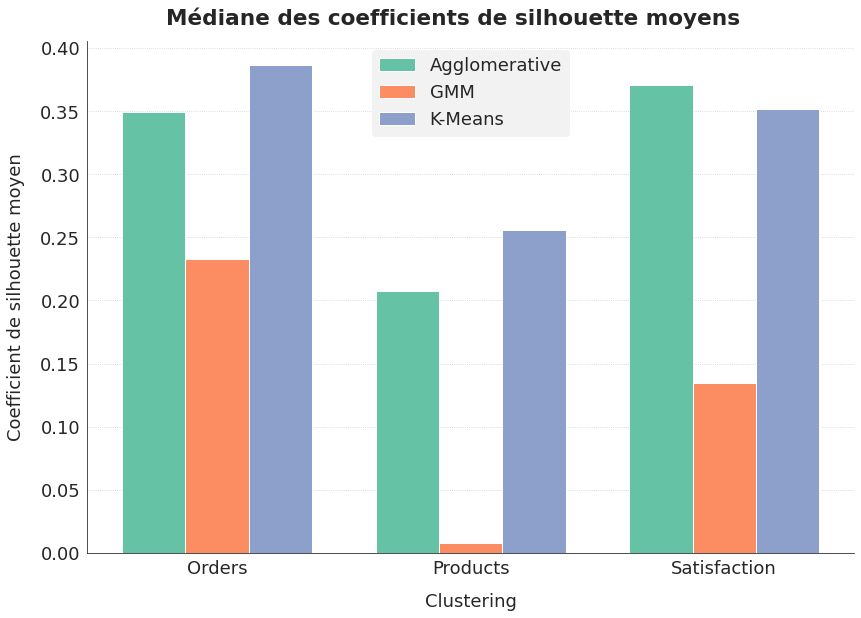

In [ ]:
graph_data = df_analyse\
    .groupby(["method", "clustering"])[["silhouette"]].median()
graph = sfg.MyGraph("Médiane des coefficients de silhouette moyens")
idx = -1
for m in graph_data.index.get_level_values("method").unique():
    graph.add_barv(np.arange(3) + idx*0.25, graph_data.loc[m].silhouette,
                   bar_width=0.25, label=m)
    idx += 1
graph.set_axe_x(label="Clustering", tick_min=0, tick_max=2, tick_step=1,
                tick_labels=graph_data.index
                .get_level_values("clustering").unique())
graph.set_axe_y(label="Coefficient de silhouette moyen")
graph.set_legend(loc="upper center")
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_comparaison03_coef_silhouette")
plt.show()

Les coefficients de silhouette du K-Means et du clustering hiérarchique sont très proches, avec un léger avantage pour le K-Means. Ils sont très stables d'une itération à l'autre.  
Les coefficients de silhouette du GMM sont moins bons, et varient beaucoup plus d'une itération à l'autre.

A la vue de ces résultats, le K-Means est l'algorithme le plus intéressant :
- il obtient le meilleur coefficient de silhouette moyen pour deux des 3 segmentations ;
- il est le plus rapide des 3 algorithmes ;
- il est très stable à l'initialisation.

Les segmentations sur la satisfaction client et les caractéristiques des commandes sont les plus efficaces et les plus pertinentes d'un point de vue interprétation métier.

Je me concentre donc sur le K-Means, appliqué à la satisfaction client et aux caractéristiques des commandes.

---
<a id='8_0'></a>

## <font color=blue>8. Evaluation de la stabilité dans le temps</font>

In [ ]:
pd.to_datetime(orders.order_purchase_timestamp).min()

Timestamp('2016-09-04 21:15:19')

In [ ]:
pd.to_datetime(orders.order_purchase_timestamp).max()

Timestamp('2018-10-17 17:30:18')

Il y a 25 mois de données. J'effectue une première segmentation avec les commandes des 12 premiers mois. Ensuite, j'évalue la stabilité de la segmentation sur les clients des 12 premiers mois à mesure que j'ajoute les nouvelles commandes, mois par mois.  
Pour ce faire, je recalcule une segmentation tous les mois, puis j'évalue la stabilité à l'aide de l'Adjusted Rand Index.

In [ ]:
prep_data = PrepareData()
satisfaction_algo = KMeans(n_clusters=6, random_state=42)
# products_algo = KMeans(n_clusters=8, random_state=42)
orders_algo = KMeans(n_clusters=7, random_state=42)

In [ ]:
prep_data.fit(customers, sellers, geolocation,
              orders, order_items, order_payments, order_reviews,
              products, product_category, grouped_categories,
              number_of_months=12)
satisf_base_clusters = prep_data.get_clusters(satisfaction_features,
                                              satisfaction_algo)
# products_base_clusters = prep_data.get_clusters(products_features,
#                                                products_algo)
orders_base_clusters = prep_data.get_clusters(orders_features,
                                              orders_algo)
base_index = satisf_base_clusters.index

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [ ]:
satisf_stab_index = []
# products_stab_index = []
orders_stab_index = []
for nb_months in np.arange(13, 26):
    prep_data.fit(customers, sellers, geolocation,
                  orders, order_items, order_payments, order_reviews,
                  products, product_category, grouped_categories,
                  number_of_months=nb_months)
    satisf_clusters = prep_data.get_clusters(satisfaction_features,
                                             satisfaction_algo)
    ari = adjusted_rand_score(satisf_base_clusters.cluster,
                              satisf_clusters.loc[base_index].cluster)
    satisf_stab_index.append(ari)
    # products_clusters = prep_data.get_clusters(products_features,
    #                                           products_algo)
    # ari = adjusted_rand_score(products_base_clusters.cluster,
    #                          products_clusters.loc[base_index].cluster)
    # products_stab_index.append(ari)
    orders_clusters = prep_data.get_clusters(orders_features,
                                             orders_algo)
    ari = adjusted_rand_score(orders_base_clusters.cluster,
                              orders_clusters.loc[base_index].cluster)
    orders_stab_index.append(ari)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:211: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/l

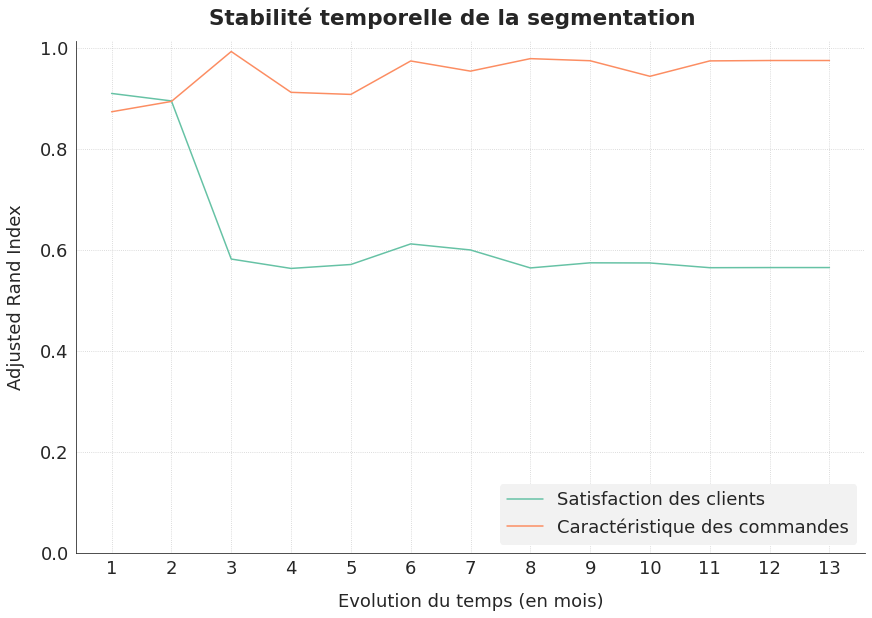

In [ ]:
graph = sfg.MyGraph("Stabilité temporelle de la segmentation")
graph.add_plot(np.arange(1, 14), satisf_stab_index,
               label="Satisfaction des clients")
graph.add_plot(np.arange(1, 14), orders_stab_index,
               label="Caractéristique des commandes",
               with_grid="both", grid_style=":")
graph.set_axe_x(label="Evolution du temps (en mois)",
                tick_min=1, tick_max=13, tick_step=1,
                tick_labels_format=":.0f")
graph.set_axe_y(label="Adjusted Rand Index", tick_min=0)
graph.set_legend(loc="lower right")
fig, ax = graph.fig, graph.ax
save_fig("ML04_part2_comparaison04_stabilite_temps")
plt.show()

La segmentation basée sur les caractéristiques des commandes est très stable dans le temps.  
Celle basée sur la satisfaction des clients change assez sensiblement après 3 mois. Il faut donc la ré-actualiser tous les trimestres.